# make_grid:
## Make high res grid, choose either GEBCO_v2023 or bedmachine v3
### Version id:
### bedmachine v3
### completely redoing interpolating and smoothing to reduce halo-ing/fringing high rx1 in cavities

In [1]:

run ='amery'
vers='v2km_v10'
plotting = False

import numpy as np 
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import os
import sys
import xarray as xr
import scipy.io as sio
from scipy.interpolate import griddata
import datetime
import cmocean
# import h5py
import bathy_smoother
# import pyresample

#proj_dir = os.path.join(os.pardir,os.pardir)
proj_dir = os.path.abspath(os.path.join(os.getcwd(), os.pardir))
data_dir = os.path.join(proj_dir,'data')
src_dir = os.path.join(proj_dir,'src')

sys.path.append(src_dir)

from ext.tools.inverse_polar_stereo import inverse_polar_stereo
from ext.tools.cartesian_grid_2d import haversine
from ext.tools.NDinterp import NDinterp
from ext.tools.smoothing_PlusMinus_rx0 import smoothing_PlusMinus_rx0
from ext.tools.uvp_masks import uvp_masks



out_path = os.path.join(data_dir,'proc',run+'_'+vers+'_grd.nc')


# define coordinate transforms
## convert convert polarstereo to lat/lon and vice versa.
from pyproj import Transformer
from pyproj import CRS
ps_to_ll = Transformer.from_crs( "EPSG:3031","EPSG:4326")
ll_to_ps = Transformer.from_crs( "EPSG:4326","EPSG:3031")

# load my functions for calculating rx0,rx1 and adjusting the grid
# from ext.tools.calc_z import calc_z as calc_z_old
from functions import GridStiffness
from functions.GridAdjustments import adjustWCT,adjustMask,smoothRegion,minWCTRegion

# Set model vertical coordinate settings

N=31
Vtransform=2
Vstretching=4
theta_s=1
theta_b=4
Tcline=250
hc=Tcline # if Vtransform==2, hc=Tcline


In [2]:
mr = 2
grid_xLims= (1500,3300) #km
grid_yLims= (0,1500) #km
#establish the grid with grid point distances of mr/2 in km
#we need double resolution to cover all of the staggered grid points (we subset to rho, psi, u, v points later)
#we need an extra line of u and v points at first to calculate all dx and dy on rho points
x,y = np.meshgrid(np.arange(grid_xLims[0],grid_xLims[1]+mr/2,mr/2),np.arange(grid_yLims[0],grid_yLims[1]+mr/2,mr/2))
x_rho = x[1::2,1::2]
y_rho = y[1::2,1::2]

In [3]:
#load GEBCO 2023 geometry

gebco_2023_bed = os.path.join(data_dir,'raw','GEBCO_2023','GEBCO_2023_sub_ice_topo.nc')

g23 = xr.load_dataset(gebco_2023_bed)

g23 = g23.sel(lon=slice(30,110),lat=slice(-85,-55))
g23

long,latg = np.meshgrid(g23.lon,g23.lat)
g23 = g23.assign_coords({"longitude": (("lat", "lon"), long), "latitude": (("lat", "lon"), latg)})

In [4]:
#load BM3 geometry
bedmachine_v3_path = os.path.join(data_dir,'raw','BedMachineAntarctica-v3','BedMachineAntarctica-v3.nc')

bm3_raw = xr.load_dataset(bedmachine_v3_path)

#subset bedmachine dataset
bm3=bm3_raw.sel(x=slice(1e6,3.3e6)).sel(y=slice(1.5e6,0)) # note reversed y coord

# make XX and YY coordinates
X,Y = np.meshgrid(bm3.x,bm3.y)
bm3 = bm3.assign_coords({"X": (("y", "x"), X), "Y": (("y", "x"), Y)})

bm3_lat,bm3_lon = ps_to_ll.transform(bm3.X,bm3.Y)
bm3 = bm3.assign_coords({"lon": (("y", "x"), bm3_lon), "lat": (("y", "x"), bm3_lat)})

# make 'draft' abd 'bathy' variables
bm3["draft"]=-(bm3.thickness-bm3.surface) #draft is negative
bm3["bathy"]=-bm3.bed # bathy is postive


In [5]:
whichBathy='bedmachine' #options: 'bedmachine' or 'gebco'
if whichBathy =='gebco':
    # make new dataset with all variables on same grid
    geom = bm3.draft.to_dataset(name='draft')

    # interp GEBCO2023 bathy to this grid.
    g23_bathy_i = -griddata((g23['longitude'].values.flatten(),g23['latitude'].values.flatten()),g23['elevation'].values.flatten(),(geom.lon.values,geom.lat.values),'nearest').astype(np.float32)
    geom['bathy']=(['y','x'],g23_bathy_i)


    # make masks
    geom['mask_full']=bm3.mask
    geom["mask_ice"]=np.isfinite(geom.mask_full.where(geom.mask_full==3,np.NaN))
    geom["mask_ocean"]=np.isfinite(geom.mask_full.where((geom.mask_full==0)|(geom.mask_full==3),np.NaN))
elif whichBathy =='bedmachine':
    
    geom = bm3
    # make masks
    geom['mask_full']=bm3.mask
    geom["mask_ice"]=np.isfinite(geom.mask_full.where(geom.mask_full==3,np.NaN))
    geom["mask_ocean"]=np.isfinite(geom.mask_full.where((geom.mask_full==0)|(geom.mask_full==3),np.NaN))
    


<Figure size 640x480 with 0 Axes>

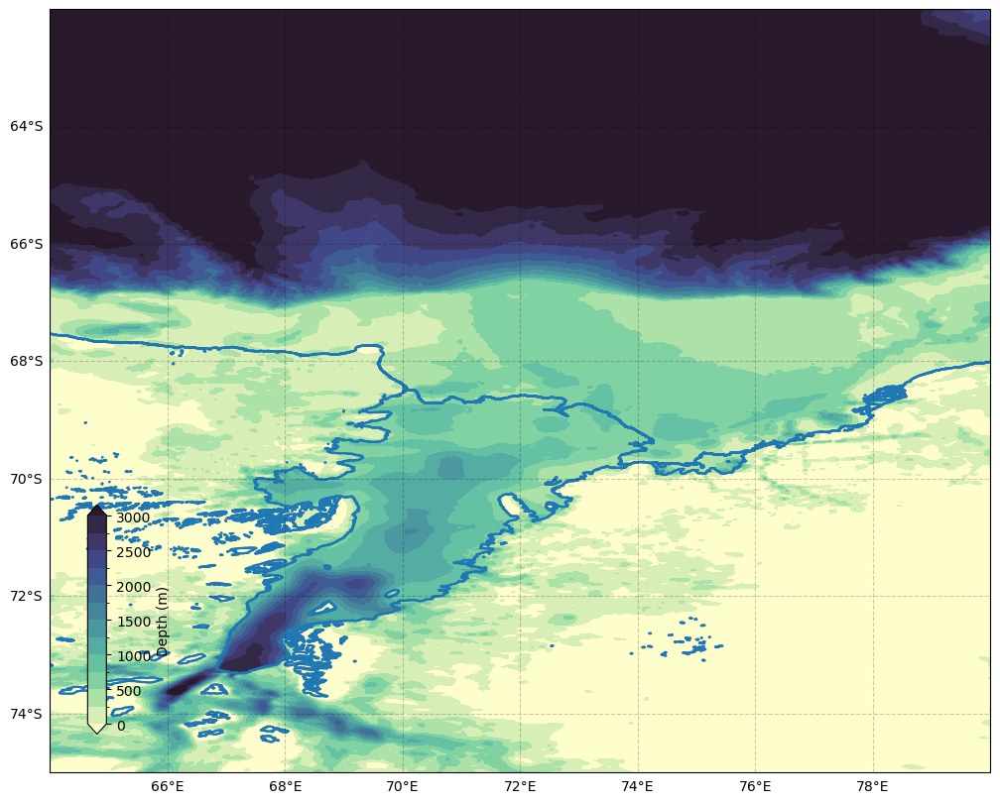

In [6]:
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes

# Create a plot of the bathymetry data using Cartopy
gs = gridspec.GridSpec(nrows=1,ncols=1,wspace=0.05, hspace=0.05)
plt.cla()
plt.clf()
fig = plt.figure(figsize=[15,10])
ax = None

#make an axis and decorate the cartopy stuff
ax = fig.add_subplot(gs[0,0], projection=ccrs.PlateCarree())
gl = ax.gridlines(draw_labels=True,color='black', alpha=0.2, linestyle='--')
gl.right_labels = False
gl.top_labels = False
ax.set_extent([64, 80, -75, -62])

#add data
im = (geom['bathy']).plot.contourf(x='lon',y='lat',cmap='cmo.deep',levels=np.array([*np.arange(00,3250,250)]),add_colorbar=False)
co=plt.contour(bm3.lon,bm3.lat,bm3.mask,colors='C0')

#add colourbar
cax = inset_axes(ax,
                width="2%",  # width = 10% of parent_bbox width
                height="30%",  # height : 50%
                loc='lower left',
                bbox_to_anchor=(.04,.05, 1, 1),
                bbox_transform=ax.transAxes,
                borderpad=0,
                )
cbar = fig.colorbar(im, cax=cax) 
cbar.set_label('Depth (m)')
ax = plt.gca()

plt.show()


<Figure size 640x480 with 0 Axes>

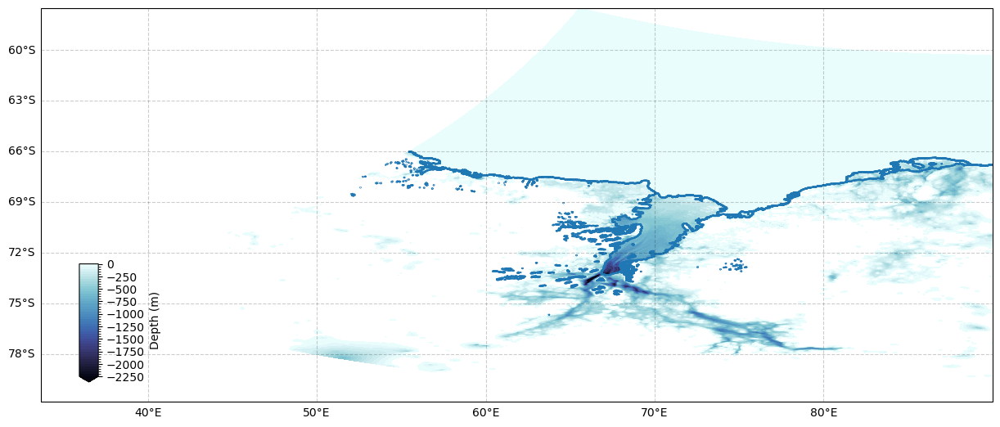

In [71]:
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes

# Create a plot of the bathymetry data using Cartopy
gs = gridspec.GridSpec(nrows=1,ncols=1,wspace=0.05, hspace=0.05)
plt.cla()
plt.clf()
fig = plt.figure(figsize=[15,10])
ax = None

#make an axis and decorate the cartopy stuff
ax = fig.add_subplot(gs[0,0], projection=ccrs.PlateCarree())
gl = ax.gridlines(draw_labels=True,color='black', alpha=0.2, linestyle='--')
gl.right_labels = False
gl.top_labels = False
ax.set_extent([64, 80, -75, -62])

#add data
im = (geom.draft).plot.contourf(x='lon',y='lat',cmap='cmo.ice',levels=np.array([*np.arange(-2250,50,50)]),add_colorbar=False,extend='min')
co=plt.contour(bm3.lon,bm3.lat,bm3.mask,colors='C0')

#add colourbar
cax = inset_axes(ax,
                width="2%",  # width = 10% of parent_bbox width
                height="30%",  # height : 50%
                loc='lower left',
                bbox_to_anchor=(.04,.05, 1, 1),
                bbox_transform=ax.transAxes,
                borderpad=0,
                )
cbar = fig.colorbar(im, cax=cax) 
cbar.set_label('Depth (m)')
ax = plt.gca()

plt.show()


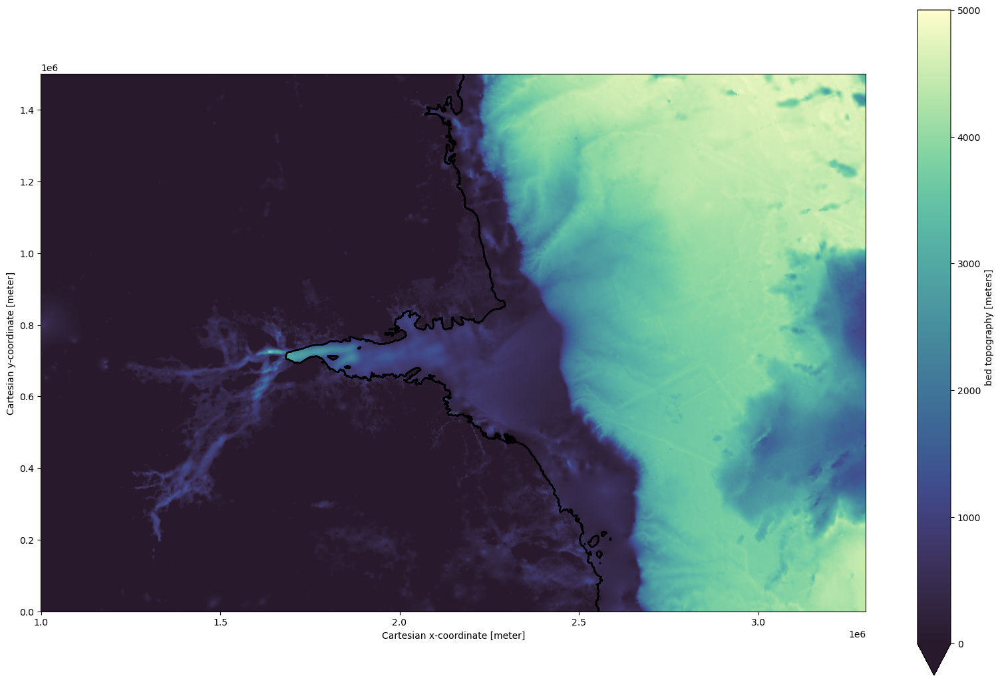

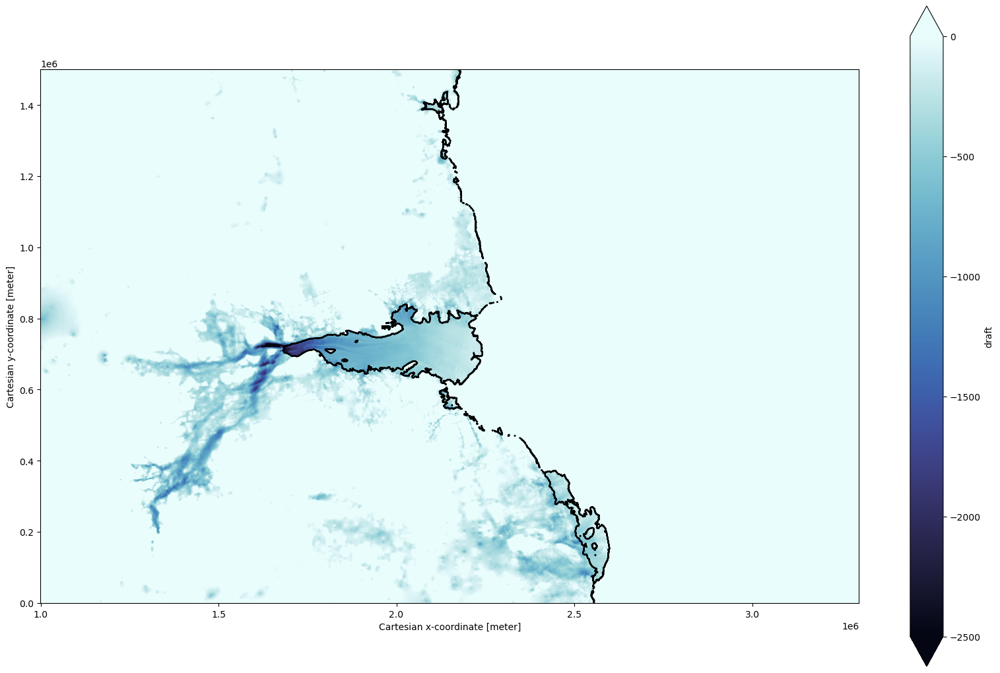

In [8]:
# plot of chosen subset
fig,ax=plt.subplots(figsize=(20,13))
geom.bathy.plot(vmin=000,vmax=5000,cmap='cmo.deep_r')
geom.mask_ocean.plot.contour(colors='k')
ax.set_aspect('equal','box')

plt.show()
fig,ax=plt.subplots(figsize=(20,13))
geom.draft.plot(vmin=-2500,vmax=0,cmap='cmo.ice')
geom.mask_ice.plot.contour(colors='k')
ax.set_aspect('equal','box')

In [9]:
#load south polar stereographic projection to convert from grid point distance in m to lat/lon and back

#get lat/lon coordinates at all grid points by shifting the grid to the lower left corner of the map
lat,lon = inverse_polar_stereo(x,y,0,0,-71.0)

#calculate curvilinear coordinate distances at rho points
dx = haversine(lon[1::2,0:-2:2],lat[1::2,0:-2:2],lon[1::2,2::2],lat[1::2,2::2])
dy = haversine(lon[0:-2:2,1::2],lat[0:-2:2,1::2],lon[2::2,1::2],lat[2::2,1::2])


#calculate curvilinear coordinate metrices
pm = 1.0/dx
pn = 1.0/dy
 
dndx = np.empty_like(pm)
dmde = np.empty_like(pn)

dndx[:,1:-1] = 0.5*(pn[:,2:] - pn[:,:-2])
dmde[1:-1,:] = 0.5*(pm[2:,:] - pm[:-2,:])

dndx[:,0]  = 2*dndx[:,1]  - dndx[:,2]
dndx[:,-1] = 2*dndx[:,-2] - dndx[:,-3]
dmde[0,:]  = 2*dmde[1,:]  - dmde[2,:]
dmde[-1,:] = 2*dmde[-2,:] - dmde[-3,:]

#subset lat and lon at rho, psi, u and v points
lon_rho = lon[1::2,1::2]
lat_rho = lat[1::2,1::2]

lon_psi = lon[2:-1:2,2:-1:2]
lat_psi = lat[2:-1:2,2:-1:2]

lon_u = lon[1::2,2:-1:2]
lat_u = lat[1::2,2:-1:2]

lon_v = lon[2:-1:2,1::2]
lat_v = lat[2:-1:2,1::2]

In [10]:
lat_s = geom.lat.values.flatten()
lon_s = geom.lon.values.flatten()

In [11]:
# interpolate from the geometry grid to the new roms grid

from scipy.interpolate import griddata

def grid_data(data):
    return griddata((lon_s,lat_s),data,(lon_rho,lat_rho),'nearest')

roms_tmp = {}
for key in ['bathy','draft','mask_ice','mask_ocean']:
    roms_tmp[key] = grid_data(geom[key].values.flatten())
    print('interpolated',key)

interpolated bathy
interpolated draft
interpolated mask_ice
interpolated mask_ocean


In [12]:
if plotting:
    plt.close()
    for key,data in roms_tmp.items():
        fig,ax = plt.subplots(figsize=(15,10))
        if key=='draft':
            plot = ax.pcolormesh(data)        
        else:
            plot = ax.pcolormesh(data)
        ax.set_title(key)
        plt.colorbar(plot,ax=ax)
        ax.set_aspect('equal')
        plt.show()

/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:80: RuntimeWarning: divide by zero encountered in divide
  hx = abs(h[:,1:] - h[:,:-1]) / (h[:,1:] + h[:,:-1])
/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:81: RuntimeWarning: divide by zero encountered in divide
  hy = abs(h[1:,:] - h[:-1,:]) / (h[1:,:] + h[:-1,:])
/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:83: RuntimeWarning: invalid value encountered in multiply
  hx = hx * umask
/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:84: RuntimeWarning: invalid value encountered in multiply
  hy = hy * vmask


  
Minimum r-value =  nan
Maximum r-value =  nan
Mean    r-value =  nan
Median  r-value =  nan


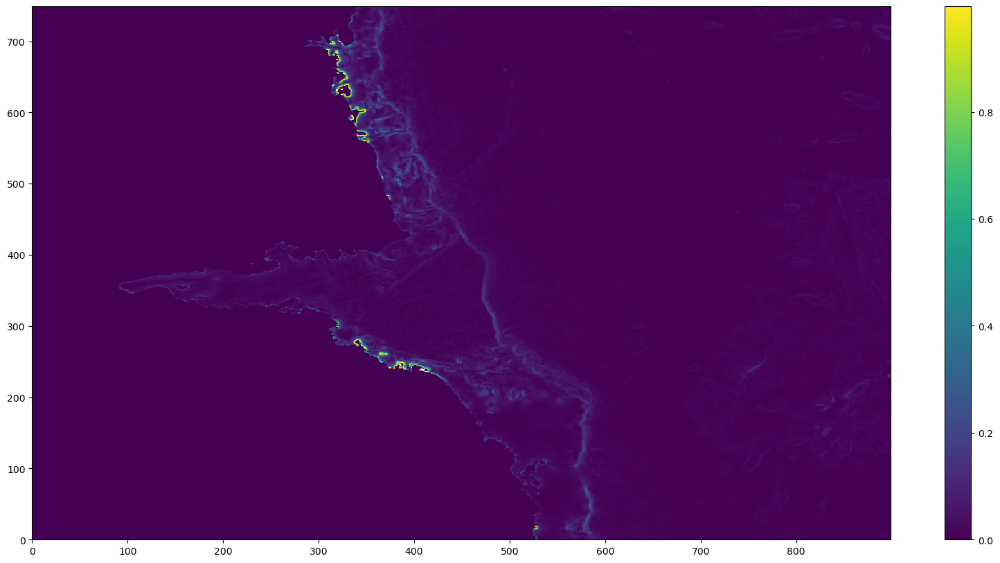

/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:141: RuntimeWarning: divide by zero encountered in divide
  zx[k,:] = abs((z_w[k,1:,:] - z_w[k,:-1,:] + z_w[k-1,1:,:] - z_w[k-1,:-1,:]) /
/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:141: RuntimeWarning: invalid value encountered in divide
  zx[k,:] = abs((z_w[k,1:,:] - z_w[k,:-1,:] + z_w[k-1,1:,:] - z_w[k-1,:-1,:]) /
/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:143: RuntimeWarning: divide by zero encountered in divide
  zy[k,:] = abs((z_w[k,:,1:] - z_w[k,:,:-1] + z_w[k-1,:,1:] - z_w[k-1,:,:-1]) /
/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:143: RuntimeWarning: invalid value encountered in divide
  zy[k,:] = abs((z_w[k,:,1:] - z_w[k,:,:-1] + z_w[k-1,:,1:] - z_w[k-1,:,:-1]) /
/home/woden/Documents/amery-hires-setup/src/functions/GridStiffness.py:145: RuntimeWarning: invalid value encountered in multiply
  zx[k,:] = zx[k,:] * umask
/home/wo

  
Minimum r-value =  nan
Maximum r-value =  nan
Mean    r-value =  nan
Median  r-value =  nan


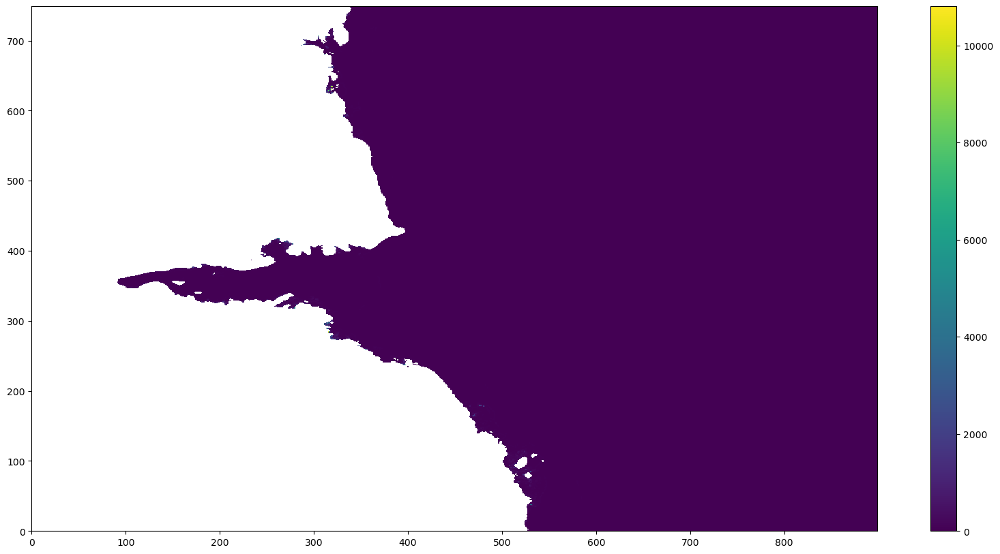

In [13]:


z_rho_pre,z_w_pre,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,roms_tmp['bathy'],roms_tmp['draft'])


fig = plt.figure(figsize=(20,10))
grd_rx0_pre=GridStiffness.rx0(roms_tmp['bathy'],roms_tmp['mask_ocean'])
plt.pcolormesh(grd_rx0_pre)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,10))
grd_rx1_pre=GridStiffness.rx1(z_w_pre,roms_tmp['mask_ocean'])
plt.pcolormesh(grd_rx1_pre)
plt.colorbar()
plt.show()

initial cavity volume
26302758149853.53 m3
26.30275814985353 x10^12 m3


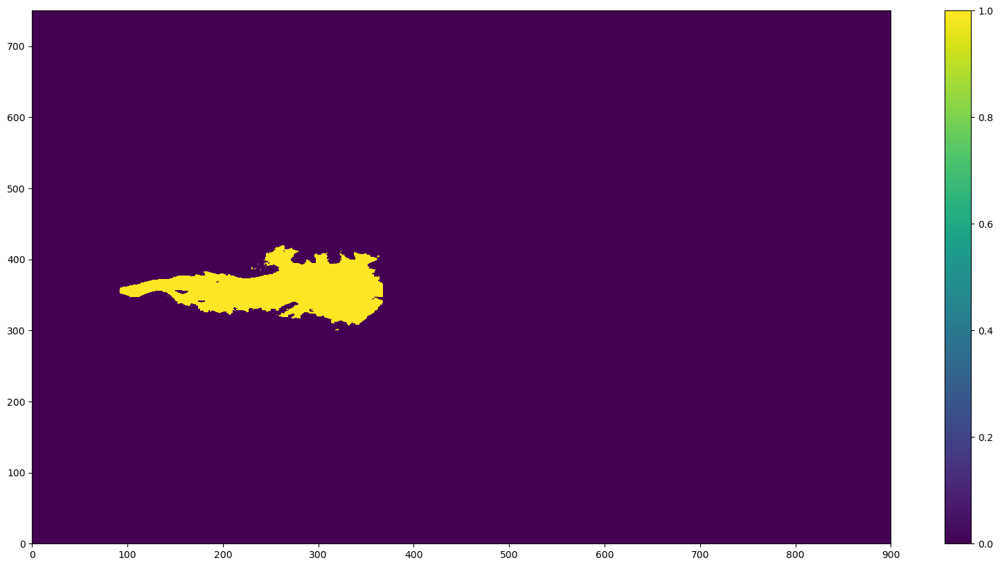

In [14]:
# make amery mask for calculating cavity volume
rough_mask = np.zeros(roms_tmp['draft'].shape)
rough_mask[300:440,0:368]=1

mask_amery = (roms_tmp['draft']<0) & (roms_tmp['mask_ocean']==1) & (rough_mask==1)

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(mask_amery)
plt.colorbar()

print('initial cavity volume')
print(np.sum(mask_amery*(roms_tmp['draft']+roms_tmp['bathy'])*dx*dy),'m3')
print(np.sum(mask_amery*(roms_tmp['draft']+roms_tmp['bathy'])*dx*dy)/1e12,'x10^12 m3')

initial_volume = np.sum(mask_amery*(roms_tmp['draft']+roms_tmp['bathy'])*dx*dy)


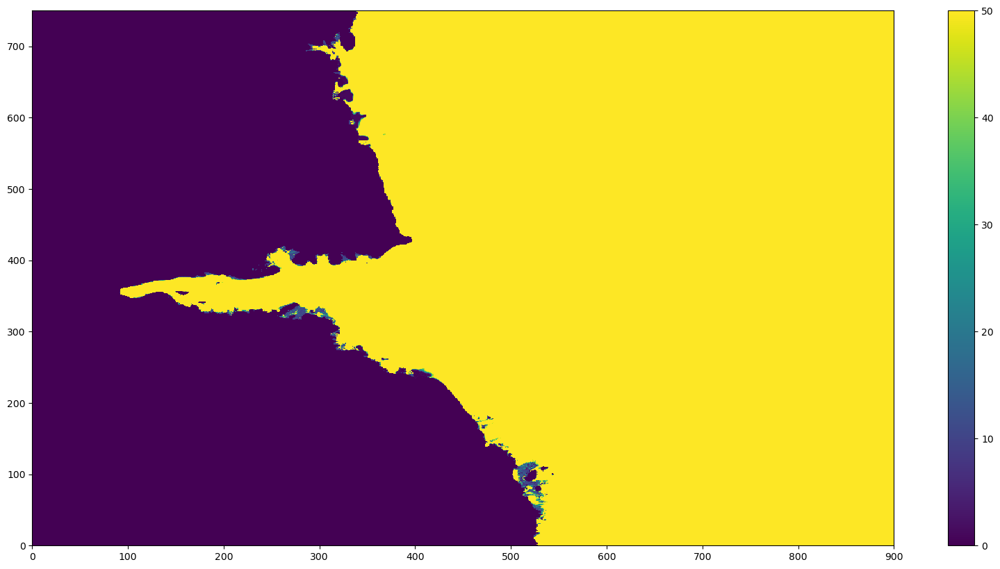

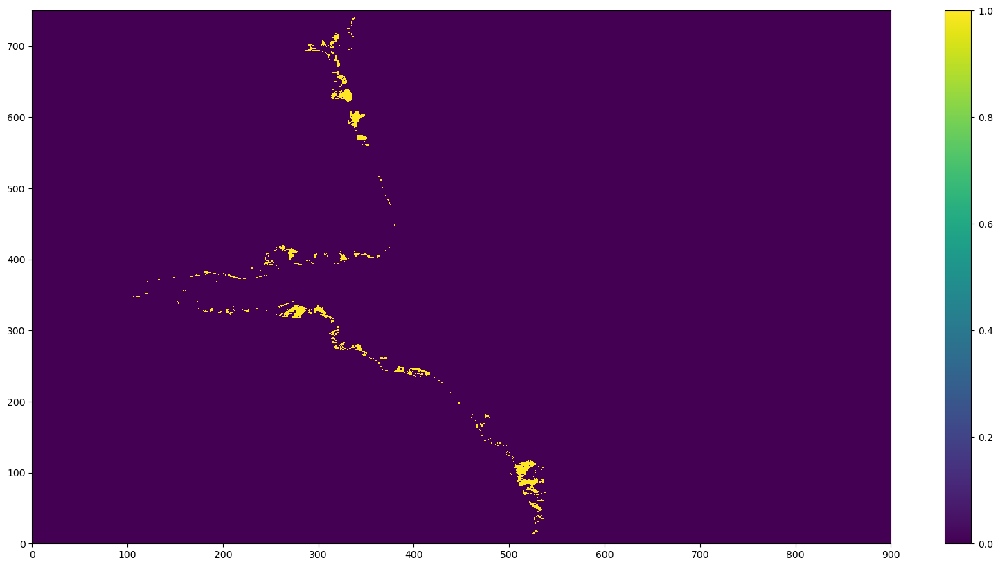

In [15]:
# First need to check for any badly masked points - before any smoothing happens
Thresh = 25


fig = plt.figure(figsize=(20,10))
thin_WCT = (roms_tmp['bathy']+roms_tmp['draft'])*roms_tmp['mask_ocean']
plt.pcolormesh(thin_WCT,vmin=0,vmax=50)
plt.colorbar()

fig = plt.figure(figsize=(20,10))
thin_WCT_mask = (thin_WCT<Thresh) & (roms_tmp['mask_ocean']==1)
plt.pcolormesh(thin_WCT_mask)
plt.colorbar()


1980.9731
-1965.1486
True
15.824585
964.76196
-945.1306
True
19.631348


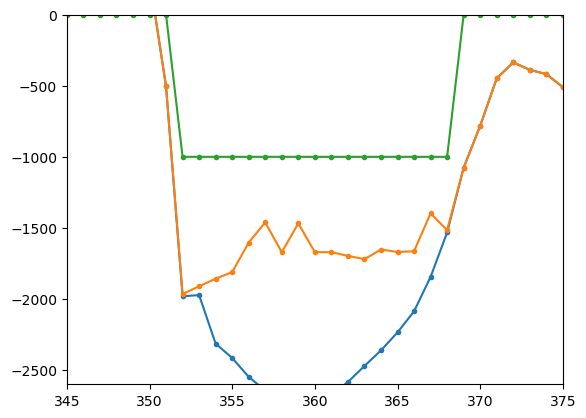

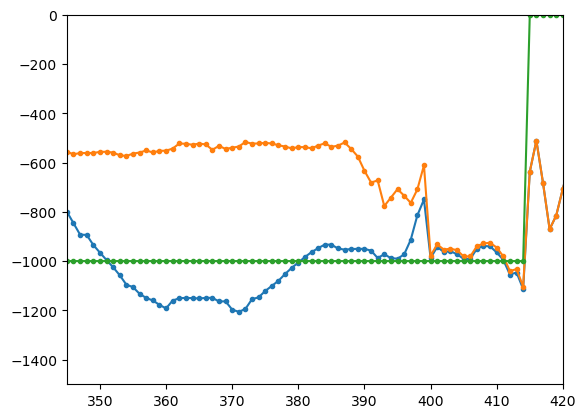

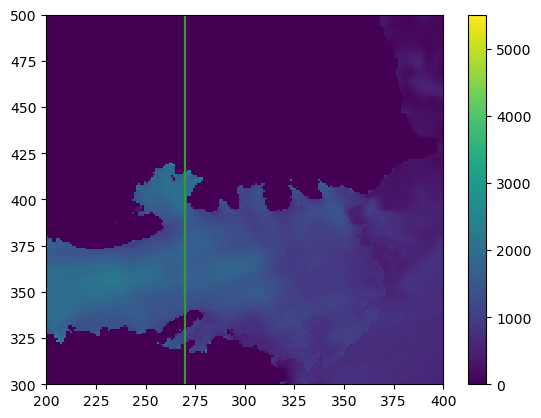

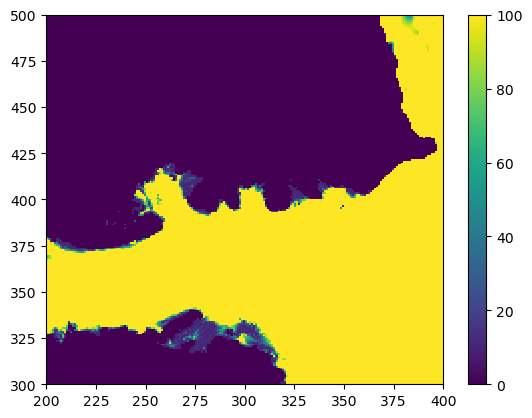

In [16]:
plt.figure()
plot_where=120
plt.plot(-roms_tmp['bathy'][:,plot_where],'.-')
plt.plot(roms_tmp['draft'][:,plot_where],'.-')
plt.plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
plt.axis((345,375,-2600,0))
print(roms_tmp['bathy'][352,plot_where])
print(roms_tmp['draft'][352,plot_where])
print(roms_tmp['mask_ocean'][352,plot_where])
print((roms_tmp['bathy'][352,plot_where]+roms_tmp['draft'][352,plot_where])*roms_tmp['mask_ocean'][352,plot_where])

plt.figure()
plot_where=270
plt.plot(-roms_tmp['bathy'][:,plot_where],'.-')
plt.plot(roms_tmp['draft'][:,plot_where],'.-')
plt.plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
plt.axis((345,420,-1500,0))

print(roms_tmp['bathy'][410,plot_where])
print(roms_tmp['draft'][410,plot_where])
print(roms_tmp['mask_ocean'][410,plot_where])
print((roms_tmp['bathy'][410,plot_where]+roms_tmp['draft'][410,plot_where])*roms_tmp['mask_ocean'][410,plot_where])

plt.show()
plt.figure()
plt.pcolormesh((roms_tmp['bathy']-roms_tmp['draft'])*roms_tmp['mask_ocean'])
plt.axvline(plot_where,color='C1')
plot_where=270
plt.axvline(plot_where,color='C2')

plt.axis((200,400,300,500))
plt.colorbar()

plt.show()
plt.figure()
plot_where=270
plt.pcolormesh((roms_tmp['bathy']+roms_tmp['draft'])*roms_tmp['mask_ocean'],vmin=0,vmax=100)
plt.axis((200,400,300,500))
plt.colorbar()
# plt.pcolormesh()

In [17]:
# do checks
print('min/max zice is',roms_tmp['draft'].min(),'/',roms_tmp['draft'].max())
print('min/max h is',roms_tmp['bathy'].min(),'/',roms_tmp['bathy'].max())
print('min/max wct is',(roms_tmp['draft']+roms_tmp['bathy']).min(),'/',(roms_tmp['draft']+roms_tmp['bathy']).max())

min/max zice is -3799.7085 / 3080.7537
min/max h is -3080.7537 / 4838.785
min/max wct is 0.0 / 4838.785


First round of smoothing
make masks
remove mountains etc
deepen ice until it is at least min_depth
begin smoothing
smooth wct
Old Max Roughness value is:  0.9984208345413208


DeltaBathymetry =  -40746.5
New Max Roughness value is:  0.16812510788440704
now push bed down by new smoothed wct
now, smooth bed
Old Max Roughness value is:  0.8777989745140076


DeltaBathymetry =  -223054.0
New Max Roughness value is:  0.12406572699546814


(345.0, 375.0, -2600.0, 0.0)

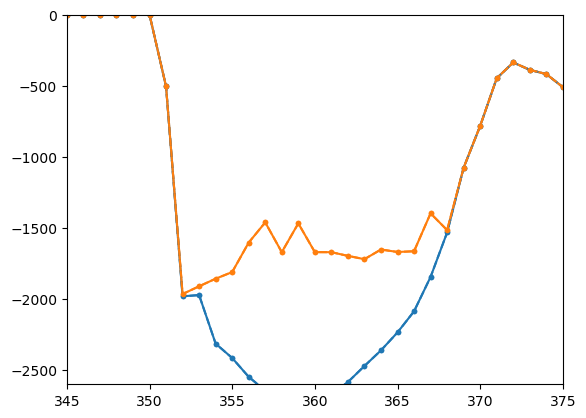

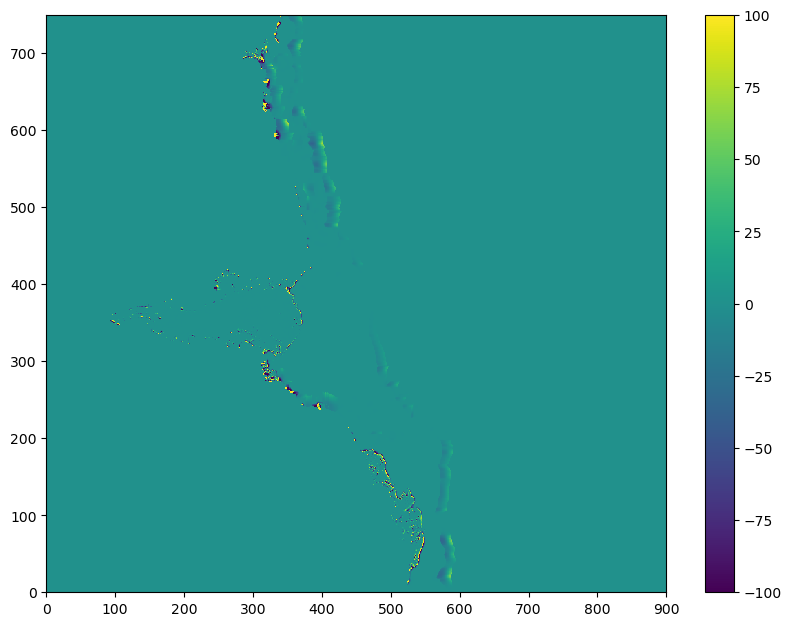

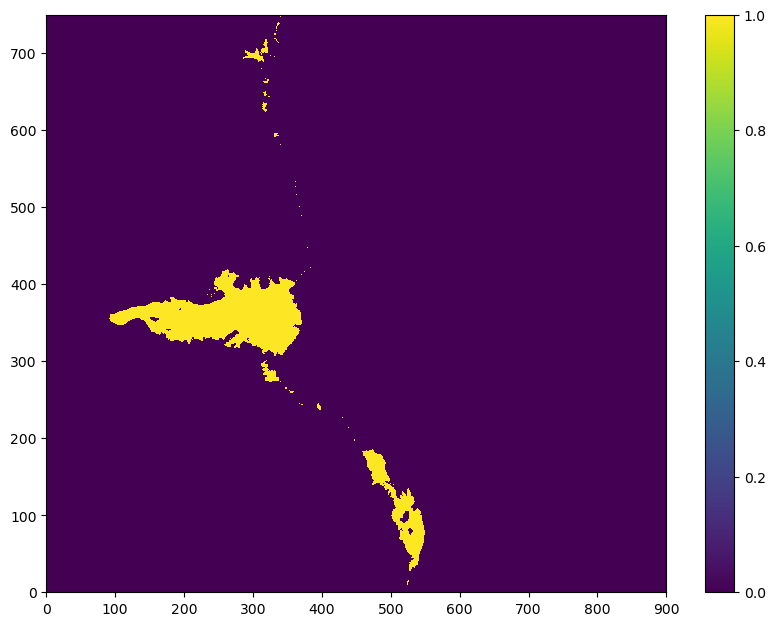

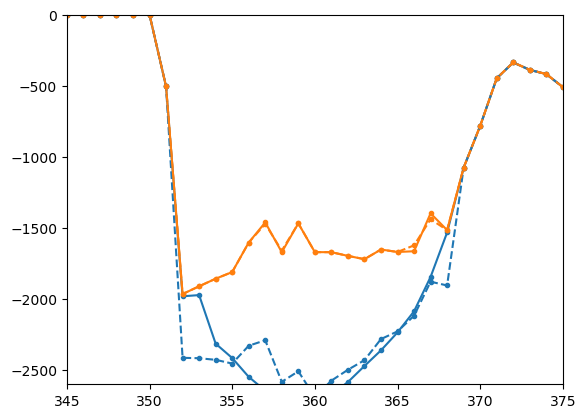

In [18]:
print('First round of smoothing')

print('make masks')
bed = roms_tmp['bathy']
bed_raw = roms_tmp['bathy']
ice = roms_tmp['draft']
mask = roms_tmp['mask_ocean']
maskNaN = mask.copy() # make a nan mask.
maskNaN = np.where(maskNaN==0,np.NaN,maskNaN)
mask_ice = ice.copy()
mask_ice[mask_ice<0]=1
mask_ice[mask_ice>=0]=0

# first, make any bedrock above MSL, and any ice above MSL to 0. (remove mountains)
print('remove mountains etc')
min_depth0=0.3
ice[ice>0] = 0
bed[bed < min_depth0] = min_depth0 #note that bathy cannot >=0

# for any locations where there is wct<min_depth0; deepen the ice a bit until it is at least min_depth0
print('deepen ice until it is at least min_depth')
wct = bed + ice
ice[wct<min_depth0] = -bed[wct<min_depth0] + min_depth0  
wct = bed + ice
plt.figure()
plot_where=120
plt.plot(-roms_tmp['bathy'][:,plot_where],color='C0',marker='.')
plt.plot(roms_tmp['draft'][:,plot_where],color='C1',marker='.')
# plt.plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
plt.plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
plt.plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# plt.plot(-1000*mask[:,plot_where],'.-')
plt.axis((345,375,-2600,0))

# make ice mask
mask_ice = ice.copy()
mask_ice[mask_ice>=0]=0
mask_ice[mask_ice<0]=1
mask_ice = mask_ice*mask
mask_openocean = (mask_ice==0)*mask

# smooth the wct and bed, then deepen the ice to correct for smoothed wct/bed.
print('begin smoothing')
# GOOD VALUE --> rx0in = 0.06
rx0in = 0.06
max_iter = 50

Area = 1/(pm*pn)
print('smooth wct')
wct, HmodifVal, ValueFct = smoothing_PlusMinus_rx0(mask,wct,rx0in,Area,max_iter)
# print('smooth ice')
# ice, HmodifVal, ValueFct = smoothing_PlusMinus_rx0(mask,ice,rx0in,Area,max_iter)
print('now push bed down by new smoothed wct')
bed = wct - ice

print('now, smooth bed')
bed, HmodifVal, ValueFct = smoothing_PlusMinus_rx0(mask,bed,rx0in,Area,max_iter)

ice_o = ice
ice = (wct - bed) # need to correct, as this will have introduced 'false' ice in the open ocean.
# this occurs when the bathymetry was smoothered lower in the open ocean, and thus the wct-bed makes a negative zice.

plt.figure(figsize=(10,7.5))
plt.pcolormesh(ice-ice_o,vmin=-100,vmax=100)
plt.colorbar()
plt.figure(figsize=(10,7.5))
plt.pcolormesh(mask_ice)
plt.colorbar()


plt.figure()
plot_where=120
plt.plot(-roms_tmp['bathy'][:,plot_where],color='C0',marker='.')
plt.plot(roms_tmp['draft'][:,plot_where],color='C1',marker='.')
plt.plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
plt.plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
plt.axis((345,375,-2600,0))


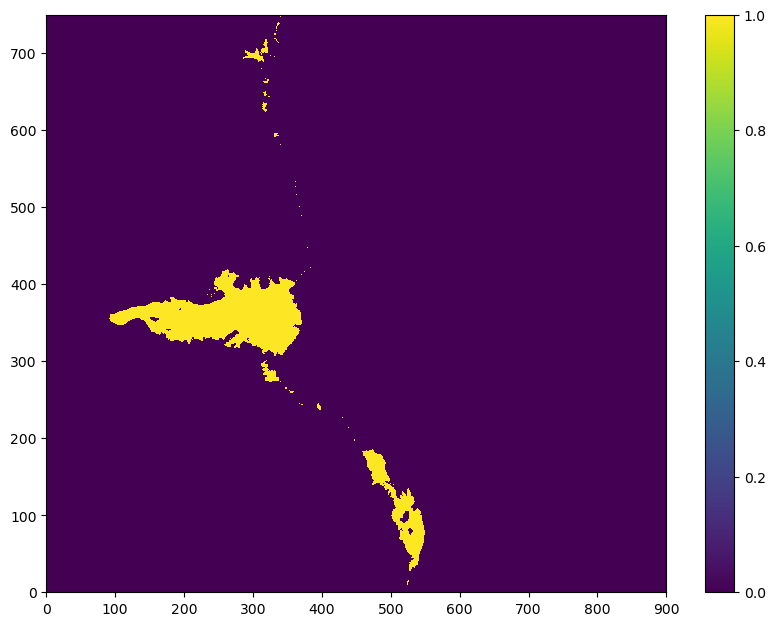

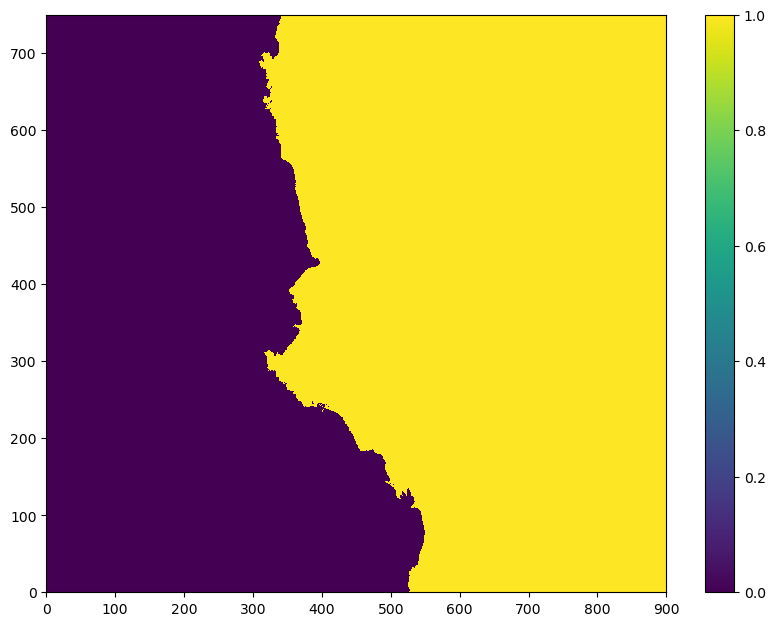

In [19]:
# plt.figure(figsize=(10,7.5))
# plt.pcolormesh(ice-ice_o,vmin=-20,vmax=20)
# plt.colorbar()
# plt.figure(figsize=(10,7.5))
# plt.pcolormesh(mask_ice)
# plt.colorbar()
# plt.figure(figsize=(10,7.5))
# plt.pcolormesh(mask_ice*(ice-ice_o),vmin=-100,vmax=100)
# plt.colorbar()
plt.figure(figsize=(10,7.5))
plt.pcolormesh(mask_ice)
plt.colorbar()
plt.figure(figsize=(10,7.5))
plt.pcolormesh((mask_ice==0)*mask)
plt.colorbar()

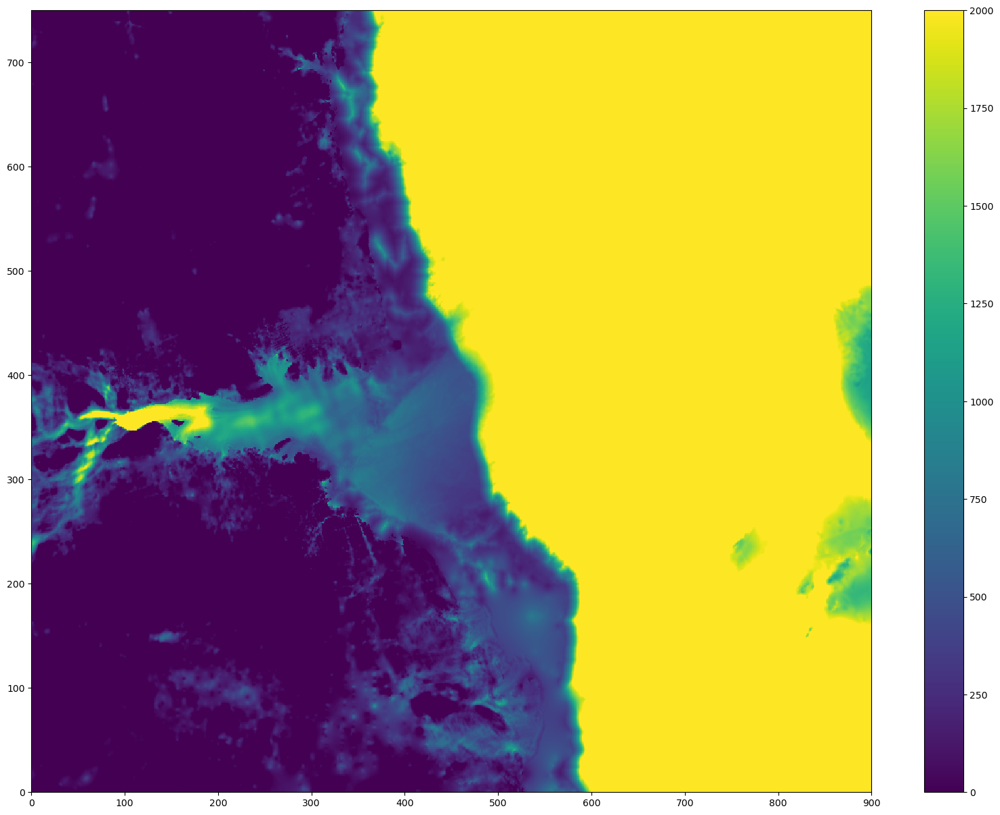

In [20]:
plt.figure(figsize=(20,15))
plt.pcolormesh(bed,vmin=0,vmax=2000)
plt.colorbar()

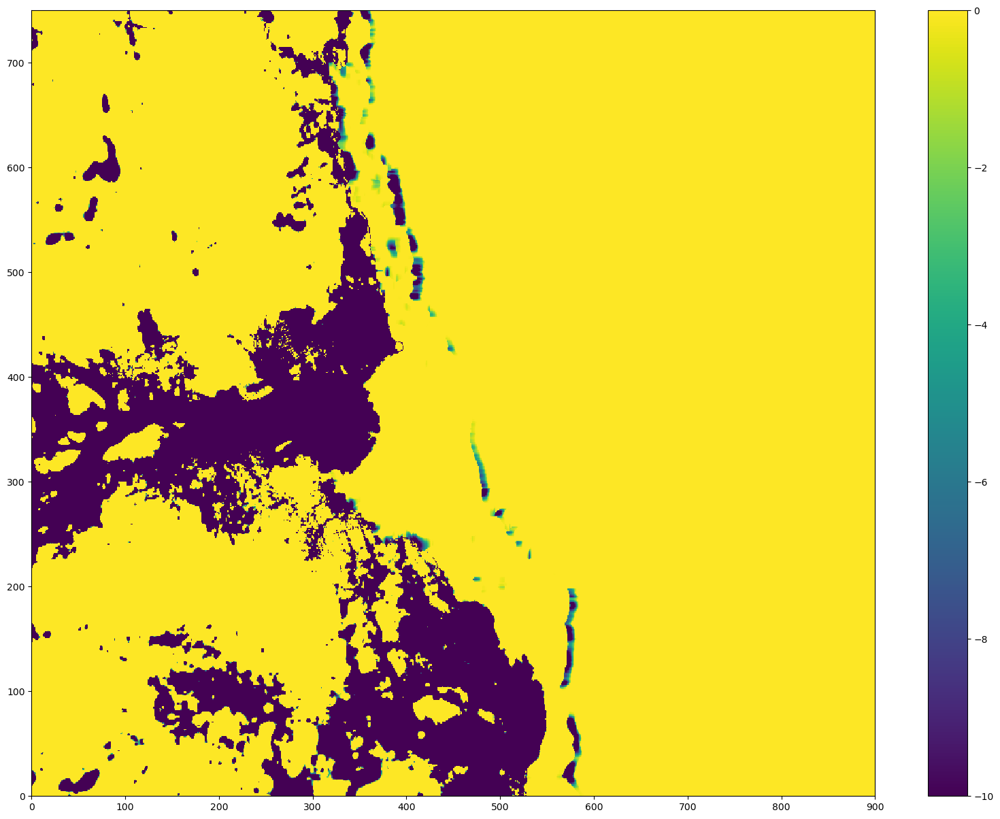

In [21]:
plt.figure(figsize=(20,15))
plt.pcolormesh(ice,vmin=-10,vmax=0)
plt.colorbar()

In [22]:
# do checks
print('whole domain')
print('min/max zice is',ice.min(),'/',ice.max())
print('min/max h is',bed.min(),'/',bed.max())
print('min/max wct is',(wct).min(),'/',(wct).max())
print('ocean cells')
print('min/max zice is',np.nanmin((ice*maskNaN)),'/',np.nanmax((ice*maskNaN)))
print('min/max h is',np.nanmin((bed*maskNaN)),'/',np.nanmax((bed*maskNaN)))
print('min/max wct is',np.nanmin((wct*maskNaN)),'/',np.nanmax((wct*maskNaN)))

whole domain
min/max zice is -3799.4084 / 83.77478
min/max h is 0.3 / 4838.785
min/max wct is 0.2999878 / 4838.785
ocean cells
min/max zice is -2561.080078125 / 83.7747802734375
min/max h is 1.0 / 4838.78515625
min/max wct is 1.0 / 4838.78515625


In [23]:
# where ever the wct<min_depth, deepen the 

bed_smooth1 = bed.copy()
ice_smooth1 = ice.copy()
wct_smooth1 = bed.copy()+ice.copy()
min_depth = 50.0
ii = ((bed + ice) < min_depth) & (mask == 1)
bed[ii] = -ice[ii] + min_depth
wct=bed+ice


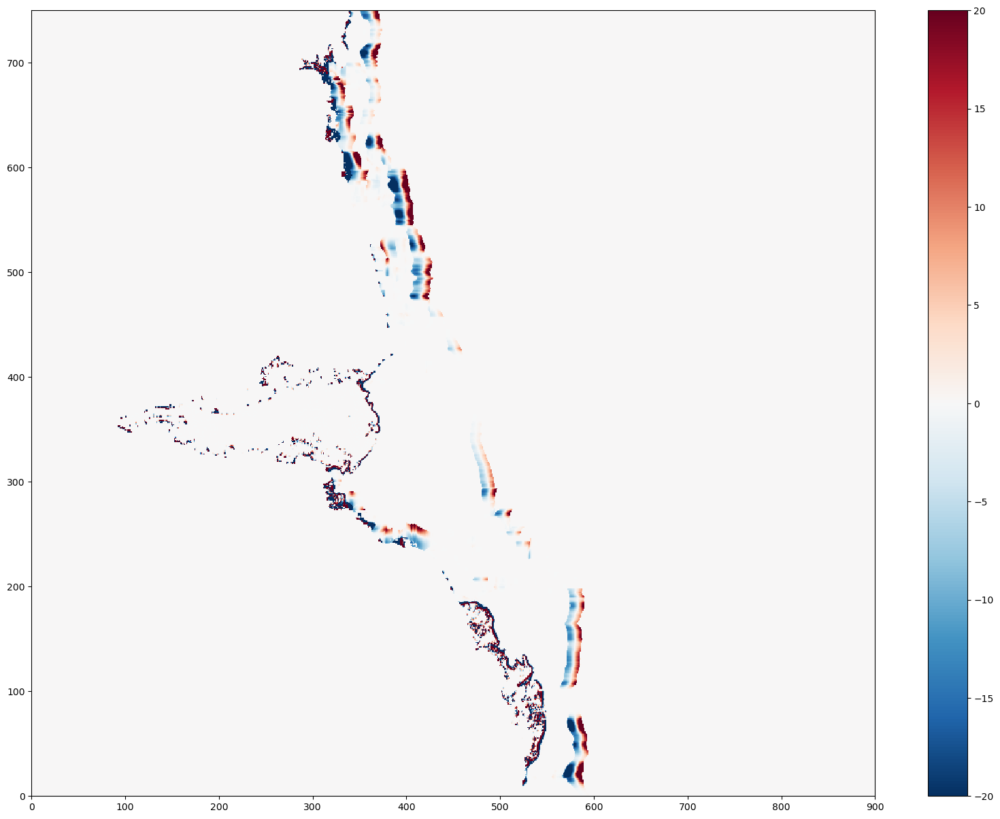

In [24]:
plt.figure(figsize=(20,15))
plt.pcolormesh(ice-ice_o,vmin=-20,vmax=20,cmap='RdBu_r')
plt.colorbar()

In [25]:
# do checks
print('min/max zice is',ice.min(),'/',ice.max())
print('min/max h is',bed.min(),'/',bed.max())
print('min/max wct is',(wct).min(),'/',(wct).max())
print('ocean cells')
print('min/max zice is',np.nanmin((ice*maskNaN)),'/',np.nanmax((ice*maskNaN)))
print('min/max h is',np.nanmin((bed*maskNaN)),'/',np.nanmax((bed*maskNaN)))
print('min/max wct is',np.nanmin((wct*maskNaN)),'/',np.nanmax((wct*maskNaN)))

min/max zice is -3799.4084 / 83.77478
min/max h is 0.3 / 4838.785
min/max wct is 0.2999878 / 4838.785
ocean cells
min/max zice is -2561.080078125 / 83.7747802734375
min/max h is 50.0 / 4838.78515625
min/max wct is 49.99993896484375 / 4838.78515625


In [26]:

# fig,axs=plt.subplots(4,figsize=(10,10))
# plot_where=270
# axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
# axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
# axs[0].axis((340,420,-1500,0))

# axs[1].plot(-bed[:,plot_where],'.-')
# axs[1].plot(ice[:,plot_where],'.-')
# axs[1].plot(-1000*mask[:,plot_where],'.-')
# axs[1].axis((340,420,-1500,0))

# axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
# axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# # axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
# axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
# axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# # axs[2].plot(-1000*mask[:,plot_where],'.-')
# axs[2].axis((340,420,-1500,0))

# axs[3].plot(grd_rx1_pre[:,plot_where-1])
# axs[3].plot(grd_rx1_mid[:,plot_where-1])
# axs[3].set_xlim((340,420))


# fig,axs=plt.subplots(4,figsize=(10,10))
# plot_where=98
# axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
# axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
# axs[0].axis((320,380,-3000,0))

# axs[1].plot(-bed[:,plot_where],'.-')
# axs[1].plot(ice[:,plot_where],'.-')
# axs[1].plot(-1000*mask[:,plot_where],'.-')
# axs[1].axis((320,380,-3000,0))

# axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
# axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# # axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
# axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
# axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# # axs[2].plot(-1000*mask[:,plot_where],'.-')
# axs[2].axis((320,380,-3000,0))

# axs[3].plot(grd_rx1_pre[:,plot_where-1])
# axs[3].plot(grd_rx1_mid[:,plot_where-1])
# axs[3].set_xlim((320,380))


# fig,axs=plt.subplots(4,figsize=(10,10))
# plot_where=205
# axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
# axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
# axs[0].axis((320,380,-3000,0))

# axs[1].plot(-bed[:,plot_where],'.-')
# axs[1].plot(ice[:,plot_where],'.-')
# axs[1].plot(-1000*mask[:,plot_where],'.-')
# axs[1].axis((320,380,-3000,0))

# axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
# axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# # axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
# axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
# axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# # axs[2].plot(-1000*mask[:,plot_where],'.-')
# axs[2].axis((320,380,-3000,0))

# axs[3].plot(grd_rx1_pre[:,plot_where-1])
# axs[3].plot(grd_rx1_mid[:,plot_where-1])
# axs[3].set_xlim((320,380))



  
Minimum r-value =  0.0
Maximum r-value =  0.10283109545707703
Mean    r-value =  0.00630347288657475
Median  r-value =  0.0009194816229864955


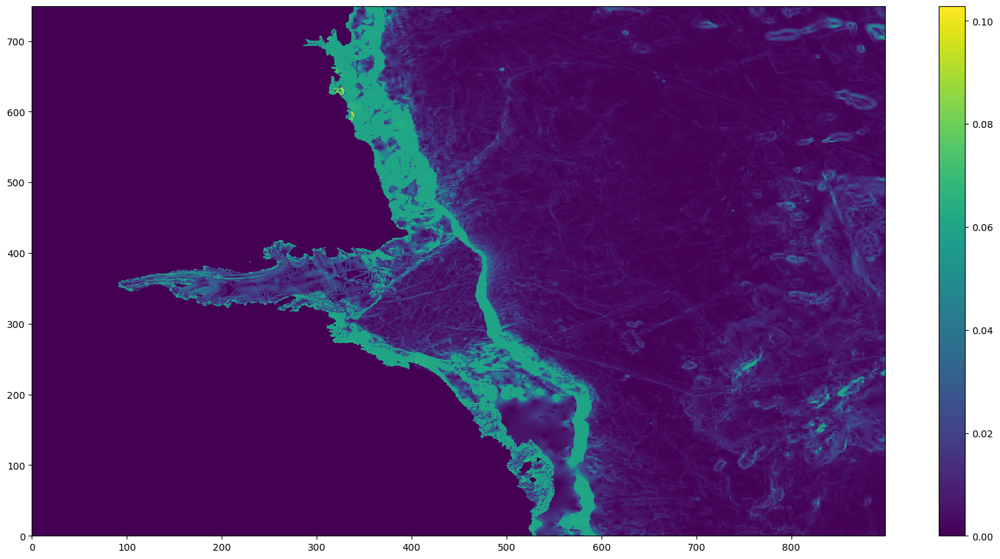

  
Minimum r-value =  0.0
Maximum r-value =  396.76898089795475
Mean    r-value =  1.692076672843376
Median  r-value =  0.24651469314570928


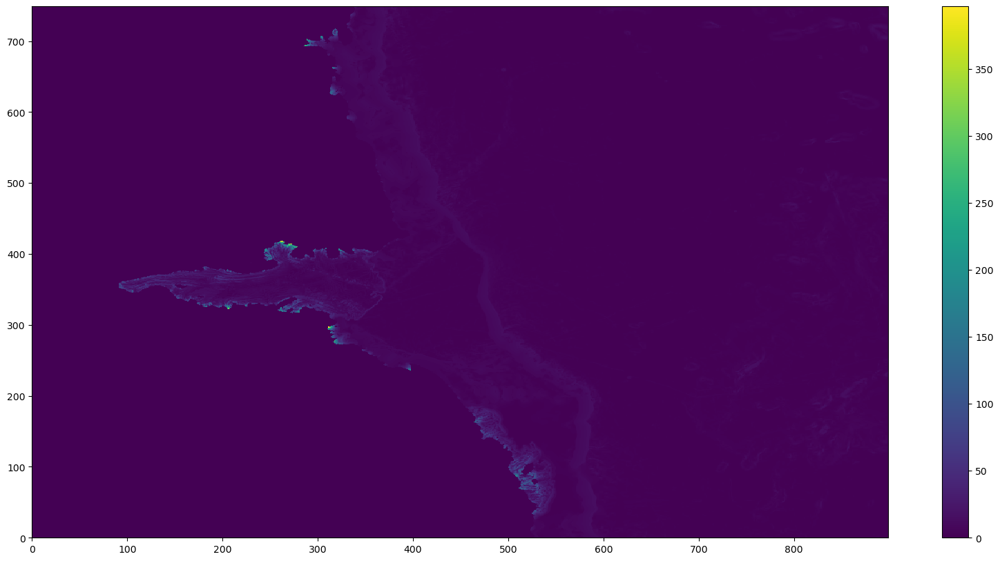

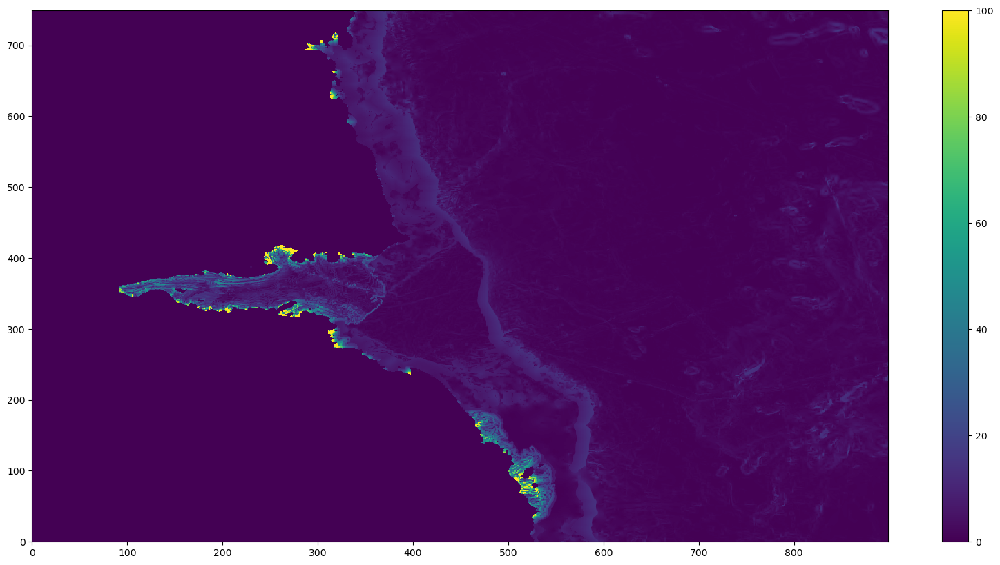

In [27]:


z_rho_mid,z_w_mid,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,bed,ice)

fig = plt.figure(figsize=(20,10))
grd_rx0_mid=GridStiffness.rx0(bed,mask)
plt.pcolormesh(grd_rx0_mid)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,10))
grd_rx1_mid=GridStiffness.rx1(z_w_mid,mask)
plt.pcolormesh(grd_rx1_mid)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,10))
plt.pcolormesh(grd_rx1_mid,vmin=0,vmax=100)
plt.colorbar()
plt.show()

(320.0, 380.0)

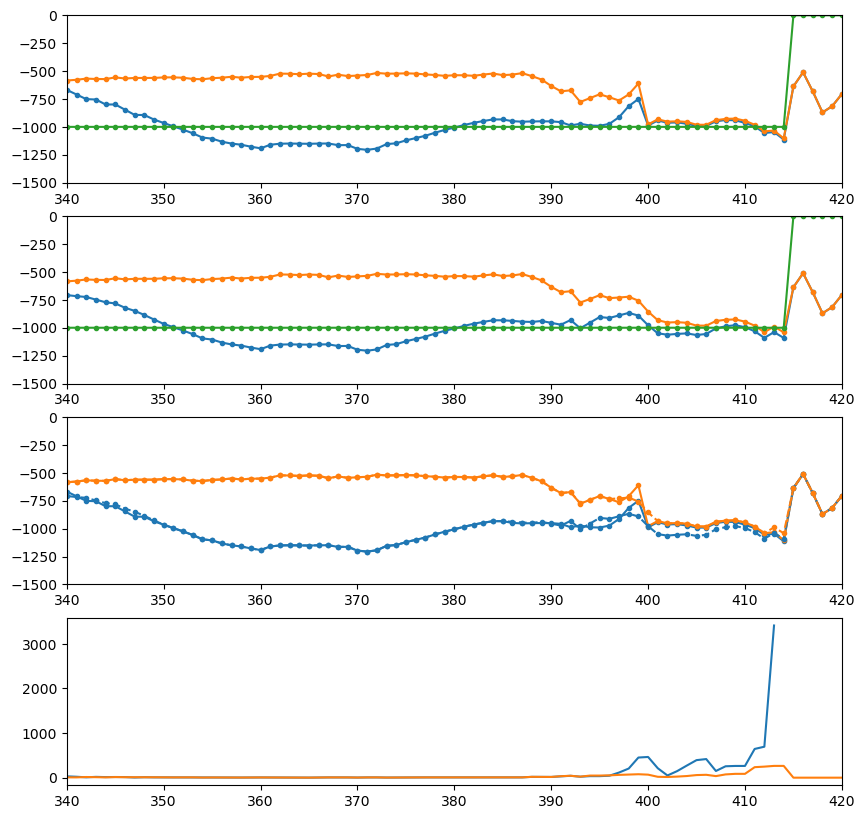

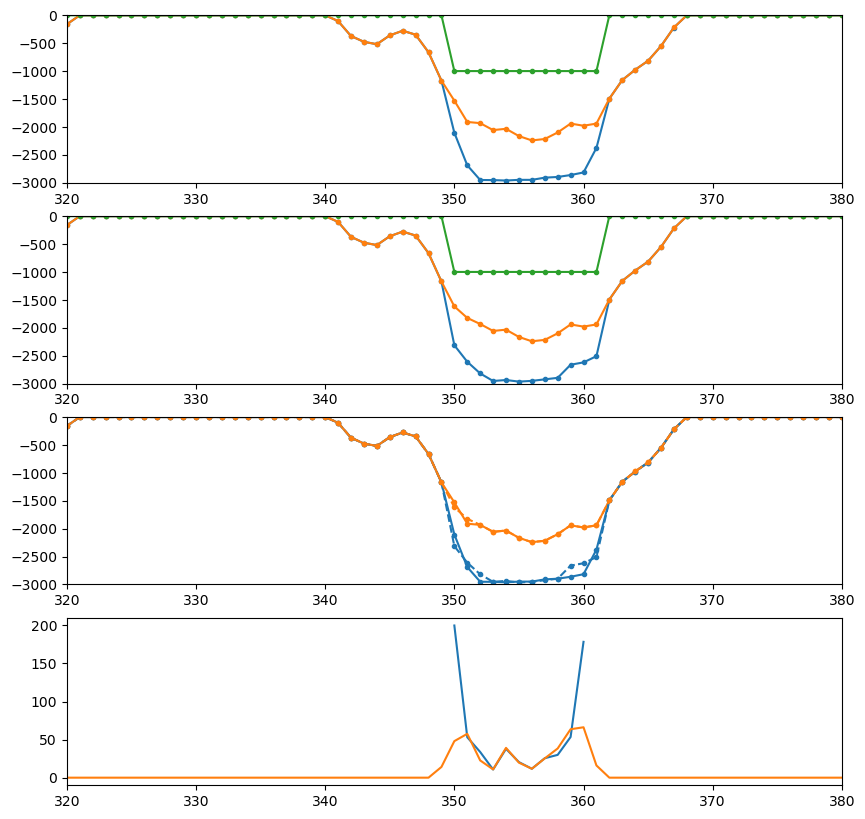

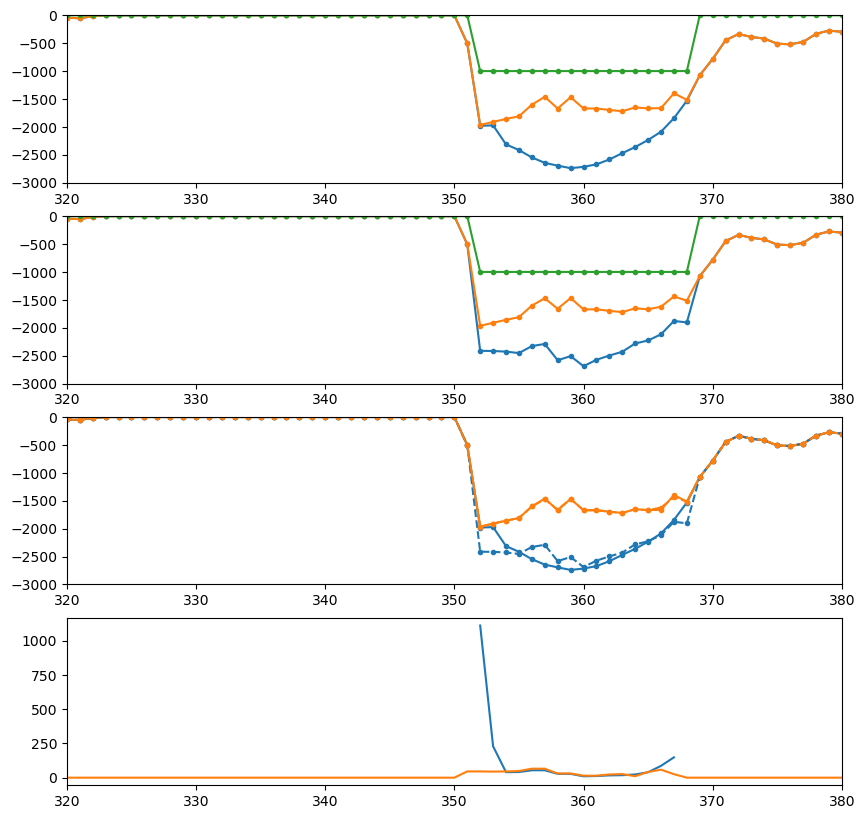

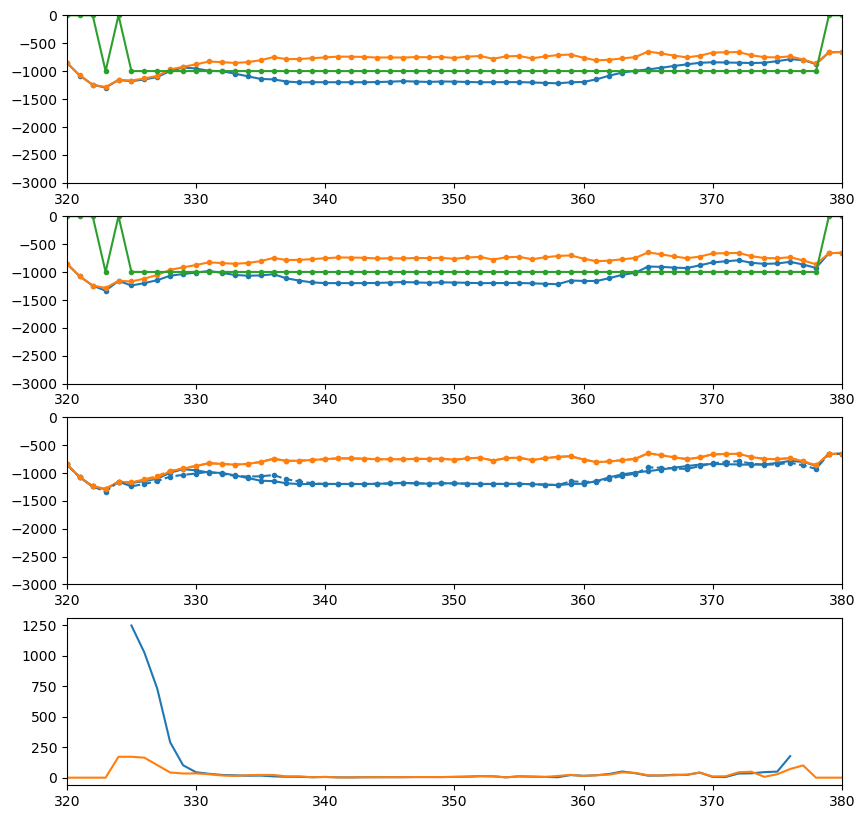

In [28]:

fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=270
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((340,420,-1500,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((340,420,-1500,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((340,420,-1500,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((340,420))


fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=98
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((320,380,-3000,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((320,380,-3000,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((320,380,-3000,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((320,380))

fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=120
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((320,380,-3000,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((320,380,-3000,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((320,380,-3000,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((320,380))


fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=205
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((320,380,-3000,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((320,380,-3000,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((320,380,-3000,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((320,380))



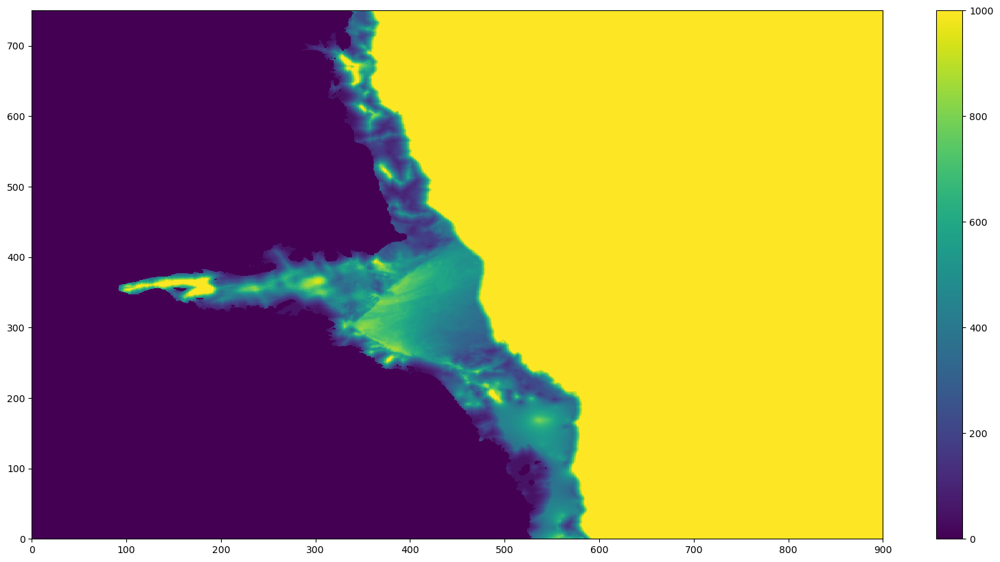

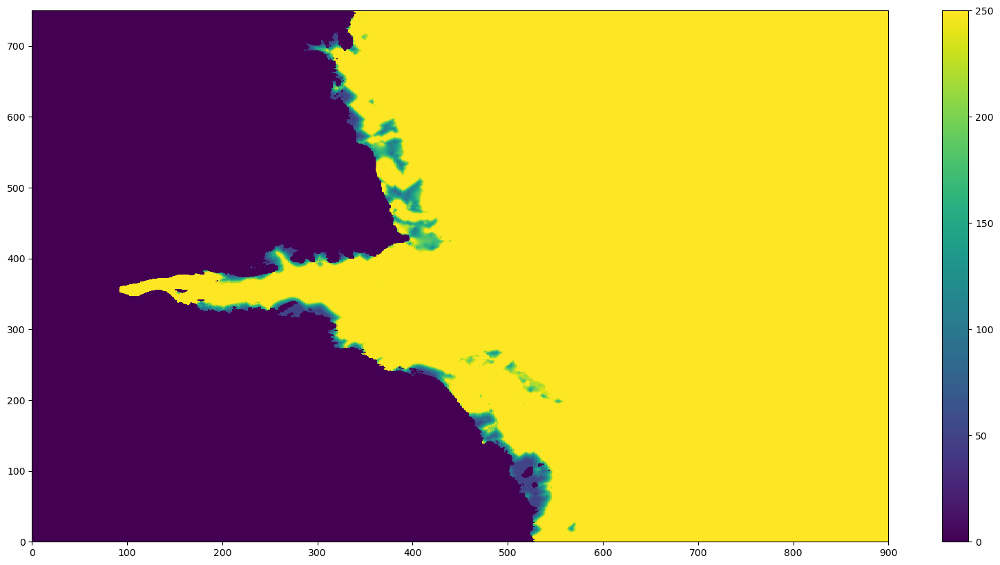

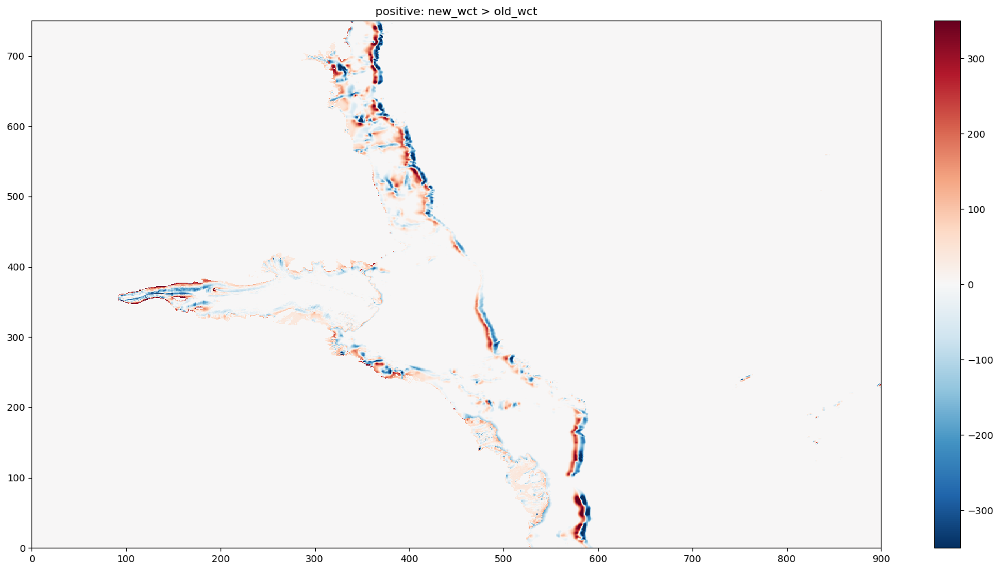

In [29]:
old_wct = (roms_tmp['bathy']+roms_tmp['draft'])*roms_tmp['mask_ocean']
new_wct = (bed+ice)*mask

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(new_wct,vmin=0,vmax=1000)
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(new_wct,vmin=0,vmax=250)
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(new_wct-old_wct,vmin=-350,vmax=350,cmap='RdBu_r')
plt.title('positive: new_wct > old_wct')
plt.colorbar()

In [30]:
# check new cavity volume

print('initial volume was ',initial_volume/1e12,'x10^12 m3')


print('new volume ',np.sum(mask_amery*(ice+bed)*dx*dy),'m3')
print(np.sum(mask_amery*(bed+ice)*dx*dy)/1e12,'x10^12 m3')
print('ratio of new/old volume is ',np.sum(mask_amery*(ice+bed)*dx*dy)/initial_volume)


initial volume was  26.30275814985353 x10^12 m3
new volume  26412215484390.703 m3
26.412215484390703 x10^12 m3
ratio of new/old volume is  1.004161439416869


In [31]:
# i don't think second round of smoothing helps.
# # Second round of smoothing 
# rx0in=0.3
# bed, HmodifVal, ValueFct = smoothing_PlusMinus_rx0(np.ones_like(wct),bed,rx0in,Area,max_iter)
# wct, HmodifVal, ValueFct = smoothing_PlusMinus_rx0(np.ones_like(wct),wct,rx0in,Area,max_iter)
# ice = wct-bed
# bed_smooth2 = bed.copy()
# ice_smooth2 = ice.copy()

# Now enforce that there is no ice > 0
ii = ice>0
ice[ii] = 0

# now re-check that min_depth is obeyed for all ocean points
ii = ((bed + ice) < min_depth) & (mask == 1)
bed[ii] = -ice[ii] + min_depth

# do the same for all non-ocean points
ii = ((bed + ice) < min_depth) & (mask == 0)
ice[ii] = min_depth-bed[ii] # for those locations, the depth needs to be min_depth above the bathy

wct=bed+ice

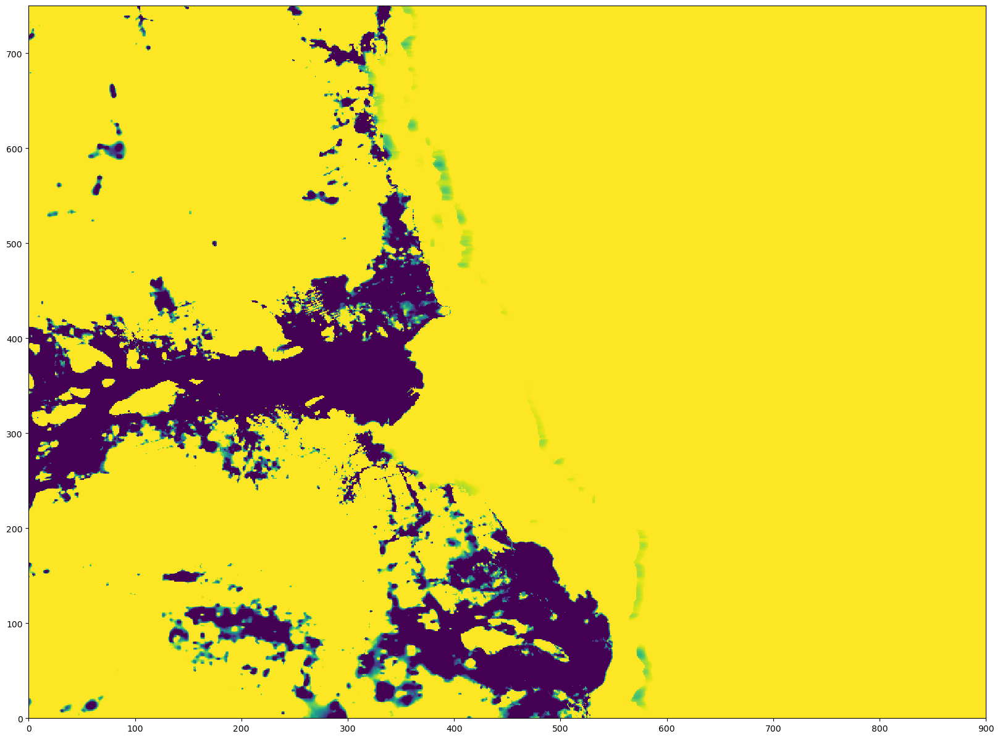

In [32]:
plt.figure(figsize=(20,15))
plt.pcolormesh(ice,vmin=-100,vmax=0)

(320.0, 380.0)

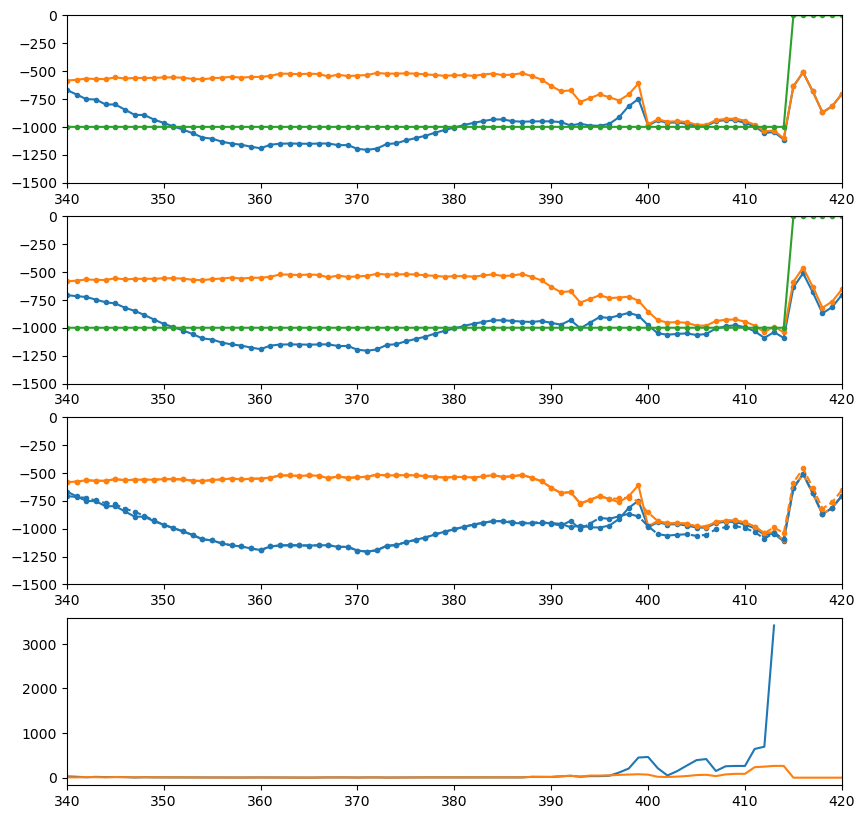

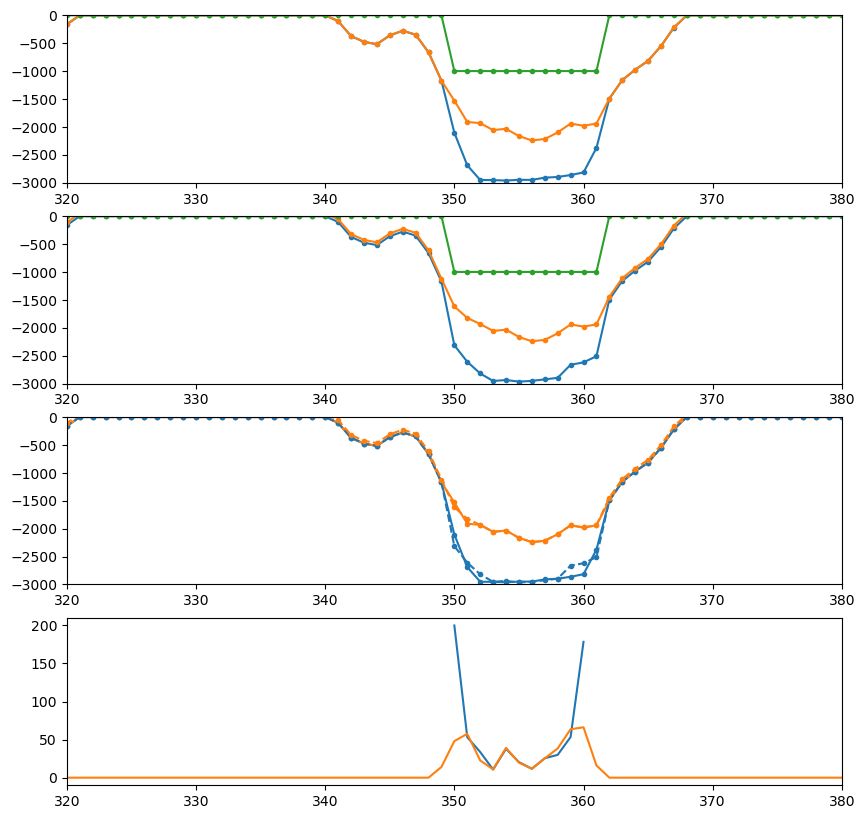

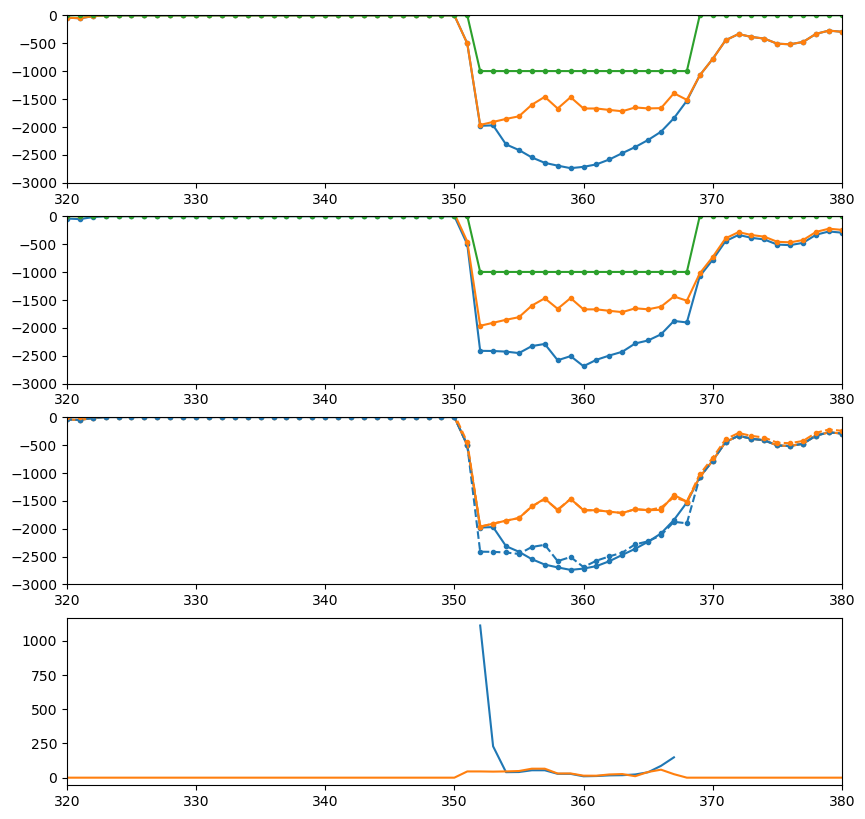

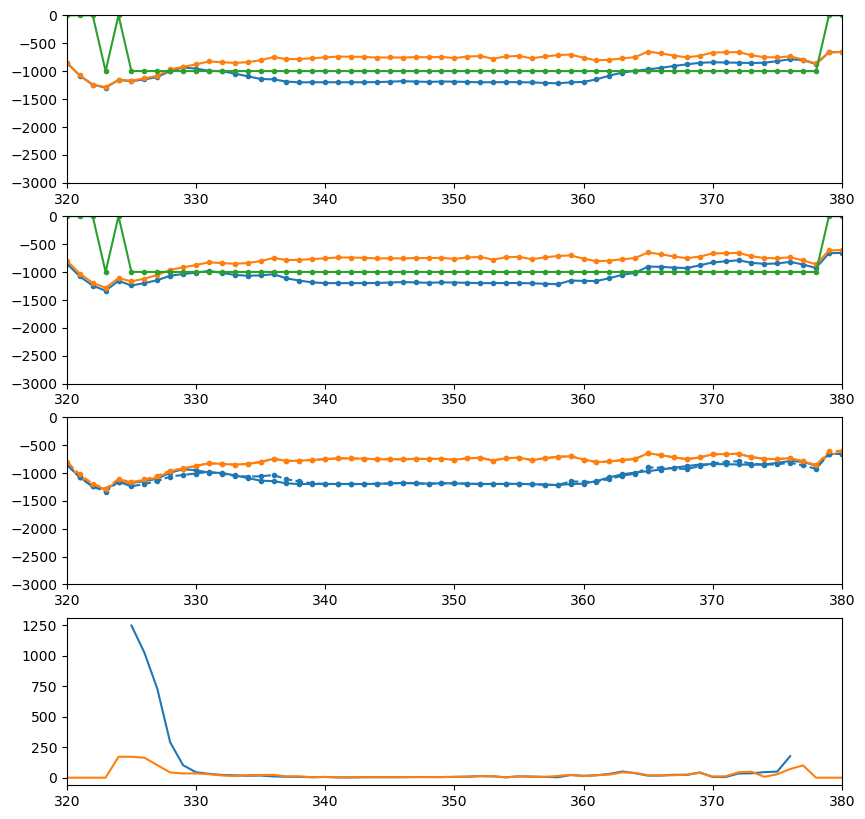

In [33]:

fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=270
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((340,420,-1500,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((340,420,-1500,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((340,420,-1500,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((340,420))


fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=98
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((320,380,-3000,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((320,380,-3000,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((320,380,-3000,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((320,380))

fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=120
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((320,380,-3000,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((320,380,-3000,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((320,380,-3000,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((320,380))


fig,axs=plt.subplots(4,figsize=(10,10))
plot_where=205
axs[0].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[0].plot(roms_tmp['draft'][:,plot_where],'.-')
axs[0].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[0].axis((320,380,-3000,0))

axs[1].plot(-bed[:,plot_where],'.-')
axs[1].plot(ice[:,plot_where],'.-')
axs[1].plot(-1000*mask[:,plot_where],'.-')
axs[1].axis((320,380,-3000,0))

axs[2].plot(-roms_tmp['bathy'][:,plot_where],'.-')
axs[2].plot(roms_tmp['draft'][:,plot_where],'.-')
# axs[2].plot(-1000*roms_tmp['mask_ocean'][:,plot_where],'.-')
axs[2].plot(-bed[:,plot_where],color='C0',marker='.',linestyle='dashed')
axs[2].plot(ice[:,plot_where],color='C1',marker='.',linestyle='dashed')
# axs[2].plot(-1000*mask[:,plot_where],'.-')
axs[2].axis((320,380,-3000,0))

axs[3].plot(grd_rx1_pre[:,plot_where-1])
axs[3].plot(grd_rx1_mid[:,plot_where-1])
axs[3].set_xlim((320,380))



In [34]:
# do checks
print('whole domain')
print('min/max zice is',ice.min(),'/',ice.max())
print('min/max h is',bed.min(),'/',bed.max())
print('min/max wct is',(wct).min(),'/',(wct).max())
print('ocean cells')
print('min/max zice is',np.nanmin(ice*maskNaN),'/',np.nanmax(ice*maskNaN))
print('min/max h is',np.nanmin(bed*maskNaN),'/',np.nanmax(bed*maskNaN))
print('min/max wct is',np.nanmin(wct*maskNaN),'/',np.nanmax(wct*maskNaN))

whole domain
min/max zice is -3749.7085 / 49.7
min/max h is 0.3 / 4838.785
min/max wct is 49.99994 / 4838.785
ocean cells
min/max zice is -2561.080078125 / 0.0
min/max h is 50.0 / 4838.78515625
min/max wct is 49.99993896484375 / 4838.78515625


In [35]:


roms_tmp['bed'] = bed
roms_tmp['ice'] = ice
roms_tmp['mask'] = mask

In [36]:
if plotting:
    plt.close()
    for k,v in roms_tmp.items():
        plt.figure(figsize=(5,3))
        print(k)
        plt.pcolormesh(v)
        plt.colorbar()
        plt.show()

In [37]:
mask = mask.astype(float)
mindxy = min(np.hstack((1/pm.flatten(),1/pn.flatten())))
maskNaN = mask.copy()
maskNaN[mask==0]=np.nan
CFL = mindxy/abs(np.sqrt(9.81*wct))*maskNaN

print('max fast DT in s following CFL: ', np.nanmin(CFL))
print('max slow DT in s following CFL: ', np.nanmin(mindxy/8*maskNaN)) # approx max 8m/s baroclinic wave speed
print('Set ROMS timestep settings of at least: \n','DT <',np.nanmin(mindxy/8*maskNaN),'s \n NDTFAST >',(np.nanmin(mindxy/8*maskNaN)/np.nanmin(CFL)).round())
timescale = 12*60*60 #s
print('approximate viscosity settings for smoothing timescale of ',timescale/(60*60),' hrs')
print('visc2 for 2dx noise ~ ',(2*mindxy/(2*np.pi))**2 / timescale)
print('approximate diff settings are an order of magnitude lower:')
print('tnu2 ~ ',((2*mindxy/(2*np.pi))**2 / timescale/10))

max fast DT in s following CFL:  8.67147445678711
max slow DT in s following CFL:  236.15961967599594
Set ROMS timestep settings of at least: 
 DT < 236.15961967599594 s 
 NDTFAST > 27.0
approximate viscosity settings for smoothing timescale of  12.0  hrs
visc2 for 2dx noise ~  8.37158638959344
approximate diff settings are an order of magnitude lower:
tnu2 ~  0.8371586389593441


In [38]:
# do checks
print('whole domain')
print('min/max zice is',ice.min(),'/',ice.max())
print('min/max h is',bed.min(),'/',bed.max())
print('min/max wct is',(bed+ice).min(),'/',(bed+ice).max())
print('ocean cells')
print('min/max zice is',np.nanmin(ice*maskNaN),'/',np.nanmax(ice*maskNaN))
print('min/max h is',np.nanmin(bed*maskNaN),'/',np.nanmax(bed*maskNaN))
print('min/max wct is',np.nanmin(wct*maskNaN),'/',np.nanmax(wct*maskNaN))

whole domain
min/max zice is -3749.7085 / 49.7
min/max h is 0.3 / 4838.785
min/max wct is 49.99994 / 4838.785
ocean cells
min/max zice is -2561.080078125 / 0.0
min/max h is 50.0 / 4838.78515625
min/max wct is 49.99993896484375 / 4838.78515625


  
Minimum r-value =  0.0
Maximum r-value =  0.10283109545707703
Mean    r-value =  0.00630347288657475
Median  r-value =  0.0009194816229864955


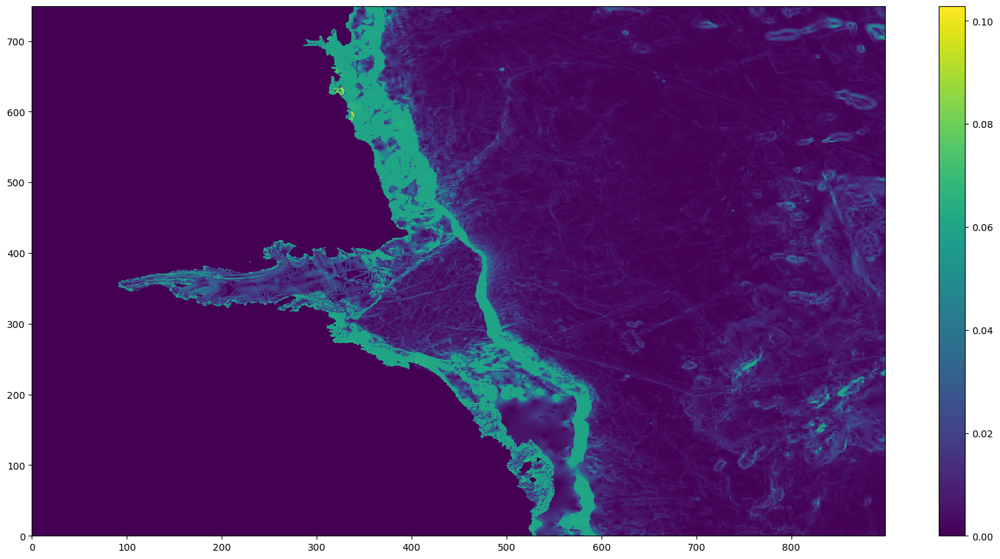

  
Minimum r-value =  0.0
Maximum r-value =  396.76898089795475
Mean    r-value =  1.6928637504410942
Median  r-value =  0.24651469314570928


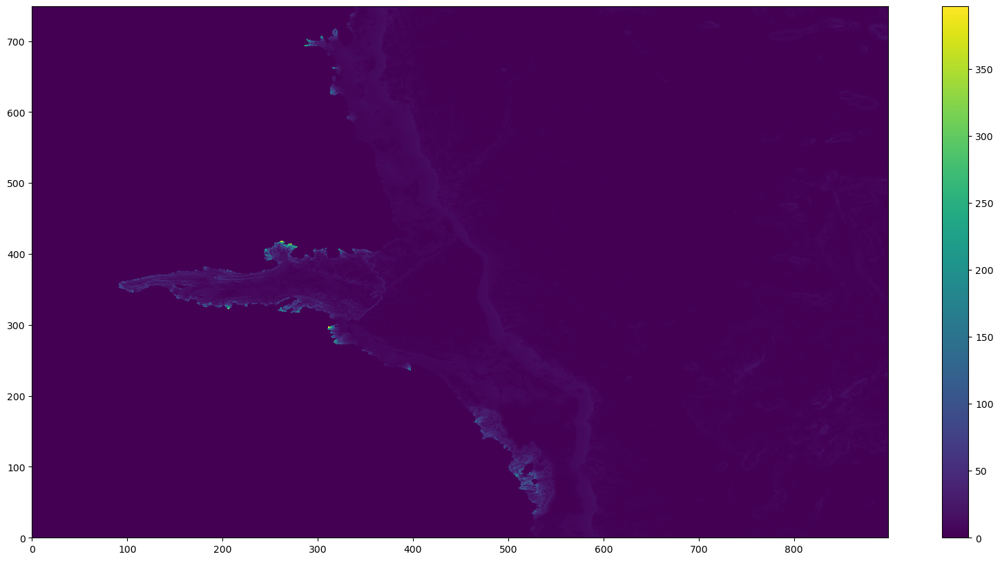

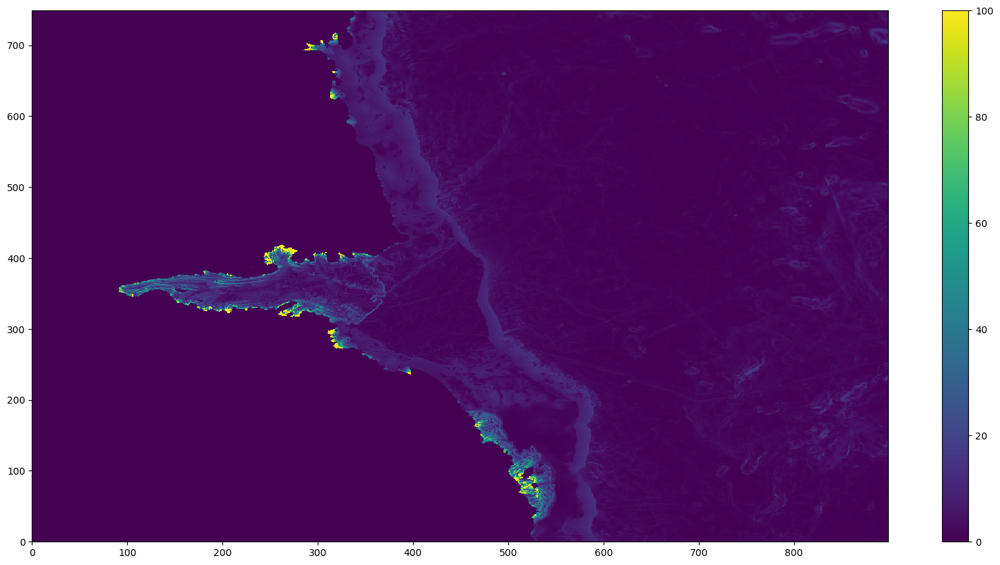

In [39]:



z_rho_post,z_w_post,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,roms_tmp['bed'],roms_tmp['ice'])

fig = plt.figure(figsize=(20,10))
grd_rx0_post=GridStiffness.rx0(roms_tmp['bed'],roms_tmp['mask'])
plt.pcolormesh(grd_rx0_post)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,10))
grd_rx1_post=GridStiffness.rx1(z_w_post,roms_tmp['mask'])
plt.pcolormesh(grd_rx1_post)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,10))
plt.pcolormesh(grd_rx1_post,vmin=0,vmax=100)
plt.colorbar()
plt.show()

In [40]:
# in_val = zzz.copy()
# ocean_mask = mmm.copy()
# rx0val = 0.06
# Area = Area
# max_iterations = 20
# roi_row_min=395
# roi_row_max=423
# roi_col_min=240
# roi_col_max=280
# if_plotting  = 1

# msk = np.zeros(in_val.shape)

# import matplotlib.pyplot as plt
# %matplotlib inline

# msk[roi_row_min:roi_row_max,roi_col_min:roi_col_max] = 1
# msk = (msk*ocean_mask).copy()
# if if_plotting:
#     plt.pcolormesh(msk)
#     plt.show()
# out_smooth, HmodifVal, ValueFct = smoothing_PlusMinus_rx0(msk,in_val,rx0val,Area,max_iterations)

# if if_plotting:
#     plt.pcolormesh(out_smooth-in_val)
#     plt.colorbar()
#     plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
#     plt.show()

#     plt.pcolormesh(out_smooth)
#     plt.colorbar()
#     plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
#     plt.show()

# plt.pcolormesh((hhh+zzz)*msk)
# plt.colorbar()
# plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
# plt.show()

# plt.pcolormesh((hhh+zzz - out_smooth)*msk)
# plt.colorbar()
# plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
# plt.show()


In [41]:
# # function to deepen bathy to enforce minimum WCT in a certain region


# hhh=roms_tmp['bed'].copy()
# zzz=roms_tmp['ice'].copy()
# mmm=roms_tmp['mask'].copy()



# in_z = zzz.copy()
# in_h = hhh.copy()
# in_msko = mmm.copy()
# roi_row_min=395
# roi_row_max=423
# roi_col_min=240
# roi_col_max=280
# if_plotting  = 1
# min_threshold_h = 75

# msk = np.zeros(in_h.shape)
# plt.close('all')
# import matplotlib.pyplot as plt
# %matplotlib inline

# msk[roi_row_min:roi_row_max,roi_col_min:roi_col_max] = 1
# msk = (msk*ocean_mask).copy()

# if if_plotting:
#     plt.pcolormesh(msk)
#     plt.show()

# wct_thr = (in_z+in_h) < min_threshold_h

# msk_full = (wct_thr*msk)
# msk_full = msk_full==1


# out = in_h.copy()
# out[msk_full] = -in_z[msk_full] + min_threshold_h

# if if_plotting:
#     plt.pcolormesh(msk_full)
#     plt.colorbar()
#     plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
#     plt.title('msk_full')
#     plt.show()

#     plt.pcolormesh(out)
#     plt.colorbar()
#     plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
#     plt.title('new h')
#     plt.show()

#     plt.pcolormesh((in_h+in_z)*msk)
#     plt.colorbar()
#     plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
#     plt.title('old wct')
#     plt.show()

#     plt.pcolormesh((out - in_h))
#     plt.colorbar()
#     plt.axis((roi_col_min-10,roi_col_max+10,roi_row_min-10,roi_row_max+10))
#     plt.title('diff in wct (new-old)')
#     plt.show()

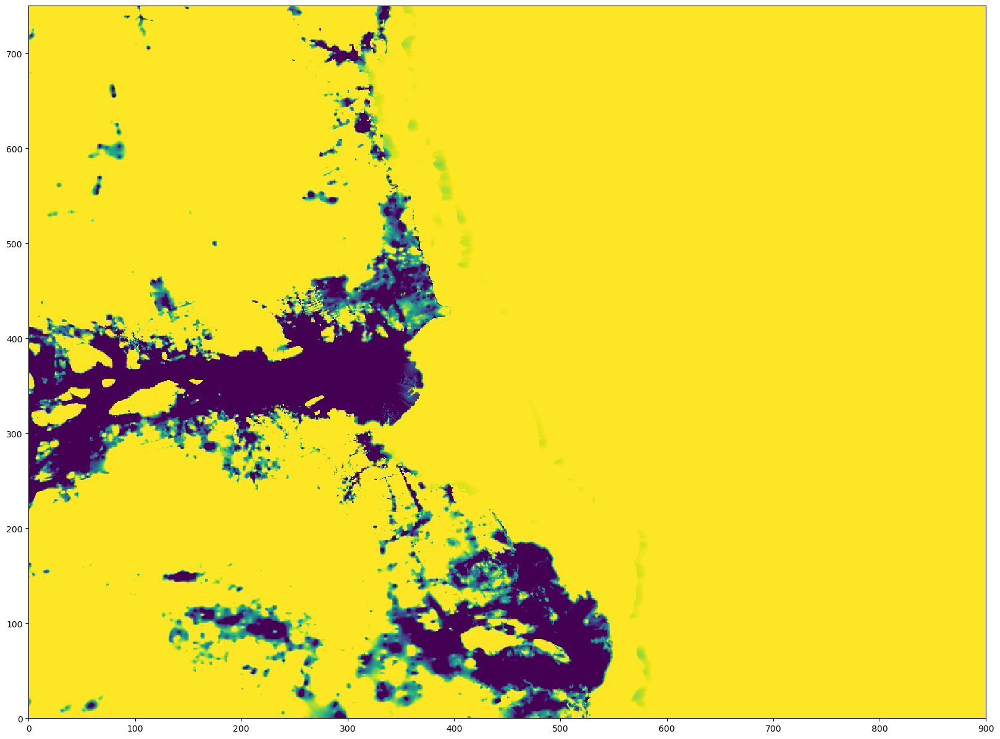

In [42]:
plt.figure(figsize=(20,15))
plt.pcolormesh(roms_tmp['ice'],vmin=-200,vmax=0)

already opened somewhere!


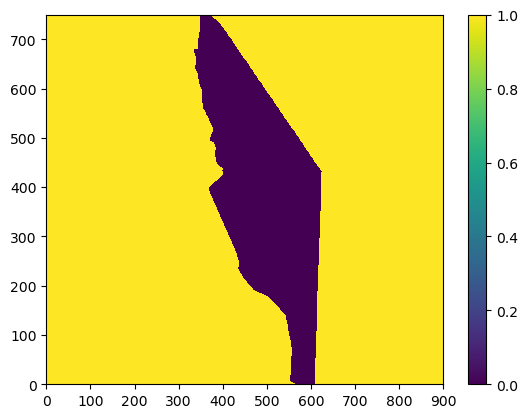

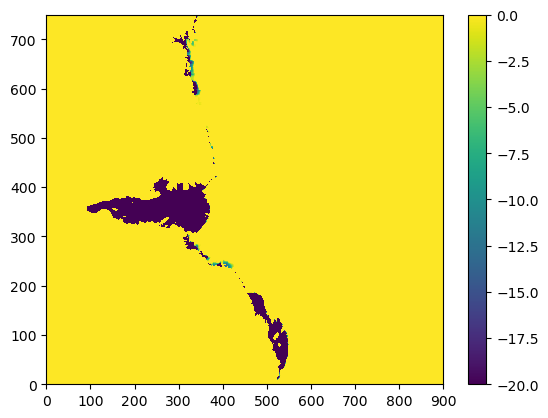

continuing...


In [43]:

# correct ice so that it isn't adjusted where it never previously existed.
zzz_backup = roms_tmp['ice'].copy()

# OPTION 1:
# need to correct to only update ice below ice shelves. Could do it with a find ice<0, or could just multiply by mask....
# This will keep the strict masking and precisely defined ice shelf edges 
#zzz = zzz_backup*(mask_openocean==0) 

#OPTION 2:
# manually remove any false ice. This will leave the slight smoothing that has been applied through the smoothin process.
# This will keep the reduced rx1 at the edge of ice shelves.
roms_tmp_ice_da = xr.DataArray(roms_tmp['ice'],name='ice',dims=['eta_rho','xi_rho'],attrs={'long_name': 'roms_["ice"]', 'units': 'meter'})
try:
    roms_tmp_ice_da.to_netcdf('../data/proc/temporary_zice.nc')
except:
    print('already opened somewhere!')

# plt.close('all')
# # import matplotlib
# # matplotlib.use('Qt5Agg')
# import matplotlib.pyplot as plt
# import PyQt5
# %matplotlib qt
# # import mplcursors

# fig,ax=plt.subplots(figsize=(15,10))
# im = ax.pcolormesh(roms_tmp['ice']!=0)
# # cursor = mplcursors.cursor(im, hover=True)
# pts = plt.ginput(n=-1)

# plt.show()

masking_ds = xr.open_dataset('../data/proc/temporary_zice_mask.nc')

plt.figure()
plt.pcolormesh(~masking_ds.IN_icemask)
plt.colorbar()

plt.figure()
plt.pcolormesh(roms_tmp['ice']*~masking_ds.IN_icemask*roms_tmp['mask'],vmin=-20,vmax=0)
plt.colorbar()
plt.show()

# if input('Are you happy with this? (Y/N)?')=='Y':
print('continuing...')
roms_tmp['ice'] = (roms_tmp['ice']*~masking_ds.IN_icemask.values).copy()
    
# else:
#     STOP
# print(pts)

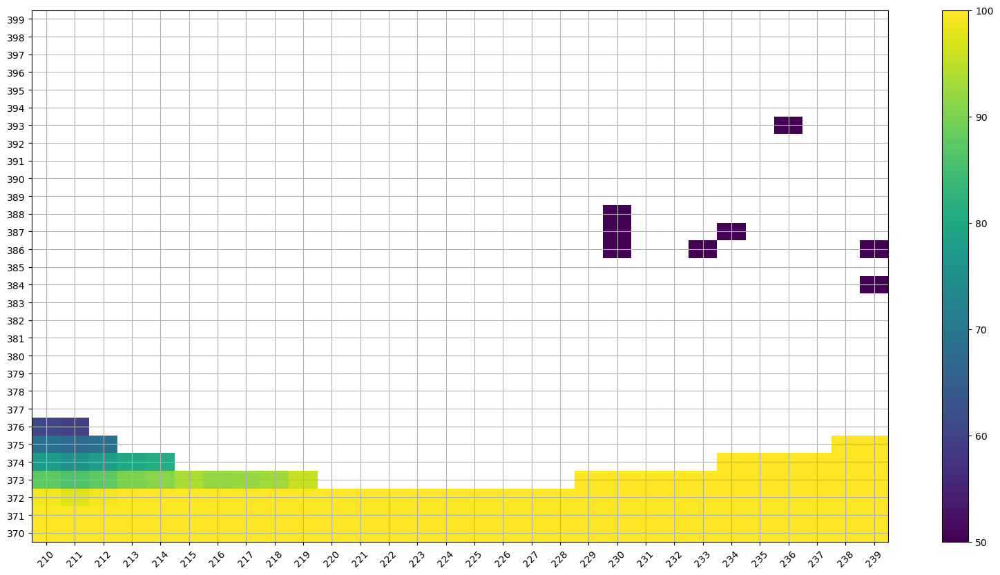

Old Max Roughness value is:  0.08613420277833939


DeltaBathymetry =  -14756.3271484375
New Max Roughness value is:  0.09331470727920532


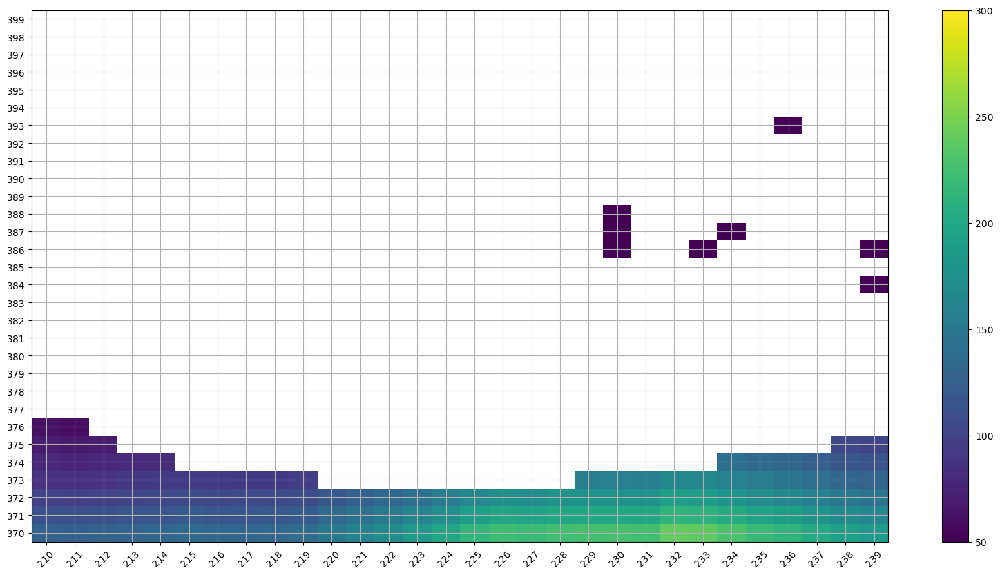

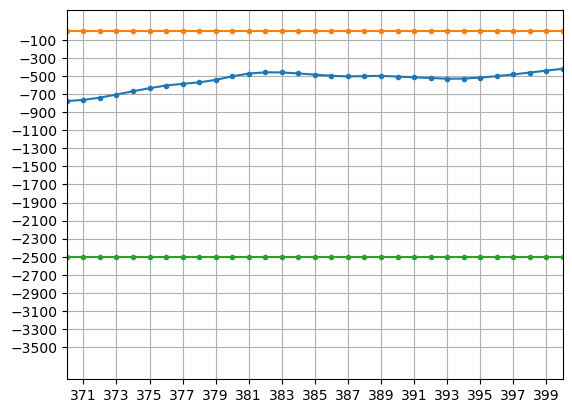

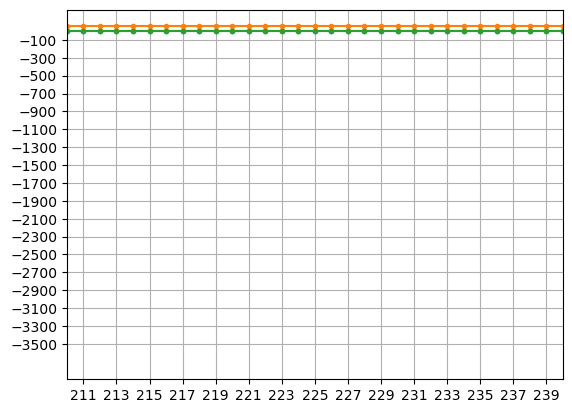

  
Minimum r-value =  0.0
Maximum r-value =  75.59622074385433
Mean    r-value =  1.4966654159373787
Median  r-value =  0.2451644280711933
(0,)


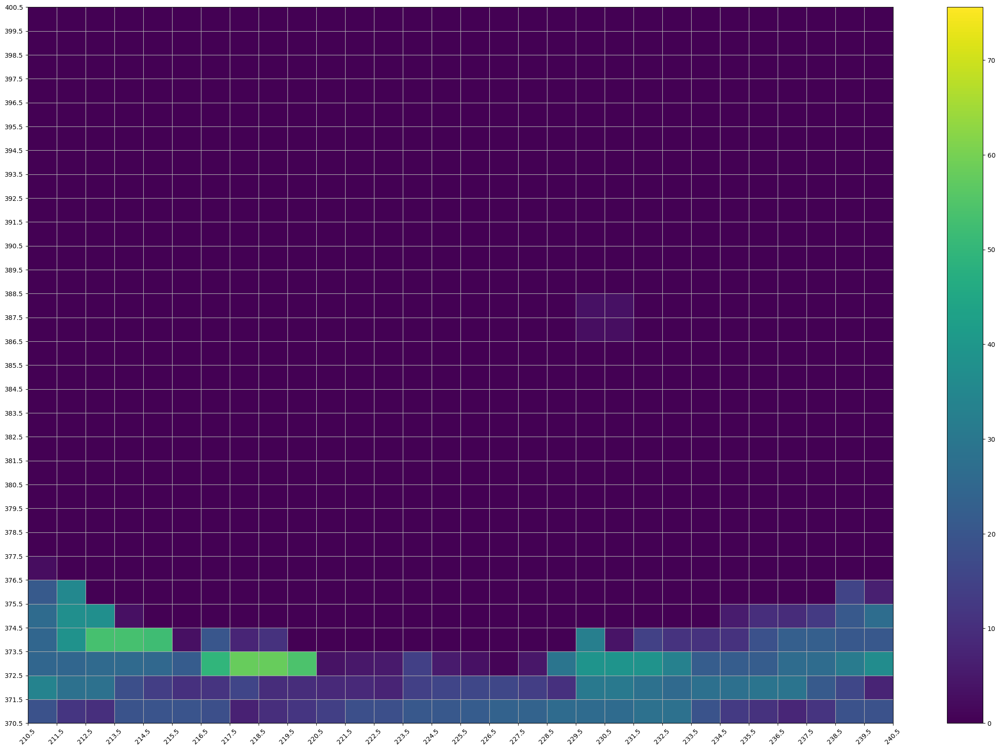

[]


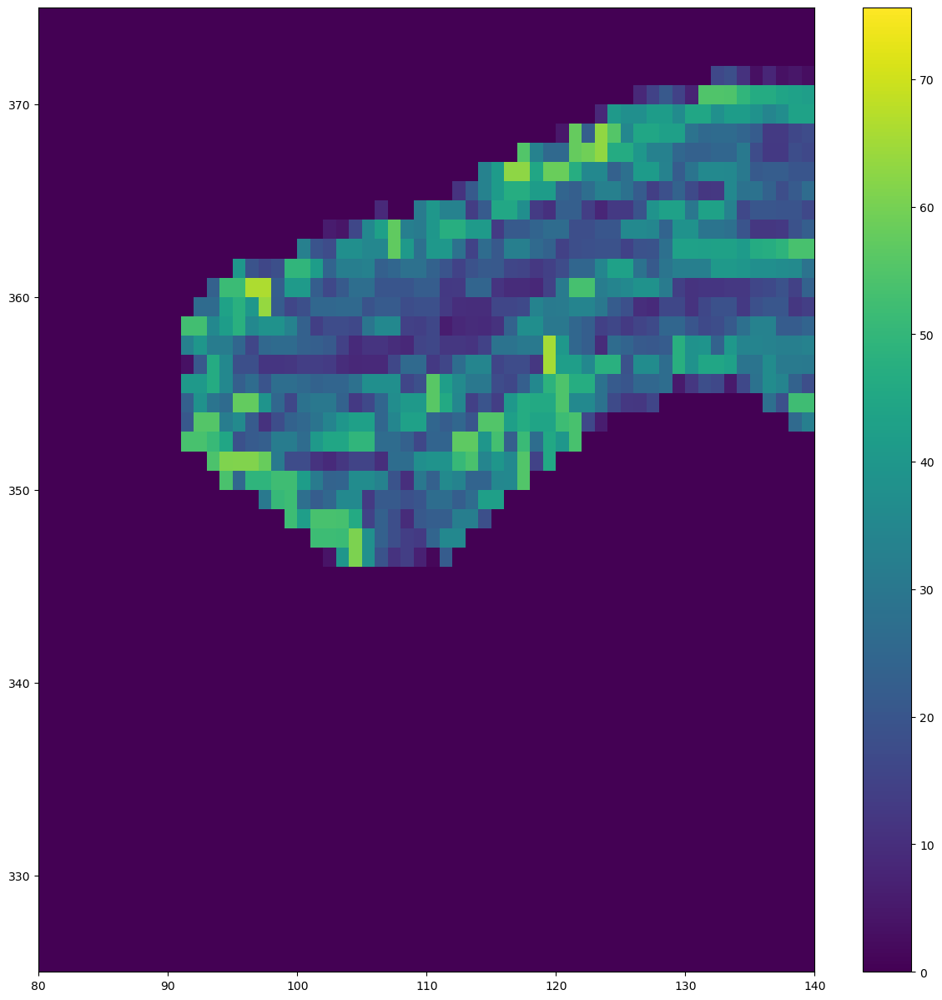

In [44]:
# !!! BEWARE, ALL YE WHO ENTER HERE, THE REALM OF HAND-EDITING SUB-ICE SHELF GEOMETRY. HERE BE DRAGONS. !!!
# ensure that GridAdjustments functions are already loaded.

focusRange=(210,240,370,400)
seeBigPicture=False
searchForValrx1=300
# fig = plt.figure(figsize=(20,10))
# plt.pcolormesh(grd_rx1_post)
# plt.colorbar()
# plt.grid()
# plt.yticks(np.arange(1.5,1000,1),np.arange(1,1000,1))
# plt.xticks(np.arange(1.5,1000,1),np.arange(1,1000,1))
# plt.xlim(focusRange[0],focusRange[1])
# plt.ylim(focusRange[2],focusRange[3])
# plt.show()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh((roms_tmp['bed']+roms_tmp['ice'])*maskNaN,vmax=100)
plt.grid()
plt.yticks(np.arange(1.5,1000,1),np.arange(1,1000,1))
plt.xticks(np.arange(1.5,1000,1),np.arange(1,1000,1),rotation=45)
# plt.plot(np.arange([340,370]),np.ones(np.arange([340,370]).shape)*112)
plt.colorbar()
plt.xlim(focusRange[0],focusRange[1])
plt.ylim(focusRange[2],focusRange[3])
plt.show()


# plt.plot(-roms_tmp['bed'][:,396],'.-')
# plt.plot(roms_tmp['ice'][:,396],'.-')
# plt.plot(-1*roms_tmp['mask'][:,396]*2500,'.-')
# plt.xticks(np.arange(1,1000,2),np.arange(1,1000,2))
# plt.yticks(np.arange(-3500,0,200))
# plt.xlim(220,260)
# plt.grid()
# plt.show()


hhh=roms_tmp['bed'].copy()
zzz=roms_tmp['ice'].copy()
mmm=roms_tmp['mask'].copy()

## an edit to eta_n, xi_n will affect rx1 in the eta_n-2--eta_n-1,xi_n--xi_n+1

## edit cells in far southern grounding line
hhh,zzz=adjustWCT(hhh,zzz,h_alter=200,zice_alter=-200,eta=348,xi=105)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=150,zice_alter=-150,eta=348,xi=104)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-200,zice_alter=200,eta=355,xi=94)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=150,zice_alter=-150,eta=356,xi=92)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=0,zice_alter=-200,eta=351,xi=slice(96,98))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=150,zice_alter=-150,eta=352,xi=94)
mmm=adjustMask(mmm,0,eta=364,xi=108)
mmm=adjustMask(mmm,0,eta=365,xi=111)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=00,eta=347,xi=106)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=00,zice_alter=100,eta=348,xi=106)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=200,zice_alter=-200,eta=347,xi=slice(104,106))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=200,zice_alter=-200,eta=350,xi=97)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=200,eta=360,xi=slice(95,97))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=-100,eta=359,xi=96)
mmm=adjustMask(mmm,0,eta=352,xi=93)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=00,zice_alter=-100,eta=353,xi=93)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=200,zice_alter=-400,eta=351,xi=94)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=-100,eta=slice(351,354),xi=94)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=150,zice_alter=-150,eta=slice(356,358),xi=92)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=200,zice_alter=-200,eta=slice(352,354),xi=92)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=-100,eta=352,xi=92)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=200,zice_alter=-200,eta=slice(351,353),xi=95)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=-100,eta=351,xi=95)


# # remove a long string of very thin very steep border cells (basically cells on the edge of a subglacial mountain side; see above plots of bedrock)
# mmm=adjustMask(mmm,0,eta=347,xi=112)
# mmm=adjustMask(mmm,0,eta=347,xi=111)
# mmm=adjustMask(mmm,0,eta=347,xi=110)
# mmm=adjustMask(mmm,0,eta=347,xi=109)
# # mmm=adjustMask(mmm,0,eta=347,xi=108)
# mmm=adjustMask(mmm,0,eta=347,xi=107)
# mmm=adjustMask(mmm,0,eta=347,xi=106)
# mmm=adjustMask(mmm,0,eta=347,xi=105)
# mmm=adjustMask(mmm,0,eta=347,xi=104)
# mmm=adjustMask(mmm,0,eta=347,xi=103)
# mmm=adjustMask(mmm,0,eta=347,xi=102)
# hhh,zzz=adjustWCT(hhh,zzz,h_alter=500,zice_alter=-500,eta=352,xi=slice(91,94))
# hhh,zzz=adjustWCT(hhh,zzz,h_alter=300,zice_alter=-300,eta=351,xi=slice(94,96))
# mmm=adjustMask(mmm,0,eta=361,xi=slice(95,97))
# mmm=adjustMask(mmm,0,eta=351,xi=94)
# mmm=adjustMask(mmm,0,eta=352,xi=93)
# mmm=adjustMask(mmm,0,eta=slice(351,354),xi=92)
# mmm=adjustMask(mmm,0,eta=350,xi=97)
# mmm=adjustMask(mmm,0,eta=349,xi=99)
# mmm=adjustMask(mmm,0,eta=351,xi=95)
# mmm=adjustMask(mmm,0,eta=slice(358,360),xi=92)
# mmm=adjustMask(mmm,0,eta=360,xi=93)

#both sides of cavity, half way down cavity
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=341,xi=154)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=339,xi=154)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=slice(337,339),xi=153)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=338,xi=152)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=340,xi=152)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=00,zice_alter=-50,eta=339,xi=152)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=slice(330,332),xi=175)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=330,xi=174)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=328,xi=176)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=+100,eta=330,xi=176)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=+50,eta=331,xi=176)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=+50,eta=329,xi=178)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=+50,eta=328,xi=179)
mmm=adjustMask(mmm,0,eta=328,xi=177)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-40,zice_alter=+90,eta=slice(326,329),xi=181)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=50,zice_alter=-50,eta=330,xi=181)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=50,zice_alter=0,eta=329,xi=181)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=0,eta=slice(377,380),xi=181)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=-100,eta=378,xi=181)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=0,zice_alter=-50,eta=377,xi=181)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=90,zice_alter=0,eta=slice(379,381),xi=181)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=0,zice_alter=60,eta=slice(381,383),xi=181)
mmm=adjustMask(mmm,0,eta=326,xi=slice(181,184))
mmm=adjustMask(mmm,0,eta=381,xi=180)
mmm=adjustMask(mmm,0,eta=slice(325,329),xi=slice(183,190))
mmm=adjustMask(mmm,0,eta=slice(327,332),xi=slice(185,190))
mmm=adjustMask(mmm,0,eta=slice(381,383),xi=slice(179,182))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=50,eta=326,xi=195)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-150,zice_alter=150,eta=325,xi=197)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=100,eta=326,xi=197)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=50,eta=327,xi=197)
mmm=adjustMask(mmm,0,eta=slice(326,328),xi=199)
mmm=adjustMask(mmm,0,eta=376,xi=209)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=0,zice_alter=50,eta=slice(376,379),xi=206)
mmm=adjustMask(mmm,0,eta=slice(377,379),xi=205)
mmm=adjustMask(mmm,0,eta=377,xi=206)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=200,eta=323,xi=slice(205,209))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-100,zice_alter=300,eta=324,xi=slice(205,211))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=00,zice_alter=200,eta=325,xi=slice(205,211))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=00,zice_alter=200,eta=326,xi=slice(205,211))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=00,zice_alter=200,eta=327,xi=slice(205,211))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=100,eta=328,xi=slice(205,211))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=100,eta=329,xi=slice(205,211))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=100,eta=330,xi=slice(205,211))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=00,eta=331,xi=slice(205,211))
mmm=adjustMask(mmm,0,eta=323,xi=208)
mmm=adjustMask(mmm,0,eta=323,xi=207)
mmm=adjustMask(mmm,0,eta=325,xi=204)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=50,eta=327,xi=203)
mmm=adjustMask(mmm,0,eta=slice(326,328),xi=204)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=50,zice_alter=-50,eta=327,xi=205)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=75,eta=325,xi=205)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=0,eta=328,xi=205)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=0,zice_alter=50,eta=328,xi=204)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=50,zice_alter=00,eta=slice(325,328),xi=slice(223,227))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-40,zice_alter=40,eta=329,xi=226)
mmm=adjustMask(mmm,0,eta=slice(325,329),xi=slice(224,228))
mmm=adjustMask(mmm,0,eta=slice(376,378),xi=slice(240,244))
mmm=adjustMask(mmm,0,eta=slice(321,324),xi=slice(205,209))
mmm=adjustMask(mmm,0,eta=slice(332,337),xi=slice(162,167))
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=329,roi_row_max=332,roi_col_min=230,roi_col_max=238,if_plotting=0,min_threshold_h=160)
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=325,roi_row_max=330,roi_col_min=179,roi_col_max=185,if_plotting=0,min_threshold_h=120)
mmm=adjustMask(mmm,0,eta=slice(378,380),xi=slice(181,183))
mmm=adjustMask(mmm,0,eta=slice(327,329),xi=slice(202,205))


# tweak water column bordering on weird ear shaped area on western mid shelf.
# smooth the ear region and set a min wct and smooth border with outer cavity
out_smooth = smoothRegion(zzz.copy(),mmm.copy(),0.03,Area,20,roi_row_min=389,roi_row_max=423,roi_col_min=240,roi_col_max=280,if_plotting=0)
hhh = hhh + (zzz - out_smooth)
zzz = out_smooth.copy()
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=389,roi_row_max=423,roi_col_min=240,roi_col_max=280,if_plotting=0,min_threshold_h=100)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=50,zice_alter=00,eta=slice(383,389),xi=260)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=50,eta=389,xi=260)
mmm=adjustMask(mmm,0,eta=slice(387,390),xi=slice(256,261))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=75,zice_alter=-75,eta=388,xi=261)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=0,zice_alter=50,eta=389,xi=261)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=50,eta=389,xi=262)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=100,zice_alter=-50,eta=388,xi=262)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=50,zice_alter=-50,eta=387,xi=262)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=75,zice_alter=-75,eta=slice(387,389),xi=263)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=50,zice_alter=-50,eta=388,xi=264)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=-50,zice_alter=50,eta=389,xi=264)
mmm=adjustMask(mmm,0,eta=407,xi=247)
mmm=adjustMask(mmm,0,eta=slice(408,410),xi=slice(248,251))
mmm=adjustMask(mmm,0,eta=slice(410,412),xi=slice(262,265))
mmm=adjustMask(mmm,0,eta=slice(418,420),xi=slice(262,264))
mmm=adjustMask(mmm,0,eta=slice(417,419),xi=slice(264,266))
mmm=adjustMask(mmm,0,eta=slice(412,416),xi=slice(273,281))
mmm=adjustMask(mmm,0,eta=slice(414,416),xi=slice(271,274))
mmm=adjustMask(mmm,0,eta=411,xi=275)
mmm=adjustMask(mmm,0,eta=410,xi=278)

# tweak deep gl of small glaciers feed between ear and cape darnley
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=395,roi_row_max=401,roi_col_min=285,roi_col_max=295,if_plotting=0,min_threshold_h=140)
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=402,roi_row_max=410,roi_col_min=295,roi_col_max=311,if_plotting=0,min_threshold_h=140)
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=400,roi_row_max=408,roi_col_min=321,roi_col_max=333,if_plotting=0,min_threshold_h=120)
mmm=adjustMask(mmm,0,eta=slice(406,409),xi=slice(322,327))
mmm=adjustMask(mmm,0,eta=405,xi=slice(336,339))
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=403,roi_row_max=411,roi_col_min=335,roi_col_max=355,if_plotting=0,min_threshold_h=90)
mmm=adjustMask(mmm,0,eta=slice(404,407),xi=slice(337,339))

#correct wct beneath small glaciers entering Amery far east coastal sector
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=309,roi_row_max=341,roi_col_min=250,roi_col_max=320,if_plotting=0,min_threshold_h=90)
mmm=adjustMask(mmm,0,eta=slice(333,336),xi=slice(262,266))
mmm=adjustMask(mmm,0,eta=slice(336,338),xi=slice(268,270))
mmm=adjustMask(mmm,0,eta=slice(323,325),xi=262)
mmm=adjustMask(mmm,0,eta=slice(319,321),xi=slice(258,260))
mmm=adjustMask(mmm,0,eta=319,xi=slice(258,268))
mmm=adjustMask(mmm,0,eta=slice(319,321),xi=slice(255,263))
mmm=adjustMask(mmm,0,eta=slice(320,324),xi=slice(255,259))
mmm=adjustMask(mmm,0,eta=slice(316,320),xi=slice(277,283))
mmm=adjustMask(mmm,0,eta=slice(321,325),xi=slice(258,263))
mmm=adjustMask(mmm,0,eta=slice(319,321),xi=slice(260,264))
mmm=adjustMask(mmm,0,eta=322,xi=slice(281,284))

# correct small shelves just to the east of amery
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=271,roi_row_max=304,roi_col_min=310,roi_col_max=336,if_plotting=0,min_threshold_h=160)
mmm=adjustMask(mmm,0,eta=slice(295,299),xi=slice(310,313))
mmm=adjustMask(mmm,0,eta=slice(293,296),xi=slice(310,312))
mmm=adjustMask(mmm,0,eta=slice(296,299),xi=slice(312,318))
mmm=adjustMask(mmm,0,eta=slice(272,278),xi=slice(317,319))
mmm=adjustMask(mmm,0,eta=slice(272,274),xi=slice(323,328))
mmm=adjustMask(mmm,0,eta=slice(294,296),xi=312)
mmm=adjustMask(mmm,0,eta=slice(260,262),xi=slice(352,357))
mmm=adjustMask(mmm,0,eta=273,xi=slice(330,331))

# Fix Sorsdal!
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=235,roi_row_max=240,roi_col_min=389,roi_col_max=400,if_plotting=0,min_threshold_h=160)
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=239,roi_row_max=243,roi_col_min=395,roi_col_max=400,if_plotting=0,min_threshold_h=160)
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=239,roi_row_max=242,roi_col_min=392,roi_col_max=396,if_plotting=0,min_threshold_h=160)

# West ice shelf
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=141,roi_row_max=177,roi_col_min=460,roi_col_max=496,if_plotting=0,min_threshold_h=90)
hhh,zzz=adjustWCT(hhh,zzz,h_alter=30,zice_alter=0,eta=163,xi=slice(465,467))
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=31,roi_row_max=123,roi_col_min=495,roi_col_max=545,if_plotting=0,min_threshold_h=90)
mmm=adjustMask(mmm,0,eta=slice(84,90),xi=slice(505,512))
hhh,zzz=adjustWCT(hhh,zzz,h_alter=30,zice_alter=0,eta=slice(126,128),xi=slice(496,499))
mmm=adjustMask(mmm,0,eta=slice(125,130),xi=slice(496,500))
mmm=adjustMask(mmm,0,eta=slice(294,296),xi=slice(312,316))
mmm=adjustMask(mmm,0,eta=slice(144,153),xi=slice(470,479))
mmm=adjustMask(mmm,0,eta=slice(67,69),xi=slice(512,519))
mmm=adjustMask(mmm,0,eta=slice(99,101),xi=slice(501,504))



# correct tiny shelves to the west of Mawson station
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=689,roi_row_max=720,roi_col_min=280,roi_col_max=325,if_plotting=0,min_threshold_h=120)
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=691,roi_row_max=709,roi_col_min=280,roi_col_max=309,if_plotting=0,min_threshold_h=140)
mmm=adjustMask(mmm,0,eta=703,xi=slice(288,291))
mmm=adjustMask(mmm,0,eta=slice(693,695),xi=slice(285,288))
mmm=adjustMask(mmm,0,eta=slice(661,664),xi=slice(315,320))
mmm=adjustMask(mmm,0,eta=slice(623,635),xi=slice(310,320))

mmm=adjustMask(mmm,0,eta=slice(693,695),xi=slice(287,290))
mmm=adjustMask(mmm,0,eta=slice(660,663),xi=slice(320,325))

mmm=adjustMask(mmm,0,eta=636,xi=316)
mmm=adjustMask(mmm,0,eta=635,xi=slice(314,321))
mmm=adjustMask(mmm,0,eta=626,xi=320)
# hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=591,roi_row_max=596,roi_col_min=331,roi_col_max=337,if_plotting=0,min_threshold_h=120)
hhh = minWCTRegion(zzz.copy(),hhh.copy(),mmm.copy(),roi_row_min=662,roi_row_max=665,roi_col_min=320,roi_col_max=323,if_plotting=0,min_threshold_h=180)
mmm=adjustMask(mmm,0,eta=slice(701,703),xi=slice(289,292))




mmmNaN = mmm.copy().astype('float')
mmmNaN[mmmNaN == 0] = np.NaN

fig = plt.figure(figsize=(20,10))
plt.pcolormesh((hhh+zzz)*mmmNaN,vmax=300)
plt.grid()
plt.yticks(np.arange(1.5,1000,1),np.arange(1,1000,1))
plt.xticks(np.arange(1.5,1000,1),np.arange(1,1000,1),rotation=45)
# plt.plot(np.arange([340,370]),np.ones(np.arange([340,370]).shape)*112)
plt.colorbar()
plt.xlim(focusRange[0],focusRange[1])
plt.ylim(focusRange[2],focusRange[3])
plt.show()

# look along a single xi value
lookAt=397
plt.plot(-hhh[:,lookAt],'.-')
plt.plot(zzz[:,lookAt],'.-')
plt.plot(-1*mmm[:,lookAt]*2500,'.-')
plt.xticks(np.arange(1,1000,2),np.arange(1,1000,2))
plt.yticks(np.arange(-3500,0,200))
plt.xlim(focusRange[2],focusRange[3])
plt.grid()
plt.show()

# look along a single eta value
lookAt=237
plt.plot(-hhh[lookAt,:],'.-')
plt.plot(zzz[lookAt,:],'.-')
plt.plot(-1*mmm[lookAt,:]*2500,'.-')
plt.xticks(np.arange(1,1000,2),np.arange(1,1000,2))
plt.yticks(np.arange(-3500,0,200))
plt.xlim(focusRange[0],focusRange[1])
plt.grid()
plt.show()



z_rho_test,z_w_test,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,hhh,zzz)
grd_rx1_test=GridStiffness.rx1(z_w_test,mmm)
max_vals_vals=grd_rx1_test[grd_rx1_test>searchForValrx1]
max_vals_y,max_vals_x=np.nonzero(grd_rx1_test>searchForValrx1)
print(max_vals_vals.shape)
fig = plt.figure(figsize=(30,20))
plt.pcolormesh(grd_rx1_test)
plt.grid()
plt.plot(max_vals_x,max_vals_y,'ro')

if seeBigPicture==False:
    plt.yticks(np.arange(1,750,1),np.arange(1.5,750,1))
    plt.xticks(np.arange(1,900,1),np.arange(1.5,900,1),rotation=45)
    plt.xlim(focusRange[0],focusRange[1])
    plt.ylim(focusRange[2],focusRange[3])
else:
    plt.yticks(np.arange(1,750,25),np.arange(1,750,25))
    plt.xticks(np.arange(1,900,25),np.arange(1,900,25))
    for x,y,t in zip(max_vals_x,max_vals_y,max_vals_vals):
        plt.text(x,y,str(x)+','+str(y)+','+str(round(t)),ha='left',fontsize=16)
plt.colorbar()
plt.show()


fig = plt.figure(figsize=(15,15))
plt.pcolormesh(grd_rx1_test)
plt.colorbar()
max_vals_y,max_vals_x=np.nonzero(grd_rx1_test>300)
max_vals_vals=grd_rx1_test[grd_rx1_test>300]
plt.plot(max_vals_x,max_vals_y,'ro')
plt.xlim(80,140)
plt.ylim(325,375)
print(max_vals_vals)





  
Minimum r-value =  0.0
Maximum r-value =  0.11997276544570923
Mean    r-value =  0.00624773726775241
Median  r-value =  0.0009146338561549783
  
Minimum r-value =  0.0
Maximum r-value =  75.59622074385433
Mean    r-value =  1.4966654159373787
Median  r-value =  0.2451644280711933


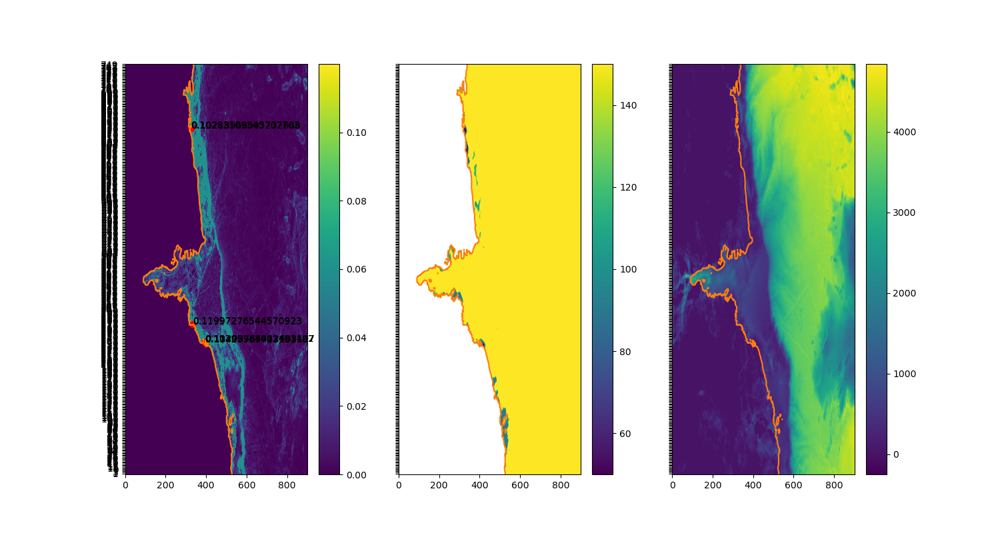

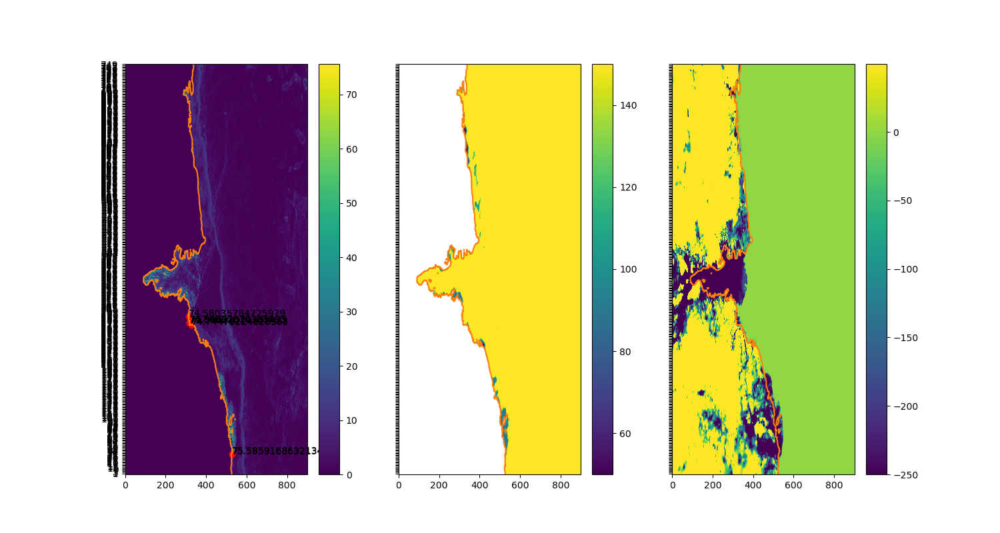

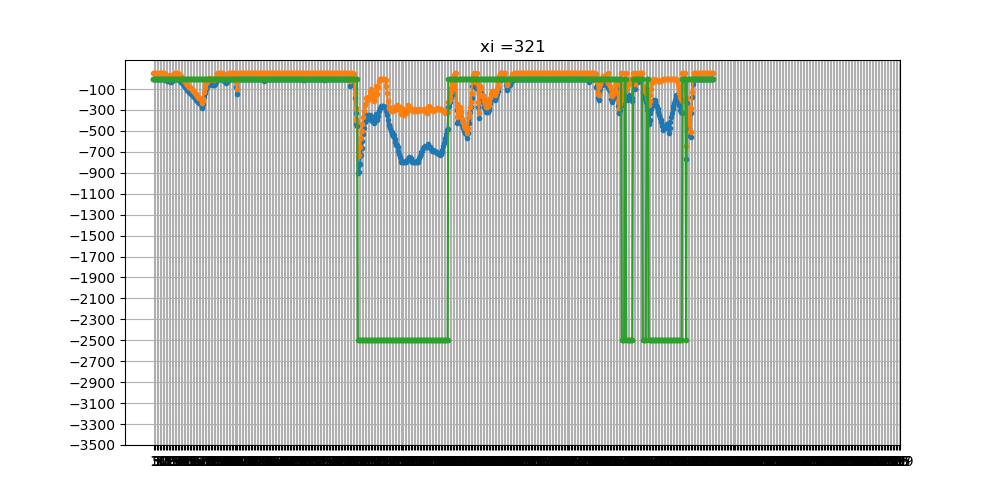

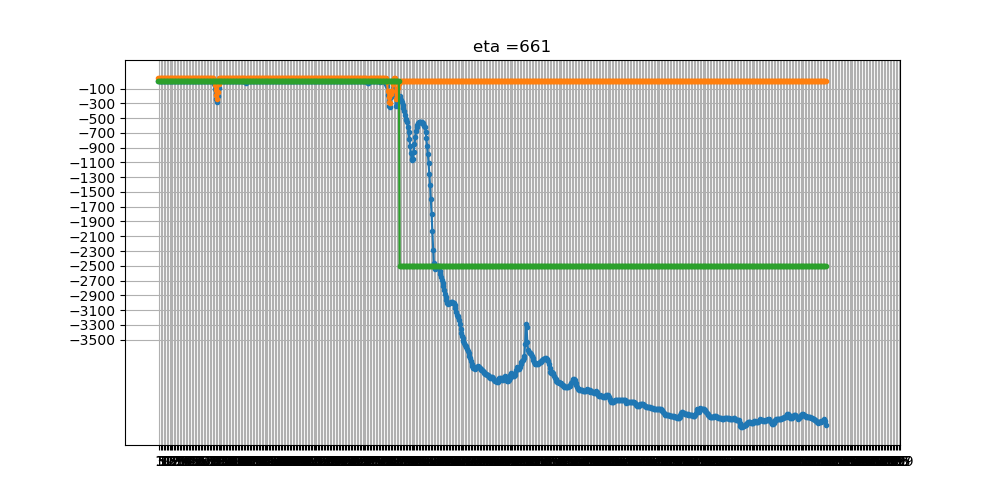

In [45]:

import matplotlib.pyplot as plt
%matplotlib widget

z_rho_post,z_w_post,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,hhh,zzz)
grd_rx0_post=GridStiffness.rx0(hhh,mmm)
grd_rx1_post=GridStiffness.rx1(z_w_post,mmm)

plt.close('all')


fig,axs = plt.subplots(ncols=3,figsize=(15,8),sharex=True,sharey=True)
im=axs[0].pcolormesh(grd_rx0_post)
rx0_flat = grd_rx0_post.ravel()
ind = np.argpartition(rx0_flat,-10)[-10:]
ind
for where in ind: 
    w_j,w_i=np.unravel_index(where,grd_rx0_post.shape)
    axs[0].plot(w_i,w_j,'ro')
    axs[0].text(w_i,w_j,rx0_flat[where])
axs[0].set_yticks(np.arange(1.5,750.5,2),np.arange(1,750,2))
fig.colorbar(im,ax=axs[0])
axs[0].contour(mmm,levels=((0,1)),colors='C1')
im=axs[1].pcolormesh((hhh+zzz)*mmmNaN,vmax=150)
axs[1].set_yticks(np.arange(1.5,750.5,2),np.arange(1,750,2))
fig.colorbar(im,ax=axs[1])
axs[1].contour(mmm,levels=((0,1)),colors='C1')
im=axs[2].pcolormesh(hhh,vmin=-250)
axs[2].set_yticks(np.arange(1.5,750.5,2),np.arange(1,750,2))
fig.colorbar(im,ax=axs[2])
axs[2].contour(mmm,levels=((0,1)),colors='C1')


fig,axs = plt.subplots(ncols=3,figsize=(15,8),sharex=True,sharey=True)
im=axs[0].pcolormesh(grd_rx1_post)
rx1_flat = grd_rx1_post.ravel()
ind = np.argpartition(rx1_flat,-10)[-10:]
ind
for where in ind: 
    w_j,w_i=np.unravel_index(where,grd_rx1_post.shape)
    axs[0].plot(w_i,w_j,'ro')
    axs[0].text(w_i,w_j,rx1_flat[where])
axs[0].set_yticks(np.arange(1.5,750.5,2),np.arange(1,750,2))
fig.colorbar(im,ax=axs[0])
axs[0].contour(mmm,levels=((0,1)),colors='C1')
im=axs[1].pcolormesh((hhh+zzz)*mmmNaN,vmax=150)
axs[1].set_yticks(np.arange(1.5,750.5,2),np.arange(1,750,2))
fig.colorbar(im,ax=axs[1])
axs[1].contour(mmm,levels=((0,1)),colors='C1')
im=axs[2].pcolormesh(zzz,vmin=-250)
axs[2].set_yticks(np.arange(1.5,750.5,2),np.arange(1,750,2))
fig.colorbar(im,ax=axs[2])
axs[2].contour(mmm,levels=((0,1)),colors='C1')


# look along a single xi value
lookAtX=321
fig = plt.figure(figsize=(10,5))
plt.plot(-hhh[:,lookAtX],'.-')
plt.plot(zzz[:,lookAtX],'.-')
plt.plot(-1*mmm[:,lookAtX]*2500,'.-')
plt.xticks(np.arange(1,1000,2),np.arange(1,1000,2))
plt.yticks(np.arange(-3500,0,200))
plt.title('xi ='+str(lookAtX))
# plt.xlim(focusRange[2],focusRange[3])
plt.grid()

# look along a single eta value
lookAtE=661
fig = plt.figure(figsize=(10,5))
plt.plot(-hhh[lookAtE,:],'.-')
plt.plot(zzz[lookAtE,:],'.-')
plt.plot(-1*mmm[lookAtE,:]*2500,'.-')
plt.xticks(np.arange(1,1000,2),np.arange(1,1000,2))
plt.yticks(np.arange(-3500,0,200))
plt.title('eta ='+str(lookAtE))
plt.grid()


# from mpl_toolkits.mplot3d import axes3d
# fig = plt.figure(figsize=(10,5))
# ax = fig.add_subplot(projection='3d')
# # # Grab some test data.
# # X, Y, Z = axes3d.get_test_data(0.05)
# # Plot a basic wireframe.
# X,Y = np.meshgrid(np.arange(1,zzz.shape[1]+1),np.arange(1,zzz.shape[0]+1))
# ax.plot_wireframe(X[lookAtE-20:lookAtE+20,lookAtX-20:lookAtX+20],Y[lookAtE-20:lookAtE+20,lookAtX-20:lookAtX+20],hhh[lookAtE-20:lookAtE+20,lookAtX-20:lookAtX+20], rstride=1, cstride=1)
# ax.plot_wireframe(X[lookAtE-20:lookAtE+20,lookAtX-20:lookAtX+20],Y[lookAtE-20:lookAtE+20,lookAtX-20:lookAtX+20],zzz[lookAtE-20:lookAtE+20,lookAtX-20:lookAtX+20], rstride=1, cstride=1)
# ax.set_xlabel('xi')
# ax.set_ylabel('eta')



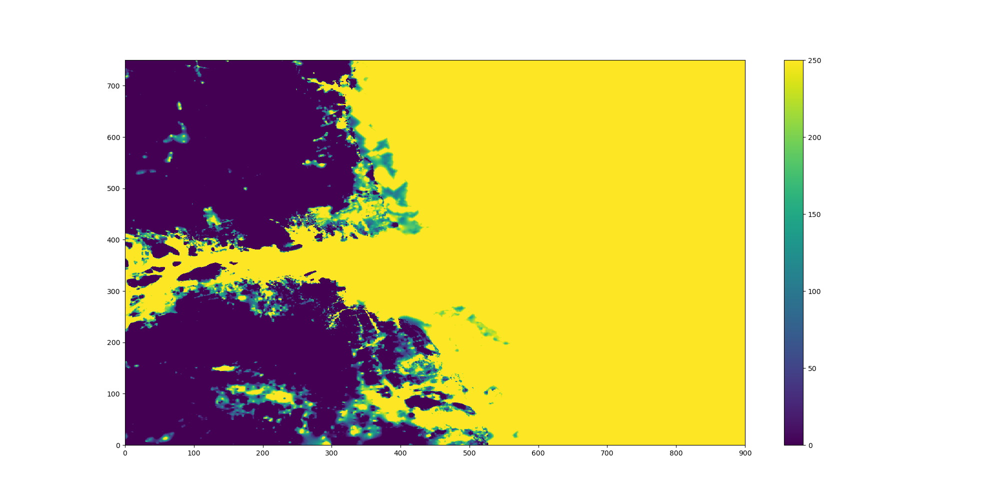

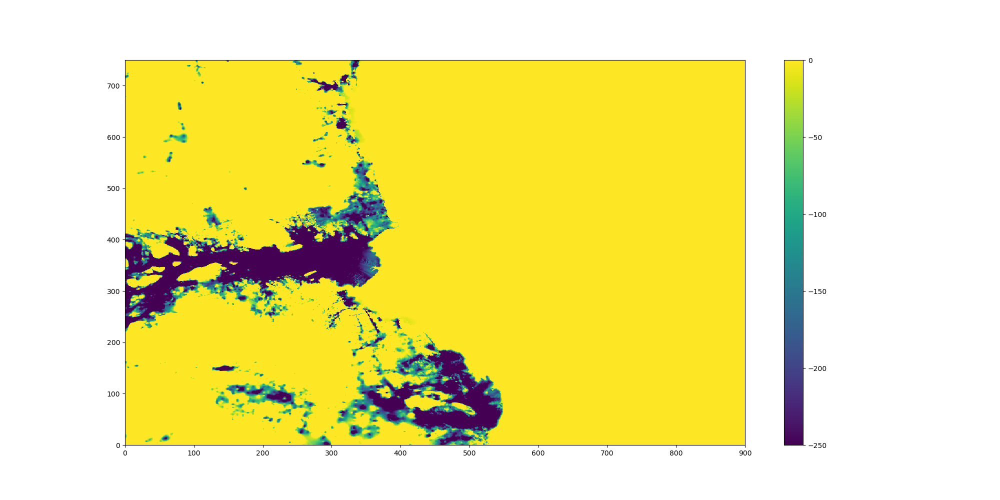

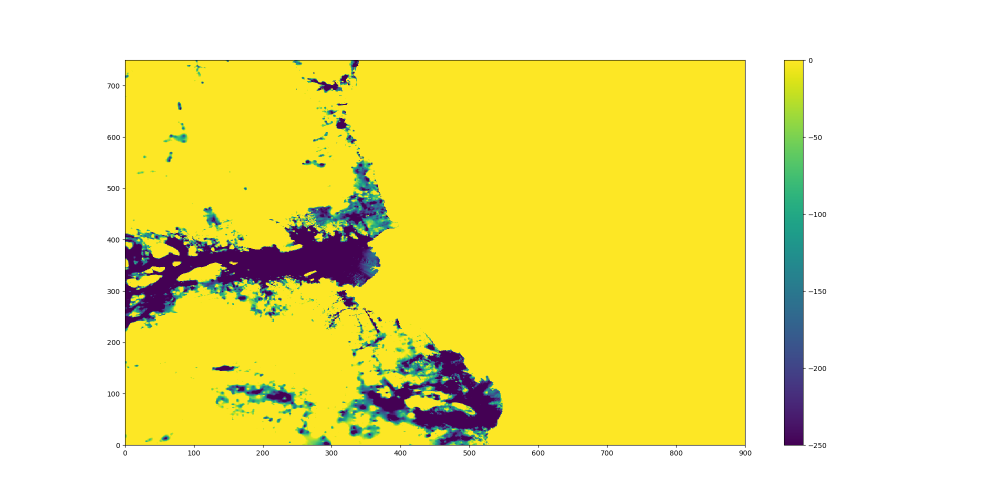

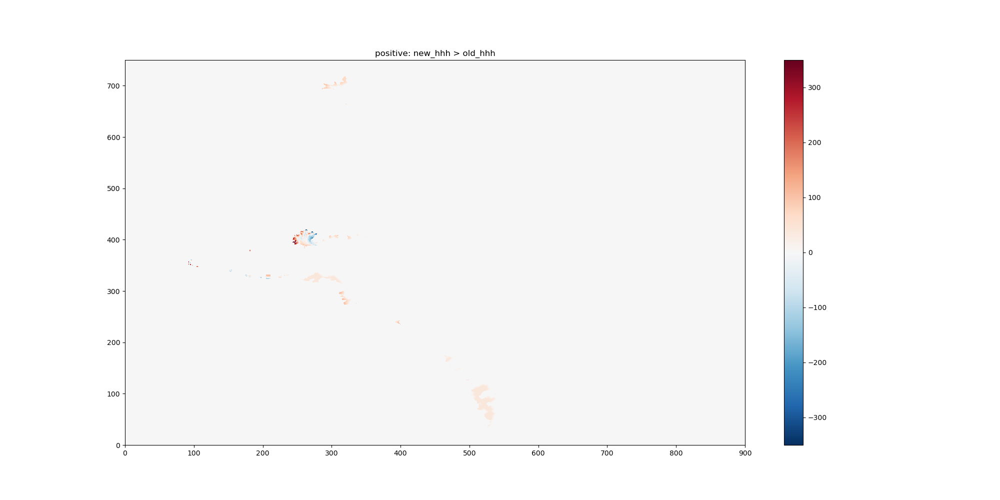

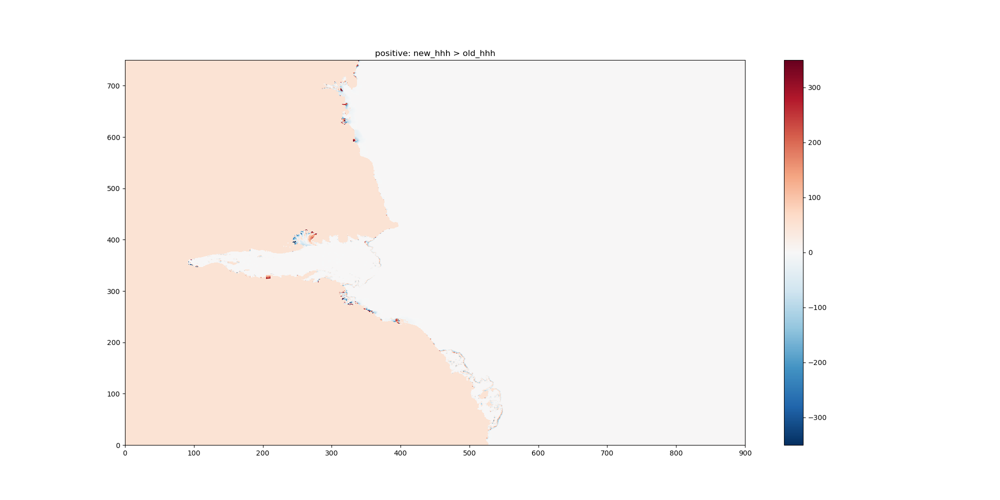

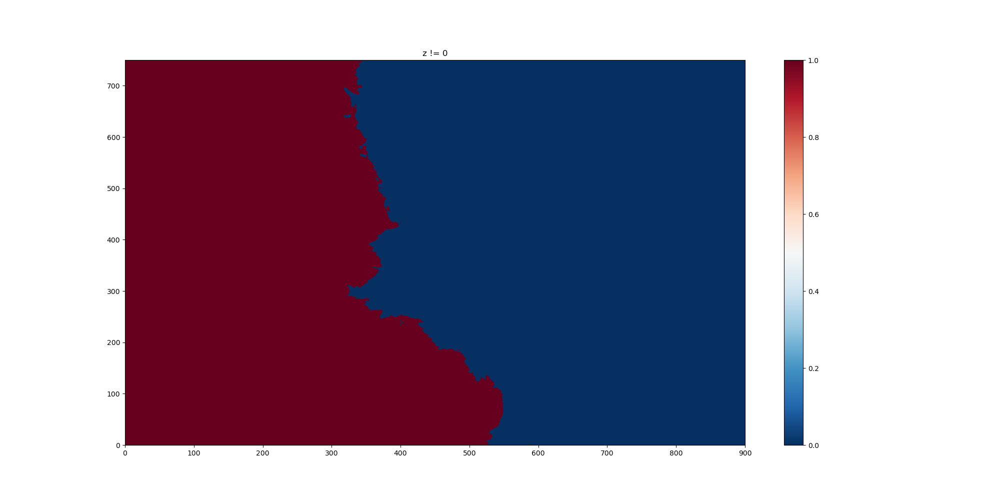

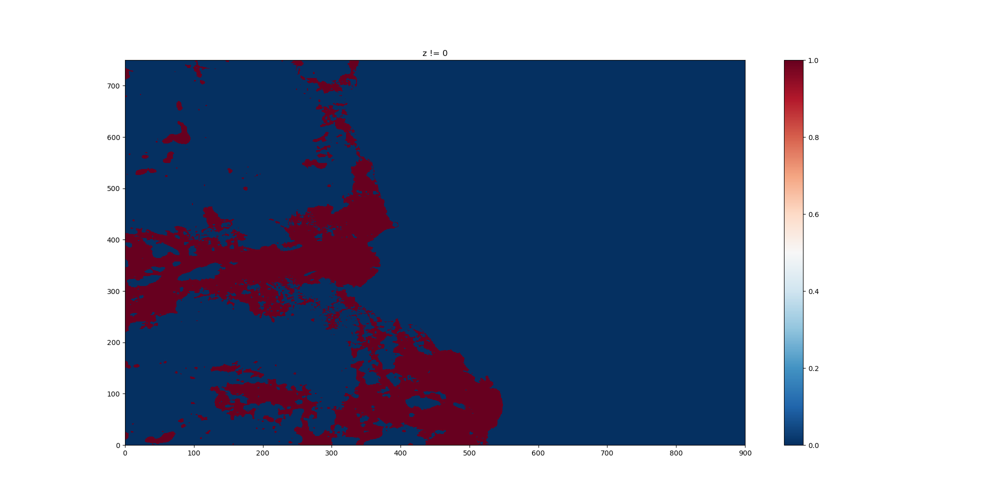

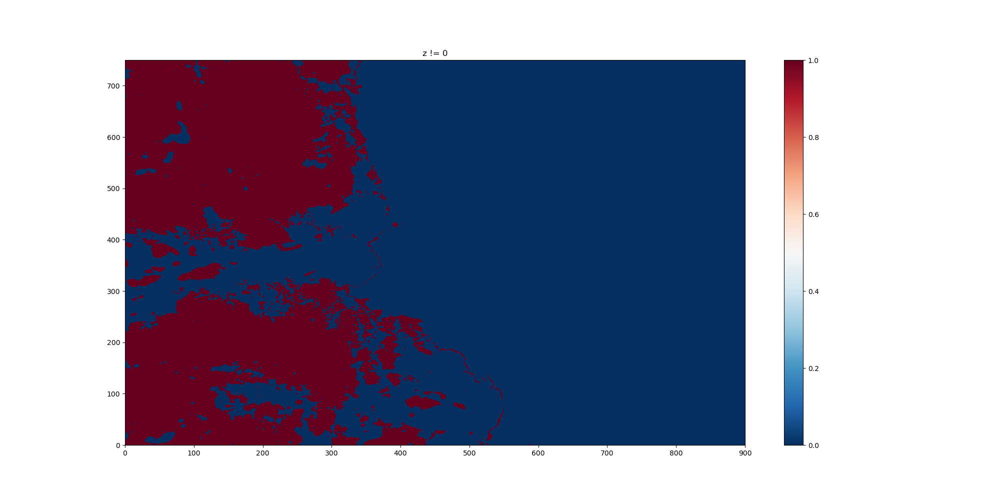

In [46]:
plt.close('all')

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(hhh,vmin=0,vmax=250)
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(zzz,vmin=-250,vmax=0)
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(zzz*(mask_openocean==0),vmin=-250,vmax=0)
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(hhh-roms_tmp['bed'],vmin=-350,vmax=350,cmap='RdBu_r')
plt.title('positive: new_hhh > old_hhh')
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(zzz-roms_tmp['draft'],vmin=-350,vmax=350,cmap='RdBu_r')
plt.title('positive: new_hhh > old_hhh')
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(zzz!=0,cmap='RdBu_r')
plt.title('z != 0')
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh(roms_tmp['draft']!=0,cmap='RdBu_r')
plt.title('z != 0')
plt.colorbar()

fig = plt.figure(figsize=(20,10))
plt.pcolormesh((zzz!=0)*1-(roms_tmp['draft']!=0)*1,cmap='RdBu_r')
plt.title('z != 0')
plt.colorbar()

In [47]:
# Remove single cell water "lakes"


from contextlib import suppress

def compare_neighbors(arr):
# # test example:
# arr = np.array([[False, False, False, False, False, False],
#                 [False, True, False, True, False, False],
#                 [False, False, False, False, True, False],
#                 [True, False, False, True, True, False],
#                 [False, True, True, True, False, False],
#                 [False, True, False, True, False, False],
#                 [False, True, True, True, False, False]])

    comp_arr = np.full(arr.shape, False, dtype=bool)

    for (x, y), item in np.ndenumerate(arr):
        # print(x,y)
        # print(x,y,arr.shape[0],arr.shape[1])
        # print((x<arr.shape[0]) & (y<arr.shape[1]))
        if (x>0) & (y>0) & (x<arr.shape[0]-1) & (y<arr.shape[1]-1):
            # print(x,y)
            if (arr[x-1, y] != item) & (arr[x+1, y] != item) & (arr[x, y+1] != item) & (arr[x, y-1] != item):
                if (arr[x-1, y-1] != item) & (arr[x+1, y-1] != item) & (arr[x-1, y+1] != item) & (arr[x+1, y+1] != item):
                    comp_arr[x, y] = True # Isolated cells are set to True
                if ((arr[x-1, y-1] == item) & (arr[x+1, y-1] != item) & (arr[x-1, y+1] != item) & (arr[x+1, y+1] != item)) |\
                    ((arr[x-1, y-1] != item) & (arr[x+1, y-1] == item) & (arr[x-1, y+1] != item) & (arr[x+1, y+1] != item)) |\
                    ((arr[x-1, y-1] != item) & (arr[x+1, y-1] != item) & (arr[x-1, y+1] == item) & (arr[x+1, y+1] != item)) |\
                    ((arr[x-1, y-1] != item) & (arr[x+1, y-1] != item) & (arr[x-1, y+1] != item) & (arr[x+1, y+1] == item)):
                    comp_arr[x, y] = True # find diagonal single cells
    return comp_arr


islands = compare_neighbors(mmm)

mmm_noSS = mmm.copy()

islandBehaviour = 'keep_islands' #'keep_islands' or 'remove_islands'
if islandBehaviour=='remove_islands':
    mmm_noSS[islands] = np.logical_not(mmm_noSS[islands]) # flip sign on only the islands
elif islandBehaviour=='keep_islands':
    mmm_noSS[islands] = np.full(mmm_noSS[islands].shape,False) # flip sign on only the islands



mmm = mmm_noSS

No such comm: f246a665efda454da3038b189dcb0956


No such comm: f7ef438cb04041899333105621cda073


No such comm: 5913793f83224187b34d21e0059e2b60


No such comm: 26abf6c2c0364091b5a8c070936f790e


  
Minimum r-value =  0.0
Maximum r-value =  0.11997276544570923
Mean    r-value =  0.00624773726775241
Median  r-value =  0.0009146338561549783


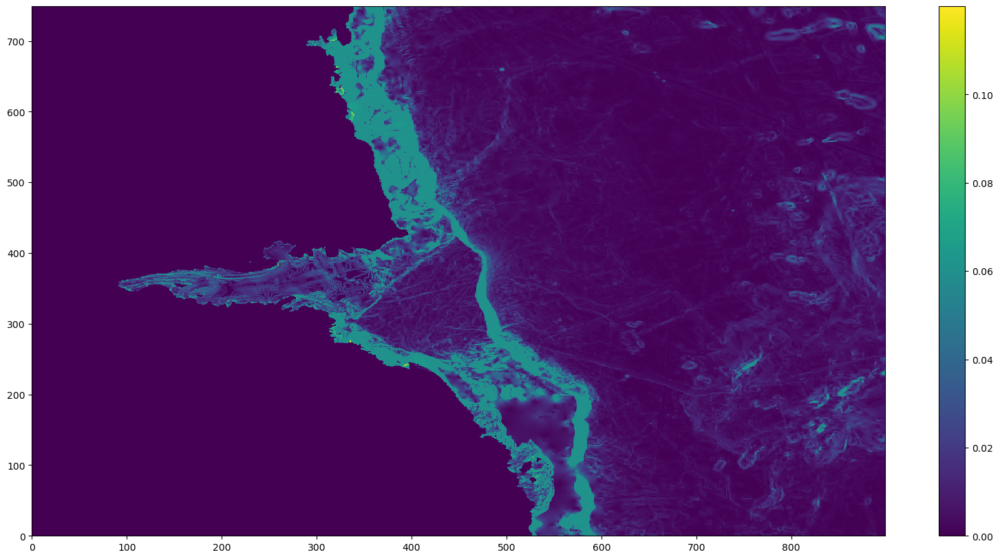

  
Minimum r-value =  0.0
Maximum r-value =  75.59622074385433
Mean    r-value =  1.4966654159373787
Median  r-value =  0.2451644280711933


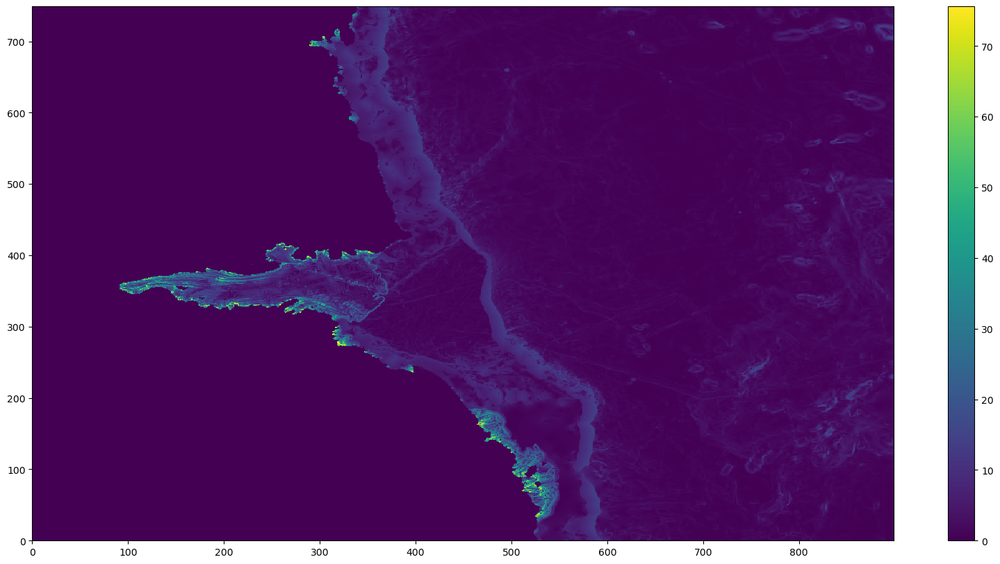

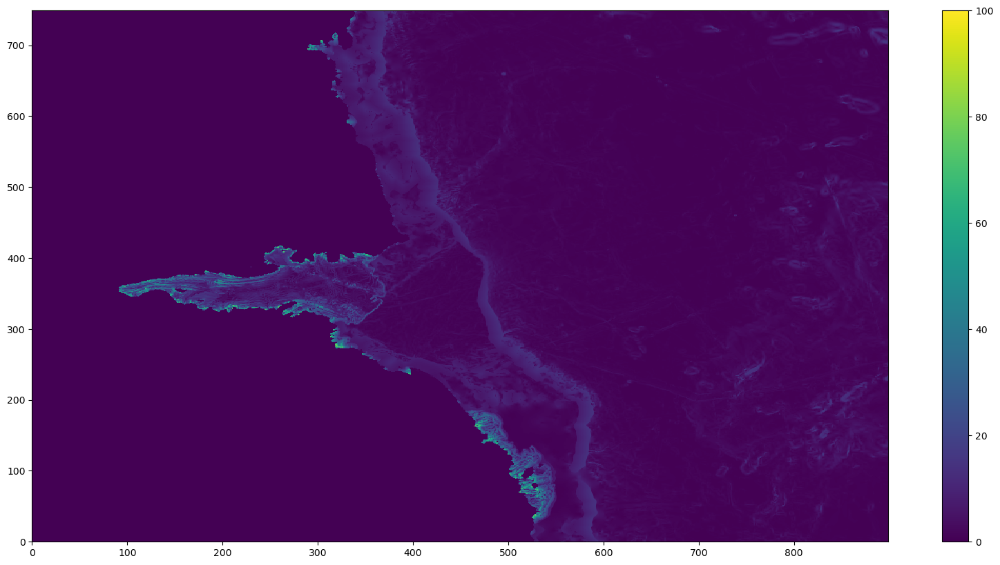

In [48]:
# Now check post-manual editing rx values

%matplotlib inline

z_rho_postManualEdits,z_w_postManualEdits,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,hhh,zzz)
plt.close('all')
fig = plt.figure(figsize=(20,10))
grd_rx0_postManualEdits=GridStiffness.rx0(hhh,mmm)
plt.pcolormesh(grd_rx0_post)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,10))
grd_rx1_postManualEdits=GridStiffness.rx1(z_w_postManualEdits,mmm)
plt.pcolormesh(grd_rx1_post)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,10))
plt.pcolormesh(grd_rx1_postManualEdits,vmin=0,vmax=100)
plt.colorbar()
plt.show()

In [49]:
# interannual_coverage_cutoff = 0.5 # Interannual persistence: at least this fractional% required over 2000-2018 monthly climatology to be considered as ice.
# annual_coverage_cutoff = 0.9 # Annual persistence: at least this fractional % required over the year to be considered as ice

# filelist= glob.glob(data_dir+'/raw/adf_fastice/'+'FastIce*.nc')
# for file in filelist:
#     fi_singlefile = xr.open_dataset(filelist)
#     fi_full = fi_singlefile.drop(['x','y','area','date_alt'])

#     # make the fast ice mask data array
#     fi = (fi_full.Fast_Ice_Time_series==4) | (fi_full.Fast_Ice_Time_series==5) | (fi_full.Fast_Ice_Time_series==6)
    
#     # # check that i'm adding all the required fields
#     # (((fi - fi_full.Fast_Ice_Time_series==4) - fi_full.Fast_Ice_Time_series==5) - fi_full.Fast_Ice_Time_series==6).isel(time=10).plot()


#     fi_clima = fi.groupby('time.month').mean() #make the monthly climatology
#     # # check that the mean is working
#     # (fi.groupby('time.month').mean()>0.5).isel(month=2).plot()
#     # plt.contour((fi.groupby('time.month').mean()).isel(month=2),[0.5],linewidths=0.5,colors='k')
#     # plt.show()
#     # (fi.groupby('time.month').mean()).isel(month=2).plot()
#     # plt.contour((fi.groupby('time.month').mean()).isel(month=2),[0.5],linewidths=0.5,colors='k')


#     fi_mean_interannual = (fi_clima>=interannual_coverage_cutoff).mean(dim='month')

#     fi_mean_annual = fi_mean_interannual>=annual_coverage_cutoff

No such comm: b8a79810af7c41c8afc6cd311614e225


No such comm: 2bdc32dd2b4744c0b8b7fb3a2084d84a


No such comm: 97eb2ffbc9944da2a51a1a6adb4ff662


No such comm: 870ffb09d3304ca3ac26a5ca73367660


No such comm: 4e97d0b8c1f444d69a6ba75c58978ec7


No such comm: 4f6fed7cd73e43f9a4de240dd50aa736


In [50]:
# add fast ice

# fi_fulldata = xr.open_mfdataset(data_dir+'/raw/adf_fastice/'+'*.nc') # load full fast ice data set
fi_fulldata = xr.open_mfdataset(data_dir+'/raw/adf_fastice/'+'FastIce_70_200[0-2].nc',data_vars='different') # load full fast ice data set, don't concat similar datavars (e.g. lon)

fi_full = fi_fulldata.drop(['x','y','area','date_alt'])
# fi_full = fi_full_coordCorrected

fi_full.nbytes/1e9

2.009250544

In [51]:
fi_full

<xarray.Dataset>
Dimensions:               (Y: 4700, X: 5625, time: 68)
Coordinates:
  * time                  (time) datetime64[ns] 2000-03-01 ... 2002-12-12
Dimensions without coordinates: Y, X
Data variables:
    latitude              (Y, X) float32 dask.array<chunksize=(4700, 5625), meta=np.ndarray>
    longitude             (Y, X) float32 dask.array<chunksize=(4700, 5625), meta=np.ndarray>
    Fast_Ice_Time_series  (time, Y, X) int8 dask.array<chunksize=(20, 4700, 5625), meta=np.ndarray>
Attributes:
    title:        Fast ice time series
    institution:  Institute for Marine and Antarctic Studies, University of T...
    source:       MODIS 15-day composite images and automated edge detection
    history:      Version 2.2
    references:   Fraser et al., 2020 (Earth System Science Data, submitted)
    comment:      This is the lat_ts=-70 version of the data - year 2000
    contact:      Alex Fraser (adfraser@utas.edu.au)
    Conventions:  CF-1.7

In [52]:
interannual_coverage_cutoff = 0.5 # Interannual persistence: at least this fractional% required over 2000-2018 monthly climatology to be considered as ice.
annual_coverage_cutoff = 0.9 # Annual persistence: at least this fractional % required over the year to be considered as ice

fi = (fi_full.Fast_Ice_Time_series==4) | (fi_full.Fast_Ice_Time_series==5) | (fi_full.Fast_Ice_Time_series==6) # make the fast ice mask data array
# # check that i'm adding all the required fields
# (((fi - fi_full.Fast_Ice_Time_series==4) - fi_full.Fast_Ice_Time_series==5) - fi_full.Fast_Ice_Time_series==6).isel(time=10).plot()


fi_clima = fi.groupby('time.month').mean() #make the monthly climatology
# # check that the mean is working
# (fi.groupby('time.month').mean()>0.5).isel(month=2).plot()
# plt.contour((fi.groupby('time.month').mean()).isel(month=2),[0.5],linewidths=0.5,colors='k')
# plt.show()
# (fi.groupby('time.month').mean()).isel(month=2).plot()
# plt.contour((fi.groupby('time.month').mean()).isel(month=2),[0.5],linewidths=0.5,colors='k')


fi_mean_interannual = (fi_clima>=interannual_coverage_cutoff).mean(dim='month')

fi_mean_annual = fi_mean_interannual>=annual_coverage_cutoff




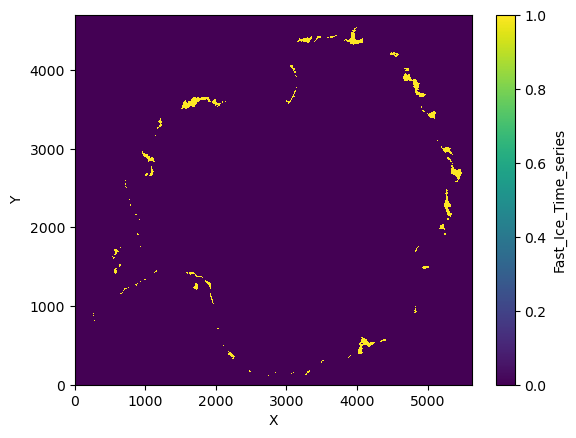

In [53]:
# now map the fast ice data to the model grid
fi_mean_annual.plot()

# interp (nearest) to the model lat/lon

fi_mean_annual_i = griddata((fi_full['longitude'].values.flatten(),fi_full['latitude'].values.flatten()),fi_mean_annual.values.flatten(),(lon_rho,lat_rho),'nearest')


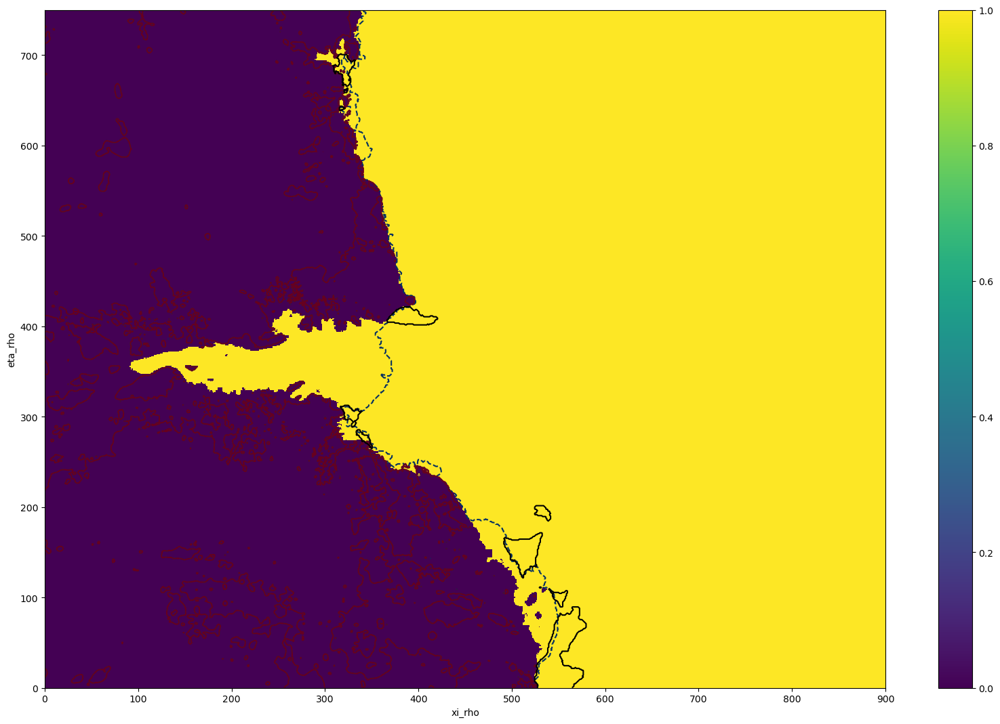

In [54]:

fig = plt.figure(figsize=(20,13))
plt.pcolormesh(mmm)
plt.colorbar()
zice_da = xr.DataArray(zzz,name='zice',dims=['eta_rho','xi_rho'],attrs={'long_name': 'model ice draft at RHO-points', 'units': 'meter'})
zice_da.plot.contour(levels=[0,-1])
# plt.contour(zzz,levels=[-.5])

plt.contour(fi_mean_annual_i,colors='k')

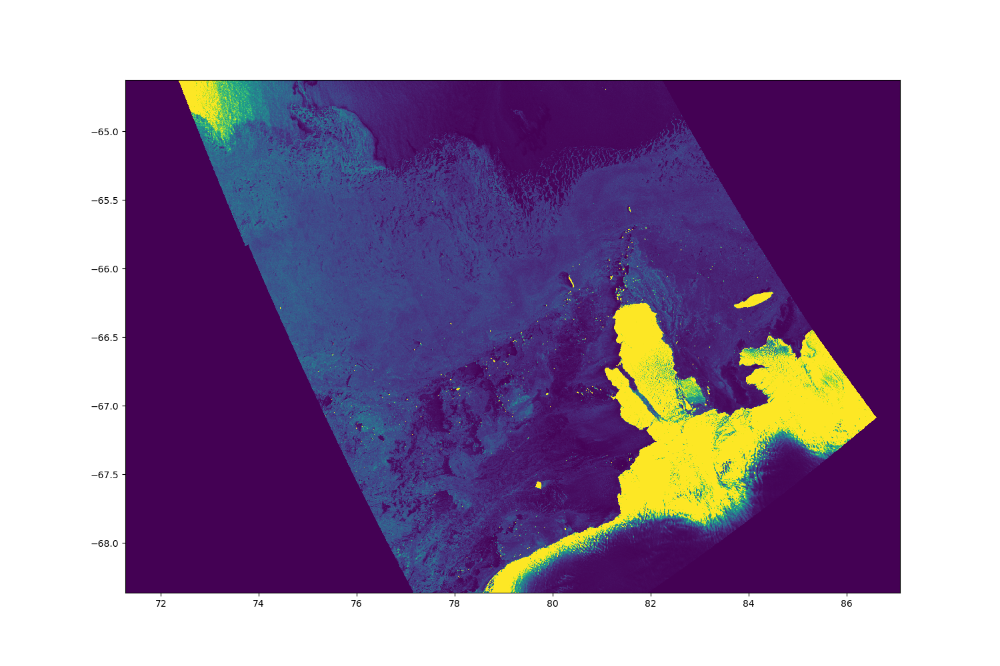

In [55]:
# add icebergs
# download from https://apps.sentinel-hub.com/eo-browser/ (need log in)
# download as a tif, georeferenced, high res, etc, Sentinel-1 AWS-EW-HHHV, HH-linear gamma0 - radiometric terrain, clip extra bands, note the coordinate system. e.g. WGS84 is EPSG:4326 
import rioxarray

S1b = rioxarray.open_rasterio('../data/raw/Sentinel/2023-05-01-00 00_2023-05-01-23 59_Sentinel-1_AWS-EW-HHHV_HH_-_linear_gamma0_-_radiometric_terrain_corrected.tiff')

# import matplotlib
# matplotlib.use('Qt5Agg')
import matplotlib.pyplot as plt
%matplotlib widget
import mplcursors

fig,ax=plt.subplots(figsize=(15,10))
im = ax.pcolormesh(S1b.x,S1b.y,S1b.isel(band=0).values)
cursor = mplcursors.cursor(im, hover=True)




In [56]:
# %matplotlib inline

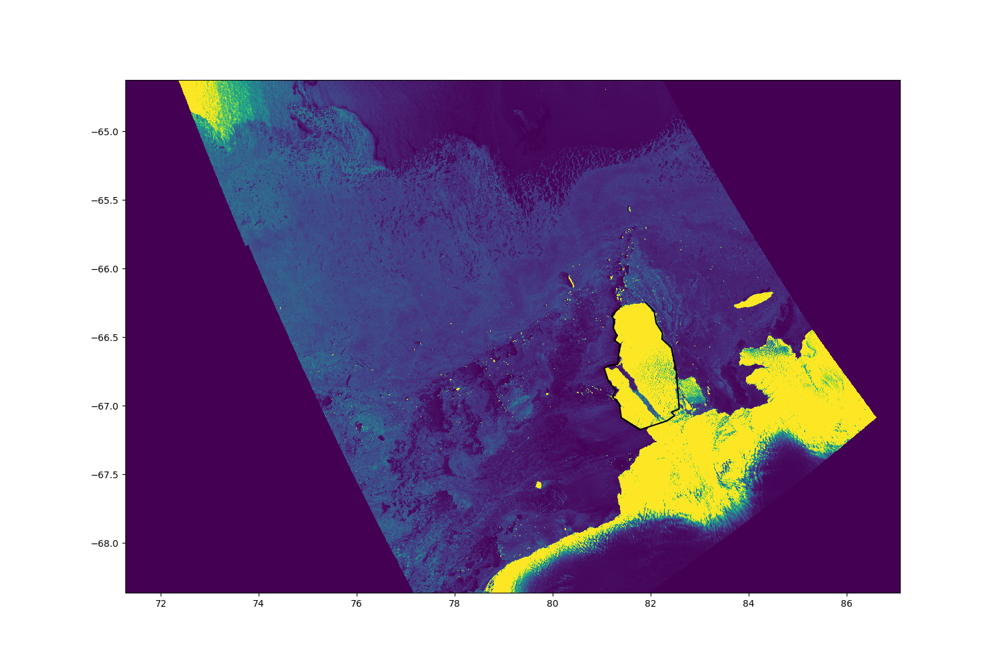

In [57]:
#define outline of icebergs (manually until vscode/jupyter can use plt.ginput())

d12=np.array([
[81.89,-66.246],
[82.07,-66.309],
[82.11,-66.396],
[82.24,-66.469],
[82.23,-66.513],
[82.42,-66.576],
[82.52,-66.746],
[82.56,-66.906],
[82.58,-67.023],
[82.42,-67.047],
[82.49,-67.071],
# [82.19,-67.091],
[82.33,-67.11],
[81.79,-67.173],
[81.45,-67.100],
[81.79,-67.178],
[81.40,-67.086],
[81.36,-66.989],
[81.22,-66.935],
[81.29,-66.887],
[81.14,-66.824],
[81.05,-66.726],
[81.14,-66.707],
[81.32,-66.697],
[81.35,-66.615],
[81.37,-66.552],
[81.26,-66.522],
[81.30,-66.484],
[81.24,-66.435],
[81.25,-66.372],
[81.20,-66.343],
[81.40,-66.270 ]
])


def inpolygon(xq, yq, xv, yv):
    from matplotlib import path
    shape = xq.shape
    xq = xq.reshape(-1)
    yq = yq.reshape(-1)
    xv = xv.reshape(-1)
    yv = yv.reshape(-1)
    q = [(xq[i], yq[i]) for i in range(xq.shape[0])]
    p = path.Path([(xv[i], yv[i]) for i in range(xv.shape[0])])
    return p.contains_points(q).reshape(shape)


mask_icebergs = inpolygon(lon_rho, lat_rho,d12[:,0], d12[:,1])



fig,ax=plt.subplots(figsize=(15,10))
im = ax.pcolormesh(S1b.x,S1b.y,S1b.isel(band=0).values)
plt.plot(d12[:,0],d12[:,1],'k')

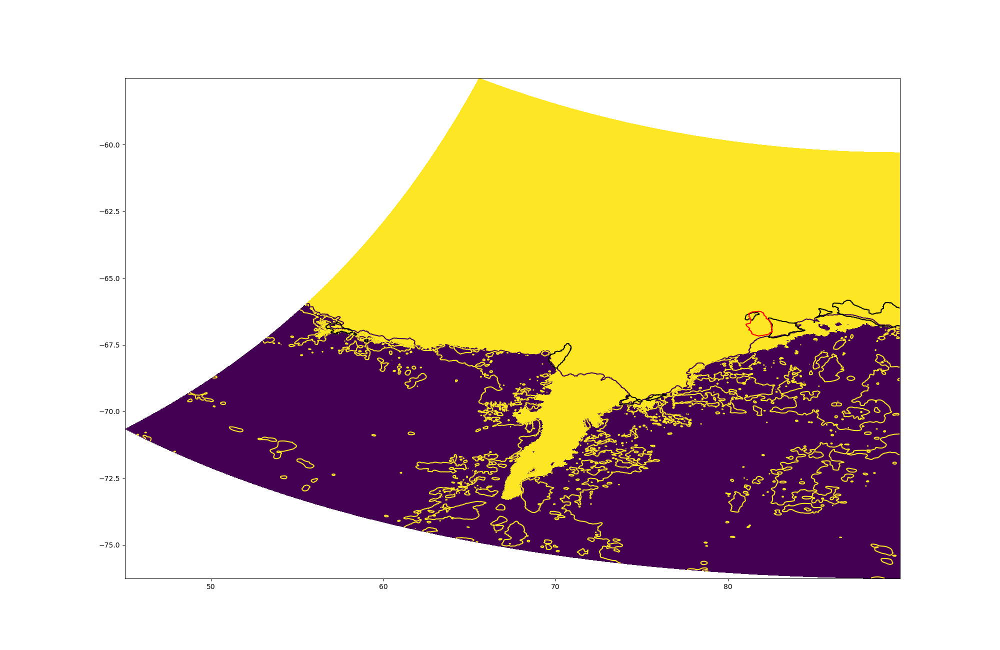

In [58]:

fig = plt.figure(figsize=(20,13))
plt.pcolormesh(lon_rho,lat_rho,mmm)
plt.contour(lon_rho,lat_rho,zzz,levels=np.array((-1,0)))

plt.contour(lon_rho,lat_rho,fi_mean_annual_i,colors='k')
plt.contour(lon_rho,lat_rho,mask_icebergs,colors='r')

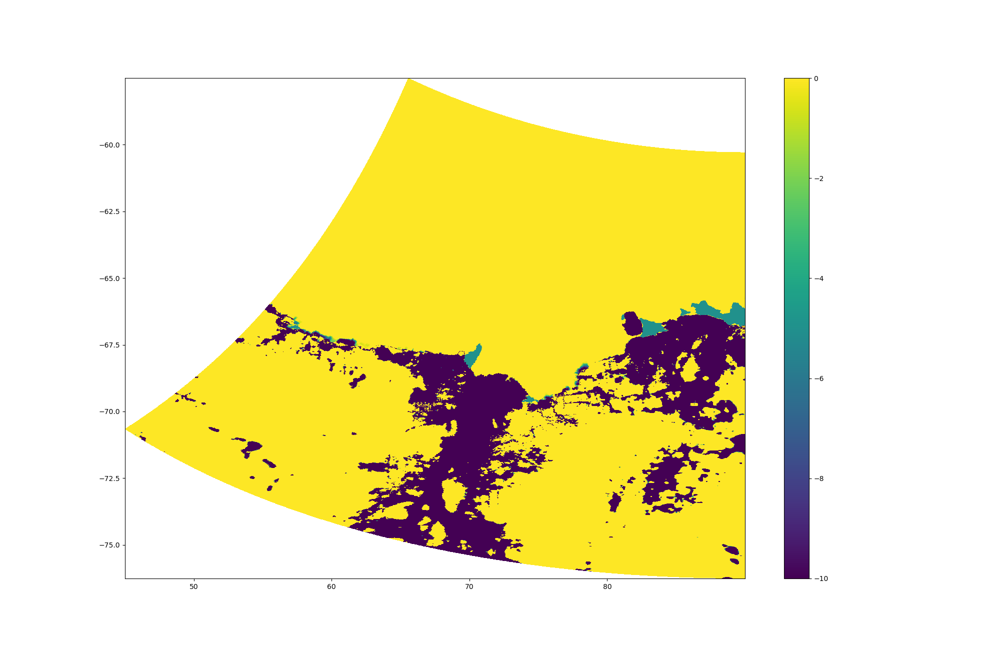

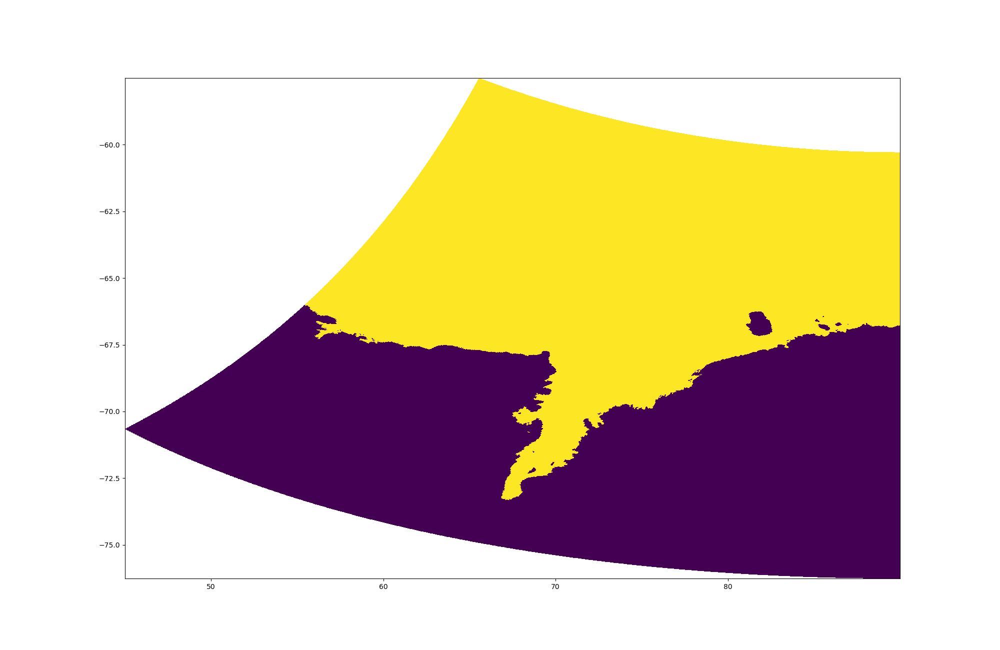

In [59]:
# for fast ice alter the zice.
fastice_draft = -5 #m below surface, negative downwards
zzz_test = zzz.copy()
mmm_test = mmm.copy()
zzz_test[(fi_mean_annual_i==1) & (zzz==0) & (mmm==1)] = fastice_draft

# for icebergs, assume fully grounded.
hhh_test = hhh.copy()
zzz_test[mask_icebergs==1] = min_depth-hhh_test[mask_icebergs] # set ice to be min depth above bathy,
mmm_test[mask_icebergs==1] = 0                                  # and remove from water, i.e. grounded.



fig = plt.figure(figsize=(20,13))
plt.pcolormesh(lon_rho,lat_rho,zzz_test,vmin=-10,vmax=0)
plt.colorbar()
plt.show()
fig = plt.figure(figsize=(20,13))
plt.pcolormesh(lon_rho,lat_rho,mmm_test)
plt.show()

In [60]:
# update with new fastice and iceberg geometry

zzz = zzz_test.copy()
mmm = mmm_test.copy()
hhh = hhh_test.copy()

  
Minimum r-value =  0.0
Maximum r-value =  0.11997276544570923
Mean    r-value =  0.0062266490993237306
Median  r-value =  0.0008983477600850165
  
Minimum r-value =  0.0
Maximum r-value =  75.59622074385433
Mean    r-value =  1.4941491423406665
Median  r-value =  0.2411331388167431


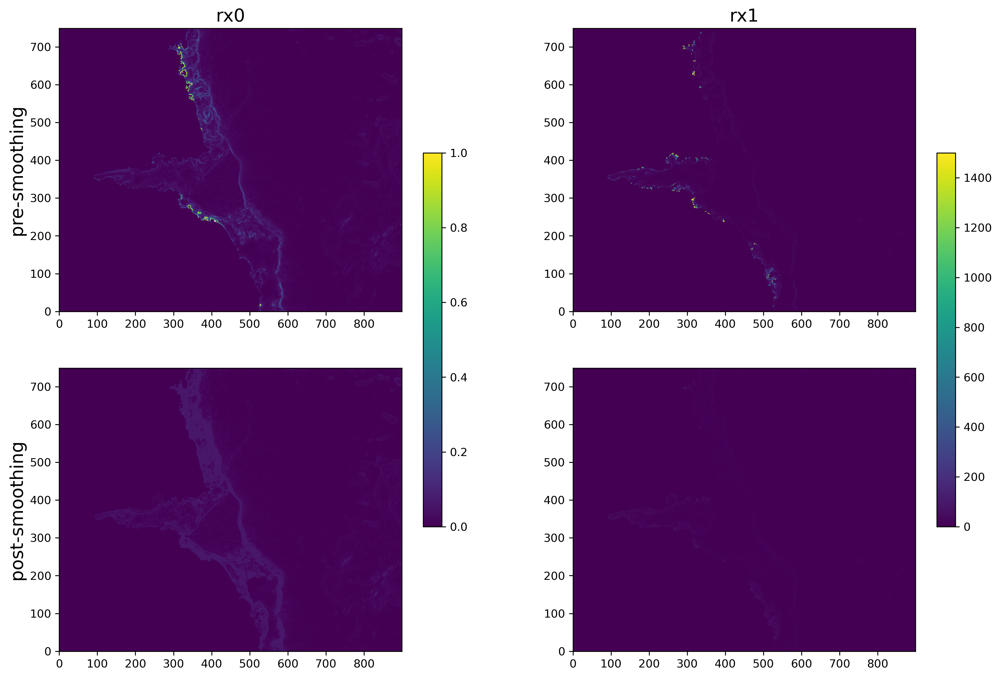

In [61]:
%matplotlib inline


z_rho_postManualEdits,z_w_postManualEdits,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,hhh,zzz)
grd_rx0_postManualEdits=GridStiffness.rx0(hhh,mmm)
grd_rx1_postManualEdits=GridStiffness.rx1(z_w_postManualEdits,mmm)


plt.close('all')
fig,axs = plt.subplots(2,2,figsize=[15,10],dpi=300)

ax = axs[0,0]
ax.pcolormesh(grd_rx0_pre,vmax=1)
ax.set_title('rx0',fontsize=16)
ax.set_ylabel('pre-smoothing',fontsize=16)
ax = axs[0,1]
grd_rx1_pre[np.isnan(grd_rx1_pre)]=0
ax.pcolormesh(grd_rx1_pre,vmax=1500)
ax.set_title('rx1',fontsize=16)
ax = axs[1,0]
im=ax.pcolormesh(grd_rx0_postManualEdits,vmax=1)
plt.colorbar(im,ax=axs[:,0],shrink=0.6)
ax.set_ylabel('post-smoothing',fontsize=16)
ax = axs[1,1]
im=ax.pcolormesh(grd_rx1_postManualEdits,vmax=1500)
plt.colorbar(im,ax=axs[:,1],shrink=0.6)

plt.savefig('../out/pre_post_rxVals.png')

In [62]:
# calculate final rx0 and rx1 values, check that you're happy before overwriting these
z_rho_final,z_w_final,=GridStiffness.calc_z(Vtransform,Vstretching,theta_s,theta_b,Tcline,hc,N,hhh,zzz)
grd_rx0_final=GridStiffness.rx0(hhh,mmm)

grd_rx1_final=GridStiffness.rx1(z_w_final,mmm)

maskNaN = mmm.copy().astype('float')
maskNaN[maskNaN == 0] = np.NaN

print('whole domain')
print('min/max zice is',zzz.min(),'/',zzz.max())
print('min/max h is',hhh.min(),'/',hhh.max())
print('min/max wct is',(hhh+zzz).min(),'/',(hhh+zzz).max())
print('ocean cells')
print('min/max zice is',np.nanmin(zzz*maskNaN),'/',np.nanmax(zzz*maskNaN))
print('min/max h is',np.nanmin(hhh*maskNaN),'/',np.nanmax(hhh*maskNaN))
print('min/max wct is',np.nanmin((hhh+zzz)*maskNaN),'/',np.nanmax((hhh+zzz)*maskNaN))


  
Minimum r-value =  0.0
Maximum r-value =  0.11997276544570923
Mean    r-value =  0.0062266490993237306
Median  r-value =  0.0008983477600850165
  
Minimum r-value =  0.0
Maximum r-value =  75.59622074385433
Mean    r-value =  1.4941491423406665
Median  r-value =  0.2411331388167431
whole domain
min/max zice is -3749.7085 / 49.7
min/max h is 0.3 / 4838.785
min/max wct is 49.999985 / 4838.785
ocean cells
min/max zice is -2415.740966796875 / 0.0
min/max h is 50.0 / 4838.78515625
min/max wct is 49.99998474121094 / 4838.78515625


No such comm: b04cf60af5e5462c8923cf2b2cc72de9


  
Minimum r-value =  0.0
Maximum r-value =  0.11997276544570923
Mean    r-value =  0.0062266490993237306
Median  r-value =  0.0008983477600850165
  
Minimum r-value =  0.0
Maximum r-value =  75.59622074385433
Mean    r-value =  1.4941491423406665
Median  r-value =  0.2411331388167431
whole domain
min/max zice is -3749.7085 / 49.7
min/max h is 0.3 / 4838.785
min/max wct is 49.999985 / 4838.785
ocean cells
min/max zice is -2415.740966796875 / 0.0
min/max h is 50.0 / 4838.78515625
min/max wct is 49.99998474121094 / 4838.78515625


In [63]:
# Make final versions
hhh_final = hhh.copy()
zzz_final = zzz.copy()
mmm_final = mmm.copy()

# now re-check that min_depth is obeyed for all ocean points
ii = ((hhh_final + zzz_final) < min_depth) & (mmm == 1)
hhh_final[ii] = -zzz_final[ii] + min_depth

# do the same for all non-ocean points
ii = ((hhh_final + zzz_final) < min_depth) & (mmm == 0)
zzz_final[ii] = min_depth-hhh_final[ii] # for those locations, the depth needs to be min_depth above the bathy

# remove any zice that is >0.
zzz_final_backup = zzz_final.copy()

anyPosZice=np.any(zzz_final>0)

if anyPosZice:
    new_ice = zzz_final.copy()
    new_ice[(zzz_final>0)]=0
    zzz_final=new_ice.copy()

In [64]:
maskNaN = mmm.copy().astype('float')
maskNaN[maskNaN == 0] = np.NaN

print('whole domain')
print('min/max zice is',zzz_final.min(),'/',zzz_final.max())
print('min/max h is',hhh_final.min(),'/',hhh_final.max())
print('min/max wct is',(hhh_final+zzz_final).min(),'/',(hhh_final+zzz_final).max())
print('ocean cells')
print('min/max zice is',np.nanmin(zzz_final*maskNaN),'/',np.nanmax(zzz_final*maskNaN))
print('min/max h is',np.nanmin(hhh_final*maskNaN),'/',np.nanmax(hhh_final*maskNaN))
print('min/max wct is',np.nanmin((hhh_final+zzz_final)*maskNaN),'/',np.nanmax((hhh_final+zzz_final)*maskNaN))

whole domain
min/max zice is -3749.7085 / 0.0
min/max h is 0.3 / 4838.785
min/max wct is 0.3 / 4838.785
ocean cells
min/max zice is -2415.740966796875 / 0.0
min/max h is 50.0 / 4838.78515625
min/max wct is 49.99998474121094 / 4838.78515625


In [65]:
# if this is set as 'True', then overwrite the bed, ice and mask with updated values.

handAdjustments=True
if handAdjustments:
    print('updating bathy, zice and mask')
    roms_tmp['bed_backup'] = roms_tmp['bed'].copy()
    roms_tmp['ice_backup'] = roms_tmp['ice'].copy()
    roms_tmp['mask_backup'] = roms_tmp['mask'].copy()
    roms_tmp['bed']=hhh_final.copy()
    roms_tmp['ice']=zzz_final.copy()
    roms_tmp['mask']=mmm_final.copy()
    
    bed = hhh_final.copy()
    ice = zzz_final.copy()
    mask = mmm_final.copy()


updating bathy, zice and mask


In [66]:
# do checks

maskNaN = mask.copy().astype('float')
maskNaN[maskNaN == 0] = np.NaN

print('whole domain')
print('min/max zice is',ice.min(),'/',ice.max())
print('min/max h is',bed.min(),'/',bed.max())
print('min/max wct is',(bed+ice).min(),'/',(bed+ice).max())
print('ocean cells')
print('min/max zice is',np.nanmin(ice*maskNaN),'/',np.nanmax(ice*maskNaN))
print('min/max h is',np.nanmin(bed*maskNaN),'/',np.nanmax(bed*maskNaN))
print('min/max wct is',np.nanmin((bed+ice)*maskNaN),'/',np.nanmax((bed+ice)*maskNaN))

whole domain
min/max zice is -3749.7085 / 0.0
min/max h is 0.3 / 4838.785
min/max wct is 0.3 / 4838.785
ocean cells
min/max zice is -2415.740966796875 / 0.0
min/max h is 50.0 / 4838.78515625
min/max wct is 49.99998474121094 / 4838.78515625


In [67]:
mask = mask.astype(float)
mindxy = min(np.hstack((1/pm.flatten(),1/pn.flatten())))
maskNaN = mask.copy()
maskNaN[mask==0]=np.nan
CFL = mindxy/abs(np.sqrt(9.81*wct))*maskNaN

print('max fast DT in s following CFL with ROMS requiring a 0.85 tolerance: ', 0.85*np.nanmin(CFL))
print('max slow DT in s following CFL: ', 0.85*np.nanmin(mindxy/8*maskNaN)) # approx max 8m/s baroclinic wave speed
print('Set ROMS timestep settings of at least: \n','DT <',0.85*np.nanmin(mindxy/8*maskNaN),'s \n NDTFAST >',(np.nanmin(mindxy/8*maskNaN)/(0.85*np.nanmin(CFL))).round())
timescale = 12*60*60 #s
print('approximate viscosity settings for smoothing timescale of ',timescale/(60*60),' hrs')
print('visc2 for 2dx noise ~ ',(2*mindxy/(2*np.pi))**2 / timescale)
print('approximate diff settings are an order of magnitude lower:')
print('tnu2 ~ ',((2*mindxy/(2*np.pi))**2 / timescale/10))



max fast DT in s following CFL with ROMS requiring a 0.85 tolerance:  7.370753288269043
max slow DT in s following CFL:  200.73567672459654
Set ROMS timestep settings of at least: 
 DT < 200.73567672459654 s 
 NDTFAST > 32.0
approximate viscosity settings for smoothing timescale of  12.0  hrs
visc2 for 2dx noise ~  8.37158638959344
approximate diff settings are an order of magnitude lower:
tnu2 ~  0.8371586389593441


In [68]:
# switch coordinates so that the grid is oriented as:
# increasing xi direction towards ~east
# increasing eta direction towards ~north


In [69]:
#set spherical flag to 1, since we're creating a curvilinear spherical grid
spherical_da = xr.DataArray('"T"',name='spherical',attrs={'flag_meanings': 'Cartesian spherical',
 'flag_values': np.array(['"F"', '"T"'], dtype=str),
 'long_name': 'grid type logical switch'})

xl = mr*np.size(lat_rho,1)*1000
xl_da = xr.DataArray(xl,name='xl',attrs={'long_name': 'basin length in the XI-direction', 'units': 'meter'} )
el = mr*np.size(lon_rho,0)*1000
el_da = xr.DataArray(el,name='el',attrs={'long_name': 'basin length in the ETA-direction', 'units': 'meter'} )

angle = lon_rho/180.0*np.pi
angle_da = xr.DataArray(angle,name='angle',dims=['eta_rho','xi_rho'],attrs={'long_name': 'angle between XI-axis and EAST', 'units': 'radians'})

pn_da = xr.DataArray(pn,name="pn",dims=['eta_rho','xi_rho'],attrs={'long_name': 'curvilinear coordinate metric in ETA', 'units': 'meter-1'})
pm_da = xr.DataArray(pm,name='pm',dims=['eta_rho','xi_rho'],attrs={'long_name': 'curvilinear coordinate metric in XI', 'units': 'meter-1'})

dmde_da = xr.DataArray(dmde,name='dmde',dims=['eta_rho','xi_rho'],attrs={'long_name': 'ETA-derivative of inverse metric factor pm', 'units': 'meter'})
dndx_da = xr.DataArray(dndx,name='dndx',dims=['eta_rho','xi_rho'],attrs={'long_name': 'XI-derivative of inverse metric factor nm', 'units': 'meter'})

f = 2*7.29e-5*np.sin(lat_rho*np.pi/180)
f_da = xr.DataArray(f,name='f',dims=['eta_rho','xi_rho'],attrs={'long_name': 'Coriolis parameter at RHO-points', 'units': 'second-1'})

h_da = xr.DataArray(bed,name='h',dims=['eta_rho','xi_rho'],attrs={'long_name': 'model bathymetry at RHO-points', 'units': 'meter'})
# hraw_da = xr.DataArray(bed_raw.astype(float),name='hraw',dims=['eta_rho','xi_rho'],attrs={'long_name': 'Working unmasked bathymetry at RHO-points', 'units': 'meter'})

zice_da = xr.DataArray(ice,name='zice',dims=['eta_rho','xi_rho'],attrs={'long_name': 'model ice draft at RHO-points', 'units': 'meter'})
# zice_raw_da = xr.DataArray(ice_raw.astype(float),name='zice',dims=['eta_rho','xi_rho'],attrs={'long_name': 'raw unmasked model ice draft at RHO-points', 'units': 'meter'})

lon_rho_da = xr.DataArray(lon_rho,name='lon_rho',dims=['eta_rho','xi_rho'],attrs={'long_name': 'longitude of RHO-points',
 'standard_name': 'longitude',
 'units': 'degree_east'})
lat_rho_da = xr.DataArray(lat_rho,name='lat_rho',dims=['eta_rho','xi_rho'],attrs={'long_name': 'latitude of RHO-points',
 'standard_name': 'latitude',
 'units': 'degree_north'})
lon_psi_da = xr.DataArray(lon_psi,name='lon_psi',dims=['eta_psi','xi_psi'],attrs={'long_name': 'longitude of psi-points',
 'standard_name': 'longitude',
 'units': 'degree_east'})
lat_psi_da = xr.DataArray(lat_psi,name='lat_psi',dims=['eta_psi','xi_psi'],attrs={'long_name': 'latitude of psi-points',
 'standard_name': 'latitude',
 'units': 'degree_north'})
lon_u_da = xr.DataArray(lon_u,name='lon_u',dims=['eta_u','xi_u'],attrs={'long_name': 'longitude of u-points',
 'standard_name': 'longitude',
 'units': 'degree_east'})
lat_u_da = xr.DataArray(lat_u,name='lat_u',dims=['eta_u','xi_u'],attrs={'long_name': 'latitude of u-points',
 'standard_name': 'latitude',
 'units': 'degree_north'})
lon_v_da = xr.DataArray(lon_v,name='lon_v',dims=['eta_v','xi_v'],attrs={'long_name': 'longitude of v-points',
 'standard_name': 'longitude',
 'units': 'degree_east'})
lat_v_da = xr.DataArray(lat_v,name='lat_v',dims=['eta_v','xi_v'],attrs={'long_name': 'latitude of v-points',
 'standard_name': 'latitude',
 'units': 'degree_north'})


mask_u,mask_v,mask_psi = uvp_masks(mask)

mask_rho_da = xr.DataArray(mask,name='mask_rho',dims=['eta_rho','xi_rho'],attrs={'flag_meanings': 'land water',
 'flag_values': np.array([ 0.,  1.]),
 'long_name': 'mask on RHO-points'})
mask_psi_da = xr.DataArray(mask_psi,name='mask_psi',dims=['eta_psi','xi_psi'],attrs={'flag_meanings': 'land water',
 'flag_values': np.array([ 0.,  1.]),
 'long_name': 'mask on psi-points'})
mask_u_da = xr.DataArray(mask_u,name='mask_u',dims=['eta_u','xi_u'],attrs={'flag_meanings': 'land water',
 'flag_values': np.array([ 0.,  1.]),
 'long_name': 'mask on u-points'})
mask_v_da = xr.DataArray(mask_v,name='mask_v',dims=['eta_v','xi_v'],attrs={'flag_meanings': 'land water',
 'flag_values': np.array([ 0.,  1.]),
 'long_name': 'mask on v-points'})

grd = xr.Dataset({'spherical':spherical_da,
                'xl':xl_da,
                'el':el_da,
                'angle':angle_da,
                'pm':pn_da,
                'pn':pn_da,
                'dndx':dndx_da,
                'dmde':dmde_da,
                'f':f_da,
                'h':h_da,
              #   'hraw':hraw_da,
                'zice':zice_da,
              #   'zice_raw':zice_raw_da,
                'lon_rho':lon_rho_da,
                'lat_rho':lat_rho_da,
                'lon_psi':lon_psi_da,
                'lat_psi':lat_psi_da,
                'lon_u':lon_u_da,
                'lat_u':lat_u_da,
                'lon_v':lon_v_da,
                'lat_v':lat_v_da,
                'mask_rho':mask_rho_da,
                'mask_psi':mask_psi_da,
                'mask_u':mask_u_da,
                'mask_v':mask_v_da,},
               attrs={'history': 'GRID file using make_grid.py,'+str(datetime.date.today()),
                      'type': 'ROMS grid file'})

In [70]:
print('saving to',out_path)
grd.to_netcdf(out_path,unlimited_dims='bath')

saving to /home/woden/Documents/amery-hires-setup/data/proc/amery_v2km_v10_grd.nc
